In [1]:
import requests
import numpy as np
import pandas as pd
from datetime import datetime, timedelta
import time
import matplotlib.pyplot as plt
import logging
import arcticdb as adb
from arcticdb import LibraryOptions
from arcticdb.exceptions import NoSuchVersionException
from sklearn.metrics import mean_squared_error
from pycaret.regression import setup, create_model, predict_model, compare_models, plot_model, get_config
from pycaret.classification import setup as setup_class, compare_models as compare_models_class, compare_models as compare_models_class, predict_model as predict_model_class, plot_model as plot_model_class
logging.basicConfig(level = logging.INFO, format='%(asctime)s - %(levelname)s - %(message)s')

In [2]:
option = LibraryOptions(dynamic_schema=True)
# dynmaic schema settings, the default is always set to the fixed schema

In [3]:
ac = adb.Arctic('lmdb://F:/Python?map_size=10GB')

In [4]:
### Create and Get Libraries
try:
    currency_feature_lib = ac.create_library('currency_feature_data', library_options=option)   
    trade_lib = ac.create_library('L-S_data', library_options=option)
except:
    pass
# Creating dynamic libraries to store currency features and trade tracking data.
# If the library already exists, creating duplicates upon rerunning the code could be problematic.
# Using try-except blocks can help manage this issue effectively.

currency_lib = ac.get_library('currency_data', create_if_missing=True)
currency_feature_lib = ac.get_library('currency_feature_data',create_if_missing=True)
exogenous_lib = ac.get_library('exogenous_data', create_if_missing=True)
regression_lib = ac.get_library('agg_base_data', create_if_missing=True)
classification_lib = ac.get_library('class_base_data', create_if_missing=True)
trade_lib = ac.get_library('L-S_data', create_if_missing=True)

In [5]:
ac.list_libraries()

['L-S_data',
 'agg_base_data',
 'currency_data',
 'exogenous_data',
 'class_base_data',
 'currency_feature_data']

In [20]:
def clear_library(library, library_name):
    try:
        symbols = library.list_symbols()  # Get all symbols in the library
        for symbol in symbols:
            library.delete(symbol)  # Delete each symbol
            logging.info(f"Deleted symbol {symbol} from library {library_name}")
        logging.info(f"All data cleared from library {library_name}")
    except Exception as e: #Exception: building-in python class that catches most errors
        logging.error(f"Failed to clear library {library_name}: {e}")

library_names = { #Dictiornary holding exist libraries corresponding library name
    'currency_data': currency_lib,
    'currency_feature_data':currency_feature_lib,
    'exogenous_data': exogenous_lib,
    'agg_base_data': regression_lib,
    'class_base_data': classification_lib,
    'L-S_data': trade_lib
}

# Clear data from each library and pass the names explicitly
for name, lib in library_names.items():
    clear_library(lib, name) #returns a dictionary's ky-value tuple pairs

# This function clears all data related to symbols stored in the library from the last run,
# ensuring the library is empty before beginning data collection.

2024-04-29 17:42:43,715 - INFO - Deleted symbol EUR/CAD from library currency_data
2024-04-29 17:42:46,135 - INFO - Deleted symbol GBP/USD from library currency_data
2024-04-29 17:42:55,758 - INFO - Deleted symbol EUR/USD from library currency_data
2024-04-29 17:42:58,170 - INFO - Deleted symbol GBP/EUR from library currency_data
2024-04-29 17:43:00,743 - INFO - Deleted symbol EUR/CHF from library currency_data
2024-04-29 17:43:03,243 - INFO - Deleted symbol USD/CHF from library currency_data
2024-04-29 17:43:05,847 - INFO - Deleted symbol USD/CAD from library currency_data
2024-04-29 17:43:08,333 - INFO - Deleted symbol GBP/CHF from library currency_data
2024-04-29 17:43:10,783 - INFO - Deleted symbol GBP/CAD from library currency_data
2024-04-29 17:43:13,220 - INFO - Deleted symbol BTC/USD from library currency_data
2024-04-29 17:43:13,221 - INFO - All data cleared from library currency_data
2024-04-29 17:43:13,458 - INFO - Deleted symbol EUR/CAD from library currency_feature_data
20

In [21]:
def verify_clearance(library, library_name):
    if not library.list_symbols():
        logging.info(f"Verification successful: No symbols found in {library_name}.")
    else:
        logging.error(f"Verification failed: Symbols still present in {library_name}.")

for name, lib in library_names.items():
    verify_clearance(lib, name)

# Verify that each library is cleared and is ready for data collections

2024-04-29 17:43:16,011 - INFO - Verification successful: No symbols found in currency_data.
2024-04-29 17:43:16,012 - INFO - Verification successful: No symbols found in currency_feature_data.
2024-04-29 17:43:16,012 - INFO - Verification successful: No symbols found in exogenous_data.
2024-04-29 17:43:16,013 - INFO - Verification successful: No symbols found in agg_base_data.
2024-04-29 17:43:16,014 - INFO - Verification successful: No symbols found in class_base_data.
2024-04-29 17:43:16,014 - INFO - Verification successful: No symbols found in L-S_data.


In [58]:
base_cps = ['EUR/USD', 'GBP/CHF', 'USD/CAD']
class_cps = ['EUR/CHF', 'EUR/CAD', 'GBP/EUR', 'GBP/USD', 'GBP/CAD', 'USD/CHF', 'USD/JPY']
exogenous = ['BTC/USD','EUR/USD']
Trade_cps = ['GBP/USD', 'USD/JPY']

In [23]:
API_KEY = "beBybSi8daPgsTp5yx5cHtHpYcrjp5Jq"

In [24]:
#Fetch data with protection function to prevent the connection error 
def fetch_data(pair, retries=10, delay=2): 
    #10 is the number of time the function should retry fetching data if attempt fials
    #2 is the time in seocnds to wait between retries  
    url = f'https://api.polygon.io/v1/last_quote/currencies/{pair}?apiKey={API_KEY}'
    for attempt in range(retries): #loop that will execute up to the number of times specified in retires
        try:
            response = requests.get(url)#send an HTTP GET request to the constructed URL and store the response
            if response.status_code == 200:#200 is an HTTP status code, meaning request was successful
                data = response.json()#parse the JSON data from the response and store it to the readable dataframe
                logging.info(f'Retrieved {pair}: {data}')
                return data
            else:
                logging.error(f'Error retrieving data: HTTP {response.status_code}')
        except requests.exceptions.ConnectionError as e:#catch expections specifically related to connection issues
            logging.error(f'Connection error ({e}), retrying in {delay} seconds...')
            time.sleep(delay)
        except Exception as e:#catches other errors 
            logging.error(f'An unexpected error occurred: {e}')
    logging.error('Failed to retrieve data after several attempts')
    return None #if retires exceed 10 times, there will be no output returns

In [26]:
#Fetch specifially exogenous data, here infers to BTC/USD, which using a different url string
def fetch_data_exo(pair, retries=10, delay=2):
    url = f'https://api.polygon.io/v1/last/crypto/{pair}?apiKey={API_KEY}'
    for attempt in range(retries):
        try:
            response = requests.get(url)
            if response.status_code == 200:
                data = response.json()
                logging.info(f'Retrieved {pair}: {data}')
                return data
            else:
                logging.error(f'Error retrieving data: HTTP {response.status_code}')
        except requests.exceptions.ConnectionError as e:
            logging.error(f'Connection error ({e}), retrying in {delay} seconds...')
            time.sleep(delay)
        except Exception as e:
            logging.error(f'An unexpected error occurred: {e}')
    logging.error('Failed to retrieve data after several attempts')
    return None

In [27]:
#Store fetched data into arcticdb
def store_data(pair, rate, timestamp):
    try:
        rate = float(rate)#Convert rate to the float to ensure the consistency of data type stored in rate column 
        #sometimes, the rate can be an integer, which will cause inconsitency of data type and error message for storing
        df = pd.DataFrame({
            'pair_name': [pair], # Store the pair name
            'rate': [rate]
        }, index=[pd.Timestamp(timestamp)])# Use the timestamp as the index, to take the advantage of Arcticdb that tailered to handle time series data
        # Note: Arcticdb supports only reading, writing, and appending operations on dataframe data.
        currency_lib.append(pair, df) #lib.append is the articdb function to add new data without rewirting the entire dataset
        logging.info(f"Stored {pair} rate at {timestamp}: {rate}")
    except Exception as e:
        logging.error(f"Failed to store data for {pair} at {timestamp}: {e}, Rate: {rate}")

In [28]:
# Aggregate data function to compute features at the portfolio level.
def aggregate_data(pairs, start_time, end_time):
    combined_df = pd.DataFrame()
    for pair in pairs:      
        data = currency_feature_lib.read(pair, date_range=(start_time, end_time)).data
        #read currency feature data from a lib stored all features of base cps within a specific time
        combined_df = pd.concat([combined_df, data], axis=0)
        #since ArcticDB stores data by key symbols, we need to use pd.concat
        #to merge all base CPS data into one integrated dataset.
        #axis 0 indicates the concatenation should occur along the row axis

    aggregated_df = combined_df.groupby(combined_df.index).agg({
    'mean': 'mean',
    'vol': 'mean',
    'fd': 'mean',
    'max': 'mean',
    'min': 'mean',
    'correlation_with_BTC/USD': 'mean',
    'correlation_with_EUR/USD': 'mean'
    })
    # Group by timestamp index and aggregate each feature by their means.
    return aggregated_df

In [29]:
def insert_aggregated_data_to_regression_lib(aggregated_df):
    symbol_name = "aggregated_base_cps"
    regression_lib.write(symbol_name, aggregated_df) #lib.write, initilize a dataset and overwrite the whole dataset into the lib
    logging.info(f"Inserted aggregated data into regression library")

# The data in the regression library is intended for running regression analysis before classification.

In [30]:
def class_base_data(pairs, start_time, end_time):
    combined_df = pd.DataFrame()
    for pair in pairs:      
        data = classification_lib.read(pair, date_range=(start_time, end_time)).data
        combined_df = pd.concat([combined_df, data], axis=0)        
    
    return combined_df
#Similar functionailty and structured of code to the aggregat_data block
#Combined dataframe is used to train the classification

2024-04-29 17:43:21,457 - INFO - Retrieved EUR/USD: {'last': {'ask': 1.0724, 'bid': 1.0721, 'exchange': 48, 'timestamp': 1714426999000}, 'request_id': '6cf7baae6bfc0646bfedd24eabcdbff1', 'status': 'success', 'symbol': 'EUR/USD'}
2024-04-29 17:43:21,635 - INFO - Stored EUR/USD rate at 2024-04-29 17:43:21.459352: 1.07225
2024-04-29 17:43:21,866 - INFO - Retrieved GBP/CHF: {'last': {'ask': 1.14401, 'bid': 1.14304, 'exchange': 48, 'timestamp': 1714426999000}, 'request_id': '53da46462f434b5720bfb9d6674ee93f', 'status': 'success', 'symbol': 'GBP/CHF'}
2024-04-29 17:43:22,044 - INFO - Stored GBP/CHF rate at 2024-04-29 17:43:21.868236: 1.143525
2024-04-29 17:43:22,382 - INFO - Retrieved USD/CAD: {'last': {'ask': 1.36642, 'bid': 1.3662, 'exchange': 48, 'timestamp': 1714427002000}, 'request_id': '18486bf73c8946b38070641bb02473a7', 'status': 'success', 'symbol': 'USD/CAD'}
2024-04-29 17:43:22,561 - INFO - Stored USD/CAD rate at 2024-04-29 17:43:22.384864: 1.36631
2024-04-29 17:43:22,812 - INFO - 

                           pair_name      rate
2024-04-29 17:43:26.689342   BTC/USD  62953.50
2024-04-29 17:43:33.073816   BTC/USD  62950.15
2024-04-29 17:43:39.631860   BTC/USD  62950.31
2024-04-29 17:43:45.403032   BTC/USD  62950.28
2024-04-29 17:43:51.361806   BTC/USD  63115.00
2024-04-29 17:43:57.049229   BTC/USD  62961.65
2024-04-29 17:44:03.549460   BTC/USD  62979.56
2024-04-29 17:44:10.114528   BTC/USD  62981.51
2024-04-29 17:44:15.860735   BTC/USD  62982.80
2024-04-29 17:44:21.600245   BTC/USD  62970.96
2024-04-29 17:44:27.551909   BTC/USD  62970.85
2024-04-29 17:44:33.677063   BTC/USD  62970.53
2024-04-29 17:44:39.988710   BTC/USD  62966.26
2024-04-29 17:44:45.833594   BTC/USD  62967.87
2024-04-29 17:44:51.789197   BTC/USD  62966.65
2024-04-29 17:44:57.883474   BTC/USD  62966.29
2024-04-29 17:45:03.577833   BTC/USD  62969.81
2024-04-29 17:45:10.240405   BTC/USD  62969.81
2024-04-29 17:45:16.663814   BTC/USD  62969.81
2024-04-29 17:45:22.797834   BTC/USD  62969.81
2024-04-29 17

2024-04-29 17:49:24,042 - INFO - Retrieved EUR/USD: {'last': {'ask': 1.0725, 'bid': 1.0722, 'exchange': 48, 'timestamp': 1714427360000}, 'request_id': '7f08e958f5a697a4abbc99920ac6d502', 'status': 'success', 'symbol': 'EUR/USD'}
2024-04-29 17:49:24,194 - INFO - Stored EUR/USD rate at 2024-04-29 17:49:24.044615: 1.0723500000000001
2024-04-29 17:49:24,430 - INFO - Retrieved GBP/CHF: {'last': {'ask': 1.14398, 'bid': 1.14301, 'exchange': 48, 'timestamp': 1714427363000}, 'request_id': 'a9c351211e0fa0b51aaa98521e2acfcc', 'status': 'success', 'symbol': 'GBP/CHF'}
2024-04-29 17:49:24,562 - INFO - Stored GBP/CHF rate at 2024-04-29 17:49:24.432578: 1.1434950000000002
2024-04-29 17:49:24,798 - INFO - Retrieved USD/CAD: {'last': {'ask': 1.36625, 'bid': 1.36611, 'exchange': 48, 'timestamp': 1714427364000}, 'request_id': '5a359ace6e2b1348f600ae0862a148eb', 'status': 'success', 'symbol': 'USD/CAD'}
2024-04-29 17:49:24,919 - INFO - Stored USD/CAD rate at 2024-04-29 17:49:24.799594: 1.36618
2024-04-29 

                           pair_name      rate
2024-04-29 17:49:28.227428   BTC/USD  62999.98
2024-04-29 17:49:34.375561   BTC/USD  63006.08
2024-04-29 17:49:40.235508   BTC/USD  63013.22
2024-04-29 17:49:45.862106   BTC/USD  63013.22
2024-04-29 17:49:52.208670   BTC/USD  63011.81
2024-04-29 17:49:57.826267   BTC/USD  63012.05
2024-04-29 17:50:03.404007   BTC/USD  63010.49
2024-04-29 17:50:09.396524   BTC/USD  63010.77
2024-04-29 17:50:15.789957   BTC/USD  63010.56
2024-04-29 17:50:21.544171   BTC/USD  63010.75
2024-04-29 17:50:27.798980   BTC/USD  63010.80
2024-04-29 17:50:33.664619   BTC/USD  63008.59
2024-04-29 17:50:39.571592   BTC/USD  63168.00
2024-04-29 17:50:46.406923   BTC/USD  63014.45
2024-04-29 17:50:52.628903   BTC/USD  63011.24
2024-04-29 17:50:58.407037   BTC/USD  63011.34
2024-04-29 17:51:04.740671   BTC/USD  63006.09
2024-04-29 17:51:10.650481   BTC/USD  63008.07
2024-04-29 17:51:16.528396   BTC/USD  63009.01
2024-04-29 17:51:22.492025   BTC/USD  63009.30
2024-04-29 17

2024-04-29 17:55:26,254 - INFO - Retrieved EUR/USD: {'last': {'ask': 1.07229, 'bid': 1.07215, 'exchange': 48, 'timestamp': 1714427724000}, 'request_id': 'd3b82609c6ffab18149cb0b3c34c35a7', 'status': 'success', 'symbol': 'EUR/USD'}
2024-04-29 17:55:26,390 - INFO - Stored EUR/USD rate at 2024-04-29 17:55:26.255455: 1.07222
2024-04-29 17:55:26,694 - INFO - Retrieved GBP/CHF: {'last': {'ask': 1.14396, 'bid': 1.14324, 'exchange': 48, 'timestamp': 1714427725000}, 'request_id': '1303af91d98496d75ce566157a3c9913', 'status': 'success', 'symbol': 'GBP/CHF'}
2024-04-29 17:55:26,826 - INFO - Stored GBP/CHF rate at 2024-04-29 17:55:26.695279: 1.1436000000000002
2024-04-29 17:55:27,400 - INFO - Retrieved USD/CAD: {'last': {'ask': 1.3663, 'bid': 1.3661, 'exchange': 48, 'timestamp': 1714427721000}, 'request_id': '6e5d5662244b2a03db499db381c8e32c', 'status': 'success', 'symbol': 'USD/CAD'}
2024-04-29 17:55:27,546 - INFO - Stored USD/CAD rate at 2024-04-29 17:55:27.401390: 1.3662
2024-04-29 17:55:27,818

                           pair_name      rate
2024-04-29 17:55:22.941719   BTC/USD  63107.34
2024-04-29 17:55:31.073569   BTC/USD  63110.36
2024-04-29 17:55:37.090098   BTC/USD  63111.00
2024-04-29 17:55:42.939078   BTC/USD  63119.97
2024-04-29 17:55:49.603769   BTC/USD  63100.00
2024-04-29 17:55:55.419830   BTC/USD  63100.00
2024-04-29 17:56:01.397443   BTC/USD  63128.14
2024-04-29 17:56:07.697373   BTC/USD  63093.78
2024-04-29 17:56:13.352838   BTC/USD  63088.61
2024-04-29 17:56:19.448138   BTC/USD  63088.67
2024-04-29 17:56:25.614228   BTC/USD  63081.01
2024-04-29 17:56:31.186919   BTC/USD  63075.44
2024-04-29 17:56:37.564485   BTC/USD  63062.70
2024-04-29 17:56:43.045440   BTC/USD  63187.00
2024-04-29 17:56:48.793053   BTC/USD  63020.85
2024-04-29 17:56:54.774579   BTC/USD  63023.06
2024-04-29 17:57:01.045377   BTC/USD  63021.88
2024-04-29 17:57:06.639035   BTC/USD  63007.29
2024-04-29 17:57:12.430186   BTC/USD  63000.44
2024-04-29 17:57:18.251119   BTC/USD  62998.36
2024-04-29 17

2024-04-29 18:01:25,223 - INFO - Retrieved EUR/USD: {'last': {'ask': 1.0725, 'bid': 1.0722, 'exchange': 48, 'timestamp': 1714428082000}, 'request_id': 'cc4066f017ec6eeff3cf2c447047f3ae', 'status': 'success', 'symbol': 'EUR/USD'}
2024-04-29 18:01:25,365 - INFO - Stored EUR/USD rate at 2024-04-29 18:01:25.225930: 1.0723500000000001
2024-04-29 18:01:25,598 - INFO - Retrieved GBP/CHF: {'last': {'ask': 1.144, 'bid': 1.1434, 'exchange': 48, 'timestamp': 1714428083000}, 'request_id': 'cabc8b5b48545b26f2ab1f0c46068e78', 'status': 'success', 'symbol': 'GBP/CHF'}
2024-04-29 18:01:25,742 - INFO - Stored GBP/CHF rate at 2024-04-29 18:01:25.600926: 1.1437
2024-04-29 18:01:26,141 - INFO - Retrieved USD/CAD: {'last': {'ask': 1.3662, 'bid': 1.3657, 'exchange': 48, 'timestamp': 1714428083000}, 'request_id': 'a4b0e386aea40f6eef2e1acb579d2e06', 'status': 'success', 'symbol': 'USD/CAD'}
2024-04-29 18:01:26,277 - INFO - Stored USD/CAD rate at 2024-04-29 18:01:26.142478: 1.36595
2024-04-29 18:01:27,015 - IN

                           pair_name      rate
2024-04-29 18:01:21.697837   BTC/USD  63071.00
2024-04-29 18:01:30.645470   BTC/USD  63068.32
2024-04-29 18:01:37.042111   BTC/USD  63095.90
2024-04-29 18:01:43.760613   BTC/USD  63101.44
2024-04-29 18:01:49.606601   BTC/USD  63129.79
2024-04-29 18:01:56.350174   BTC/USD  63087.20
2024-04-29 18:02:01.998599   BTC/USD  63121.00
2024-04-29 18:02:08.000086   BTC/USD  63102.02
2024-04-29 18:02:14.295830   BTC/USD  63109.10
2024-04-29 18:02:20.880837   BTC/USD  63101.10
2024-04-29 18:02:27.343079   BTC/USD  63102.31
2024-04-29 18:02:33.741591   BTC/USD  63111.17
2024-04-29 18:02:40.583459   BTC/USD  63125.45
2024-04-29 18:02:46.328758   BTC/USD  63127.18
2024-04-29 18:02:51.984273   BTC/USD  63137.79
2024-04-29 18:02:57.509073   BTC/USD  63114.19
2024-04-29 18:03:03.153575   BTC/USD  63108.69
2024-04-29 18:03:09.316642   BTC/USD  63124.27
2024-04-29 18:03:15.835818   BTC/USD  63117.51
2024-04-29 18:03:22.596356   BTC/USD  63141.72
2024-04-29 18

2024-04-29 18:07:28,047 - INFO - Retrieved EUR/USD: {'last': {'ask': 1.07221, 'bid': 1.0721, 'exchange': 48, 'timestamp': 1714428446000}, 'request_id': '4a1bab2eb77f69c27b4f70d8ca196e07', 'status': 'success', 'symbol': 'EUR/USD'}
2024-04-29 18:07:28,190 - INFO - Stored EUR/USD rate at 2024-04-29 18:07:28.049256: 1.072155
2024-04-29 18:07:28,462 - INFO - Retrieved GBP/CHF: {'last': {'ask': 1.144, 'bid': 1.14366, 'exchange': 48, 'timestamp': 1714428446000}, 'request_id': 'c9a68000ac9775e40482292089c0d181', 'status': 'success', 'symbol': 'GBP/CHF'}
2024-04-29 18:07:28,584 - INFO - Stored GBP/CHF rate at 2024-04-29 18:07:28.464154: 1.14383
2024-04-29 18:07:28,818 - INFO - Retrieved USD/CAD: {'last': {'ask': 1.36604, 'bid': 1.3659, 'exchange': 48, 'timestamp': 1714428446000}, 'request_id': 'acebe91d41573ff3aa60f264cbceb6b7', 'status': 'success', 'symbol': 'USD/CAD'}
2024-04-29 18:07:28,961 - INFO - Stored USD/CAD rate at 2024-04-29 18:07:28.820201: 1.36597
2024-04-29 18:07:29,202 - INFO - R

                           pair_name      rate
2024-04-29 18:07:24.699696   BTC/USD  63078.42
2024-04-29 18:07:32.747700   BTC/USD  63077.91
2024-04-29 18:07:38.906293   BTC/USD  63086.02
2024-04-29 18:07:44.625617   BTC/USD  63082.44
2024-04-29 18:07:51.188116   BTC/USD  63101.71
2024-04-29 18:07:57.439920   BTC/USD  63099.95
2024-04-29 18:08:03.302060   BTC/USD  63087.02
2024-04-29 18:08:09.289154   BTC/USD  63083.19
2024-04-29 18:08:14.851889   BTC/USD  63235.00
2024-04-29 18:08:20.779622   BTC/USD  63107.08
2024-04-29 18:08:26.825016   BTC/USD  63101.64
2024-04-29 18:08:32.324774   BTC/USD  63100.82
2024-04-29 18:08:38.029112   BTC/USD  63104.04
2024-04-29 18:08:43.747464   BTC/USD  63098.63
2024-04-29 18:08:49.944462   BTC/USD  63102.03
2024-04-29 18:08:56.024748   BTC/USD  63250.00
2024-04-29 18:09:01.821167   BTC/USD  63118.50
2024-04-29 18:09:07.783855   BTC/USD  63103.36
2024-04-29 18:09:14.151400   BTC/USD  63101.96
2024-04-29 18:09:19.996382   BTC/USD  63099.55
2024-04-29 18

2024-04-29 18:13:24,635 - INFO - Retrieved EUR/USD: {'last': {'ask': 1.0723, 'bid': 1.072, 'exchange': 48, 'timestamp': 1714428803000}, 'request_id': 'd68d8faefb3fa4cad6330c8d6aa6798f', 'status': 'success', 'symbol': 'EUR/USD'}
2024-04-29 18:13:24,783 - INFO - Stored EUR/USD rate at 2024-04-29 18:13:24.637961: 1.0721500000000002
2024-04-29 18:13:25,071 - INFO - Retrieved GBP/CHF: {'last': {'ask': 1.14416, 'bid': 1.1438, 'exchange': 48, 'timestamp': 1714428804000}, 'request_id': '1d9d180a0f00e3b9a887a33114abb73b', 'status': 'success', 'symbol': 'GBP/CHF'}
2024-04-29 18:13:25,218 - INFO - Stored GBP/CHF rate at 2024-04-29 18:13:25.072799: 1.14398
2024-04-29 18:13:25,485 - INFO - Retrieved USD/CAD: {'last': {'ask': 1.36612, 'bid': 1.366, 'exchange': 48, 'timestamp': 1714428802000}, 'request_id': 'fec0bb7ec70c51e40e5ffa6f60fd08be', 'status': 'success', 'symbol': 'USD/CAD'}
2024-04-29 18:13:25,612 - INFO - Stored USD/CAD rate at 2024-04-29 18:13:25.487689: 1.36606
2024-04-29 18:13:25,846 - 

                           pair_name      rate
2024-04-29 18:13:28.896627   BTC/USD  63160.95
2024-04-29 18:13:34.445281   BTC/USD  63166.16
2024-04-29 18:13:41.607675   BTC/USD  63162.76
2024-04-29 18:13:47.561258   BTC/USD  63169.80
2024-04-29 18:13:53.425131   BTC/USD  63172.98
2024-04-29 18:13:59.045885   BTC/USD  63172.23
2024-04-29 18:14:05.236883   BTC/USD  63175.15
2024-04-29 18:14:11.224459   BTC/USD  63172.68
2024-04-29 18:14:17.353725   BTC/USD  63172.01
2024-04-29 18:14:22.880582   BTC/USD  63166.00
2024-04-29 18:14:28.559979   BTC/USD  63144.06
2024-04-29 18:14:34.130591   BTC/USD  63143.67
2024-04-29 18:14:40.508047   BTC/USD  63160.90
2024-04-29 18:14:46.768811   BTC/USD  63152.00
2024-04-29 18:14:52.395270   BTC/USD  63150.00
2024-04-29 18:14:58.193274   BTC/USD  63160.90
2024-04-29 18:15:04.677178   BTC/USD  63164.39
2024-04-29 18:15:10.910328   BTC/USD  63159.13
2024-04-29 18:15:16.845267   BTC/USD  63170.81
2024-04-29 18:15:22.518565   BTC/USD  63166.91
2024-04-29 18

2024-04-29 18:19:25,827 - INFO - Retrieved EUR/USD: {'last': {'ask': 1.072, 'bid': 1.07189, 'exchange': 48, 'timestamp': 1714429164000}, 'request_id': 'ac4b878b054a4fdfa55a3d5293ace4bb', 'status': 'success', 'symbol': 'EUR/USD'}
2024-04-29 18:19:25,971 - INFO - Stored EUR/USD rate at 2024-04-29 18:19:25.829679: 1.071945
2024-04-29 18:19:26,253 - INFO - Retrieved GBP/CHF: {'last': {'ask': 1.14421, 'bid': 1.14392, 'exchange': 48, 'timestamp': 1714429164000}, 'request_id': '828af7f5ef21815f9808c8e86114adac', 'status': 'success', 'symbol': 'GBP/CHF'}
2024-04-29 18:19:26,397 - INFO - Stored GBP/CHF rate at 2024-04-29 18:19:26.255541: 1.1440649999999999
2024-04-29 18:19:26,625 - INFO - Retrieved USD/CAD: {'last': {'ask': 1.3666, 'bid': 1.3661, 'exchange': 48, 'timestamp': 1714429156000}, 'request_id': 'ca76828222bd727256d97037a18add75', 'status': 'success', 'symbol': 'USD/CAD'}
2024-04-29 18:19:26,747 - INFO - Stored USD/CAD rate at 2024-04-29 18:19:26.626586: 1.3663500000000002
2024-04-29 1

                           pair_name      rate
2024-04-29 18:19:22.331425   BTC/USD  63336.21
2024-04-29 18:19:30.184034   BTC/USD  63328.84
2024-04-29 18:19:36.748020   BTC/USD  63339.00
2024-04-29 18:19:42.320877   BTC/USD  63340.98
2024-04-29 18:19:48.433324   BTC/USD  63328.20
2024-04-29 18:19:54.892050   BTC/USD  63332.93
2024-04-29 18:20:00.389983   BTC/USD  63332.93
2024-04-29 18:20:06.074383   BTC/USD  63309.23
2024-04-29 18:20:11.735145   BTC/USD  63314.78
2024-04-29 18:20:17.634002   BTC/USD  63302.12
2024-04-29 18:20:23.784510   BTC/USD  63299.23
2024-04-29 18:20:29.745170   BTC/USD  63339.90
2024-04-29 18:20:35.541259   BTC/USD  63294.22
2024-04-29 18:20:41.593710   BTC/USD  63269.14
2024-04-29 18:20:47.825818   BTC/USD  63264.18
2024-04-29 18:20:54.106552   BTC/USD  63260.49
2024-04-29 18:21:00.195073   BTC/USD  63412.00
2024-04-29 18:21:05.820672   BTC/USD  63294.23
2024-04-29 18:21:11.776228   BTC/USD  63268.14
2024-04-29 18:21:17.468817   BTC/USD  63286.50
2024-04-29 18

2024-04-29 18:25:27,440 - INFO - Retrieved EUR/USD: {'last': {'ask': 1.07193, 'bid': 1.07187, 'exchange': 48, 'timestamp': 1714429524000}, 'request_id': '7cf5879820f340422a6a30c4805225b1', 'status': 'success', 'symbol': 'EUR/USD'}
2024-04-29 18:25:27,584 - INFO - Stored EUR/USD rate at 2024-04-29 18:25:27.441776: 1.0719
2024-04-29 18:25:27,831 - INFO - Retrieved GBP/CHF: {'last': {'ask': 1.14411, 'bid': 1.14381, 'exchange': 48, 'timestamp': 1714429527000}, 'request_id': '5aa5722c4ae1c90e311015d6933069f3', 'status': 'success', 'symbol': 'GBP/CHF'}
2024-04-29 18:25:27,958 - INFO - Stored GBP/CHF rate at 2024-04-29 18:25:27.832737: 1.1439599999999999
2024-04-29 18:25:28,191 - INFO - Retrieved USD/CAD: {'last': {'ask': 1.36637, 'bid': 1.36625, 'exchange': 48, 'timestamp': 1714429526000}, 'request_id': 'f0205880612c06748c0bf2669e65556e', 'status': 'success', 'symbol': 'USD/CAD'}
2024-04-29 18:25:28,338 - INFO - Stored USD/CAD rate at 2024-04-29 18:25:28.193765: 1.36631
2024-04-29 18:25:28,5

                           pair_name      rate
2024-04-29 18:25:23.771976   BTC/USD  63295.30
2024-04-29 18:25:31.819081   BTC/USD  63293.70
2024-04-29 18:25:37.887469   BTC/USD  63341.81
2024-04-29 18:25:43.522928   BTC/USD  63348.47
2024-04-29 18:25:49.200373   BTC/USD  63362.72
2024-04-29 18:25:55.849167   BTC/USD  63367.46
2024-04-29 18:26:01.641299   BTC/USD  63358.03
2024-04-29 18:26:07.281829   BTC/USD  63350.72
2024-04-29 18:26:13.051961   BTC/USD  63353.60
2024-04-29 18:26:18.855045   BTC/USD  63379.67
2024-04-29 18:26:24.920424   BTC/USD  63371.10
2024-04-29 18:26:30.915920   BTC/USD  63353.70
2024-04-29 18:26:36.574415   BTC/USD  63354.08
2024-04-29 18:26:42.553043   BTC/USD  63353.99
2024-04-29 18:26:48.564579   BTC/USD  63375.04
2024-04-29 18:26:54.122290   BTC/USD  63382.90
2024-04-29 18:27:00.212612   BTC/USD  63369.22
2024-04-29 18:27:05.848177   BTC/USD  63369.49
2024-04-29 18:27:11.611394   BTC/USD  63378.28
2024-04-29 18:27:17.243963   BTC/USD  63375.35
2024-04-29 18

2024-04-29 18:31:27,389 - INFO - Retrieved EUR/USD: {'last': {'ask': 1.07186, 'bid': 1.0718, 'exchange': 48, 'timestamp': 1714429885000}, 'request_id': '81ff650f3a17b09da12d61aca402b65f', 'status': 'success', 'symbol': 'EUR/USD'}
2024-04-29 18:31:27,532 - INFO - Stored EUR/USD rate at 2024-04-29 18:31:27.391982: 1.07183
2024-04-29 18:31:27,772 - INFO - Retrieved GBP/CHF: {'last': {'ask': 1.14419, 'bid': 1.14384, 'exchange': 48, 'timestamp': 1714429886000}, 'request_id': 'c17f4dc8dbc339c1e821d4583222c377', 'status': 'success', 'symbol': 'GBP/CHF'}
2024-04-29 18:31:27,916 - INFO - Stored GBP/CHF rate at 2024-04-29 18:31:27.773544: 1.144015
2024-04-29 18:31:28,213 - INFO - Retrieved USD/CAD: {'last': {'ask': 1.3666, 'bid': 1.3661, 'exchange': 48, 'timestamp': 1714429886000}, 'request_id': '1f782067c446c65a34ee91c7b5c39fb4', 'status': 'success', 'symbol': 'USD/CAD'}
2024-04-29 18:31:28,356 - INFO - Stored USD/CAD rate at 2024-04-29 18:31:28.215092: 1.3663500000000002
2024-04-29 18:31:28,59

                           pair_name      rate
2024-04-29 18:31:23.695780   BTC/USD  63735.60
2024-04-29 18:31:31.998599   BTC/USD  63697.81
2024-04-29 18:31:38.110130   BTC/USD  63690.75
2024-04-29 18:31:44.246598   BTC/USD  63701.38
2024-04-29 18:31:50.434661   BTC/USD  63715.30
2024-04-29 18:31:57.444438   BTC/USD  63739.98
2024-04-29 18:32:03.257825   BTC/USD  63745.00
2024-04-29 18:32:09.242677   BTC/USD  63806.00
2024-04-29 18:32:15.898498   BTC/USD  63819.20
2024-04-29 18:32:23.257269   BTC/USD  63819.20
2024-04-29 18:32:29.857842   BTC/USD  63807.44
2024-04-29 18:32:35.929308   BTC/USD  63771.94
2024-04-29 18:32:42.223004   BTC/USD  63761.03
2024-04-29 18:32:48.613018   BTC/USD  63760.29
2024-04-29 18:32:55.050899   BTC/USD  63810.99
2024-04-29 18:33:01.099477   BTC/USD  63797.13
2024-04-29 18:33:07.383784   BTC/USD  63829.00
2024-04-29 18:33:14.031898   BTC/USD  63851.11
2024-04-29 18:33:20.203656   BTC/USD  63852.50
2024-04-29 18:33:27.076313   BTC/USD  63840.41
2024-04-29 18

2024-04-29 18:37:25,411 - INFO - Retrieved EUR/USD: {'last': {'ask': 1.072, 'bid': 1.0717, 'exchange': 48, 'timestamp': 1714430245000}, 'request_id': 'e34d9cb721a4ed02a99f929480446adc', 'status': 'success', 'symbol': 'EUR/USD'}
2024-04-29 18:37:25,566 - INFO - Stored EUR/USD rate at 2024-04-29 18:37:25.412569: 1.07185
2024-04-29 18:37:25,811 - INFO - Retrieved GBP/CHF: {'last': {'ask': 1.14411, 'bid': 1.14385, 'exchange': 48, 'timestamp': 1714430244000}, 'request_id': 'ffc60c47e154eea28638cff804d6170e', 'status': 'success', 'symbol': 'GBP/CHF'}
2024-04-29 18:37:25,956 - INFO - Stored GBP/CHF rate at 2024-04-29 18:37:25.812993: 1.14398
2024-04-29 18:37:26,340 - INFO - Retrieved USD/CAD: {'last': {'ask': 1.36649, 'bid': 1.36637, 'exchange': 48, 'timestamp': 1714430245000}, 'request_id': '18d14b4457a1fb4d3527968baa274649', 'status': 'success', 'symbol': 'USD/CAD'}
2024-04-29 18:37:26,487 - INFO - Stored USD/CAD rate at 2024-04-29 18:37:26.342925: 1.36643
2024-04-29 18:37:26,752 - INFO - R

                           pair_name      rate
2024-04-29 18:37:21.653689   BTC/USD  63689.58
2024-04-29 18:37:30.274488   BTC/USD  63723.60
2024-04-29 18:37:36.645528   BTC/USD  63685.96
2024-04-29 18:37:42.838114   BTC/USD  63713.86
2024-04-29 18:37:49.192789   BTC/USD  63723.60
2024-04-29 18:37:55.803343   BTC/USD  63732.93
2024-04-29 18:38:02.124626   BTC/USD  63751.98
2024-04-29 18:38:08.774888   BTC/USD  63898.00
2024-04-29 18:38:15.222610   BTC/USD  63788.71
2024-04-29 18:38:21.266273   BTC/USD  63788.91
2024-04-29 18:38:27.244773   BTC/USD  63797.05
2024-04-29 18:38:34.408873   BTC/USD  63781.29
2024-04-29 18:38:40.677237   BTC/USD  63780.01
2024-04-29 18:38:46.676527   BTC/USD  63769.58
2024-04-29 18:38:52.802795   BTC/USD  63770.18
2024-04-29 18:38:59.451646   BTC/USD  63767.75
2024-04-29 18:39:05.483287   BTC/USD  63775.00
2024-04-29 18:39:12.567074   BTC/USD  63777.48
2024-04-29 18:39:19.495720   BTC/USD  63778.73
2024-04-29 18:39:26.032622   BTC/USD  63752.78
2024-04-29 18

2024-04-29 18:43:26,781 - INFO - Retrieved EUR/USD: {'last': {'ask': 1.0722, 'bid': 1.0719, 'exchange': 48, 'timestamp': 1714430601000}, 'request_id': '6e51854b4317cde9dfd9c2839e597c9d', 'status': 'success', 'symbol': 'EUR/USD'}
2024-04-29 18:43:26,932 - INFO - Stored EUR/USD rate at 2024-04-29 18:43:26.783627: 1.07205
2024-04-29 18:43:27,208 - INFO - Retrieved GBP/CHF: {'last': {'ask': 1.14417, 'bid': 1.14385, 'exchange': 48, 'timestamp': 1714430601000}, 'request_id': 'c28dcd37a64e6a5b2a5a44417a027d2f', 'status': 'success', 'symbol': 'GBP/CHF'}
2024-04-29 18:43:27,354 - INFO - Stored GBP/CHF rate at 2024-04-29 18:43:27.210766: 1.14401
2024-04-29 18:43:27,921 - INFO - Retrieved USD/CAD: {'last': {'ask': 1.3665, 'bid': 1.36638, 'exchange': 48, 'timestamp': 1714430591000}, 'request_id': 'a55f798b6aaafeb9430fcc76b2961660', 'status': 'success', 'symbol': 'USD/CAD'}
2024-04-29 18:43:28,063 - INFO - Stored USD/CAD rate at 2024-04-29 18:43:27.923508: 1.3664399999999999
2024-04-29 18:43:28,445

                           pair_name      rate
2024-04-29 18:43:22.924091   BTC/USD  63772.37
2024-04-29 18:43:32.356679   BTC/USD  63753.70
2024-04-29 18:43:38.479553   BTC/USD  63766.12
2024-04-29 18:43:44.542578   BTC/USD  63759.68
2024-04-29 18:43:51.000050   BTC/USD  63755.88
2024-04-29 18:43:57.425347   BTC/USD  63750.30
2024-04-29 18:44:03.488071   BTC/USD  63777.10
2024-04-29 18:44:09.753626   BTC/USD  63754.70
2024-04-29 18:44:16.435366   BTC/USD  63748.06
2024-04-29 18:44:22.379913   BTC/USD  63731.87
2024-04-29 18:44:28.312530   BTC/USD  63714.92
2024-04-29 18:44:34.273537   BTC/USD  63717.40
2024-04-29 18:44:40.457433   BTC/USD  63710.61
2024-04-29 18:44:47.018976   BTC/USD  63717.54
2024-04-29 18:44:53.101698   BTC/USD  63716.59
2024-04-29 18:44:59.037313   BTC/USD  63716.60
2024-04-29 18:45:05.534833   BTC/USD  63724.34
2024-04-29 18:45:11.802632   BTC/USD  63752.10
2024-04-29 18:45:17.595794   BTC/USD  63772.34
2024-04-29 18:45:23.917545   BTC/USD  63784.13
2024-04-29 18

2024-04-29 18:49:29,987 - INFO - Retrieved EUR/USD: {'last': {'ask': 1.07186, 'bid': 1.0718, 'exchange': 48, 'timestamp': 1714430966000}, 'request_id': '88757c78ce5745c21d985c92b3075198', 'status': 'success', 'symbol': 'EUR/USD'}
2024-04-29 18:49:30,141 - INFO - Stored EUR/USD rate at 2024-04-29 18:49:29.989273: 1.07183
2024-04-29 18:49:30,398 - INFO - Retrieved GBP/CHF: {'last': {'ask': 1.14429, 'bid': 1.14408, 'exchange': 48, 'timestamp': 1714430968000}, 'request_id': 'ab8dadb45d252a819df23094b800bdd6', 'status': 'success', 'symbol': 'GBP/CHF'}
2024-04-29 18:49:30,548 - INFO - Stored GBP/CHF rate at 2024-04-29 18:49:30.400598: 1.144185
2024-04-29 18:49:30,811 - INFO - Retrieved USD/CAD: {'last': {'ask': 1.3667, 'bid': 1.3662, 'exchange': 48, 'timestamp': 1714430967000}, 'request_id': '4b491068fb317da2c5677447f906d720', 'status': 'success', 'symbol': 'USD/CAD'}
2024-04-29 18:49:30,962 - INFO - Stored USD/CAD rate at 2024-04-29 18:49:30.812621: 1.36645
2024-04-29 18:49:31,214 - INFO - 

                           pair_name      rate
2024-04-29 18:49:26.195457   BTC/USD  63807.59
2024-04-29 18:49:34.731583   BTC/USD  63770.43
2024-04-29 18:49:41.116680   BTC/USD  63777.00
2024-04-29 18:49:47.257453   BTC/USD  63773.44
2024-04-29 18:49:53.946403   BTC/USD  63761.65
2024-04-29 18:49:59.865271   BTC/USD  63768.04
2024-04-29 18:50:06.201436   BTC/USD  63768.53
2024-04-29 18:50:13.042979   BTC/USD  63782.70
2024-04-29 18:50:19.242553   BTC/USD  63771.23
2024-04-29 18:50:25.749487   BTC/USD  63792.27
2024-04-29 18:50:32.309200   BTC/USD  63768.63
2024-04-29 18:50:38.411857   BTC/USD  63790.30
2024-04-29 18:50:44.676524   BTC/USD  63817.10
2024-04-29 18:50:50.960617   BTC/USD  63817.18
2024-04-29 18:50:56.969950   BTC/USD  63835.00
2024-04-29 18:51:03.690494   BTC/USD  63817.24
2024-04-29 18:51:09.772722   BTC/USD  63799.46
2024-04-29 18:51:15.651824   BTC/USD  63821.74
2024-04-29 18:51:21.860804   BTC/USD  63819.12
2024-04-29 18:51:28.163568   BTC/USD  63814.00
2024-04-29 18

2024-04-29 18:55:25,963 - INFO - Retrieved EUR/USD: {'last': {'ask': 1.07177, 'bid': 1.07171, 'exchange': 48, 'timestamp': 1714431325000}, 'request_id': '64ac3aa166a7d94b4c613b30309da4c5', 'status': 'success', 'symbol': 'EUR/USD'}
2024-04-29 18:55:26,103 - INFO - Stored EUR/USD rate at 2024-04-29 18:55:25.965428: 1.07174
2024-04-29 18:55:26,363 - INFO - Retrieved GBP/CHF: {'last': {'ask': 1.1444, 'bid': 1.1438, 'exchange': 48, 'timestamp': 1714431325000}, 'request_id': 'fd23f46c2923cb7cac195d1533f23c51', 'status': 'success', 'symbol': 'GBP/CHF'}
2024-04-29 18:55:26,519 - INFO - Stored GBP/CHF rate at 2024-04-29 18:55:26.365727: 1.1441
2024-04-29 18:55:26,984 - INFO - Retrieved USD/CAD: {'last': {'ask': 1.36663, 'bid': 1.36651, 'exchange': 48, 'timestamp': 1714431324000}, 'request_id': '40fa2ec7031bcf6d6b61daef17456d4c', 'status': 'success', 'symbol': 'USD/CAD'}
2024-04-29 18:55:27,165 - INFO - Stored USD/CAD rate at 2024-04-29 18:55:26.986616: 1.3665699999999998
2024-04-29 18:55:27,406

                           pair_name      rate
2024-04-29 18:55:22.226895   BTC/USD  63802.72
2024-04-29 18:55:30.696101   BTC/USD  63817.77
2024-04-29 18:55:36.794818   BTC/USD  63827.48
2024-04-29 18:55:43.488046   BTC/USD  63827.19
2024-04-29 18:55:50.159719   BTC/USD  63829.21
2024-04-29 18:55:56.584674   BTC/USD  63823.32
2024-04-29 18:56:02.778226   BTC/USD  63823.22
2024-04-29 18:56:08.807606   BTC/USD  63818.66
2024-04-29 18:56:15.375293   BTC/USD  63811.39
2024-04-29 18:56:21.854975   BTC/USD  63810.69
2024-04-29 18:56:27.941956   BTC/USD  63822.99
2024-04-29 18:56:34.247088   BTC/USD  63819.61
2024-04-29 18:56:40.596617   BTC/USD  63820.25
2024-04-29 18:56:46.415753   BTC/USD  63819.56
2024-04-29 18:56:52.325723   BTC/USD  63822.93
2024-04-29 18:56:58.319606   BTC/USD  63823.59
2024-04-29 18:57:04.887277   BTC/USD  63828.20
2024-04-29 18:57:11.145658   BTC/USD  63830.09
2024-04-29 18:57:17.507349   BTC/USD  63836.32
2024-04-29 18:57:23.947628   BTC/USD  63876.72
2024-04-29 18

2024-04-29 19:01:27,373 - INFO - Retrieved EUR/USD: {'last': {'ask': 1.07188, 'bid': 1.07182, 'exchange': 48, 'timestamp': 1714431686000}, 'request_id': '0e74832c6bcb3ab059d53b73af444973', 'status': 'success', 'symbol': 'EUR/USD'}
2024-04-29 19:01:27,534 - INFO - Stored EUR/USD rate at 2024-04-29 19:01:27.374691: 1.07185
2024-04-29 19:01:27,797 - INFO - Retrieved GBP/CHF: {'last': {'ask': 1.14432, 'bid': 1.14409, 'exchange': 48, 'timestamp': 1714431686000}, 'request_id': 'ecf4423eb9745e27c1a5694433787e99', 'status': 'success', 'symbol': 'GBP/CHF'}
2024-04-29 19:01:27,922 - INFO - Stored GBP/CHF rate at 2024-04-29 19:01:27.799411: 1.144205
2024-04-29 19:01:28,172 - INFO - Retrieved USD/CAD: {'last': {'ask': 1.36644, 'bid': 1.36632, 'exchange': 48, 'timestamp': 1714431685000}, 'request_id': '165c4e3f6cb4a7f0bd96695dcf916148', 'status': 'success', 'symbol': 'USD/CAD'}
2024-04-29 19:01:28,327 - INFO - Stored USD/CAD rate at 2024-04-29 19:01:28.173716: 1.36638
2024-04-29 19:01:28,569 - INFO

                           pair_name      rate
2024-04-29 19:01:23.654747   BTC/USD  63903.40
2024-04-29 19:01:32.361005   BTC/USD  63936.38
2024-04-29 19:01:38.445353   BTC/USD  63936.71
2024-04-29 19:01:44.345230   BTC/USD  63938.30
2024-04-29 19:01:50.273804   BTC/USD  63927.10
2024-04-29 19:01:56.546293   BTC/USD  63927.10
2024-04-29 19:02:02.987799   BTC/USD  63961.37
2024-04-29 19:02:09.814899   BTC/USD  63961.53
2024-04-29 19:02:15.639739   BTC/USD  63959.52
2024-04-29 19:02:21.900999   BTC/USD  63967.10
2024-04-29 19:02:28.321039   BTC/USD  63960.53
2024-04-29 19:02:34.668635   BTC/USD  63957.99
2024-04-29 19:02:41.098654   BTC/USD  63960.74
2024-04-29 19:02:47.519861   BTC/USD  63957.23
2024-04-29 19:02:53.555082   BTC/USD  63959.32
2024-04-29 19:02:59.550027   BTC/USD  63964.80
2024-04-29 19:03:05.890524   BTC/USD  63965.37
2024-04-29 19:03:12.010631   BTC/USD  63971.21
2024-04-29 19:03:18.128184   BTC/USD  63996.03
2024-04-29 19:03:24.097373   BTC/USD  63997.90
2024-04-29 19

2024-04-29 19:07:27,694 - INFO - Retrieved EUR/USD: {'last': {'ask': 1.0717, 'bid': 1.07164, 'exchange': 48, 'timestamp': 1714432047000}, 'request_id': '73111fae6e6503a6c7744ad85e30c658', 'status': 'success', 'symbol': 'EUR/USD'}
2024-04-29 19:07:27,850 - INFO - Stored EUR/USD rate at 2024-04-29 19:07:27.695546: 1.0716700000000001
2024-04-29 19:07:28,117 - INFO - Retrieved GBP/CHF: {'last': {'ask': 1.1443, 'bid': 1.14408, 'exchange': 48, 'timestamp': 1714432047000}, 'request_id': 'f560bf5425b990e38ba750b4830d3cd2', 'status': 'success', 'symbol': 'GBP/CHF'}
2024-04-29 19:07:28,263 - INFO - Stored GBP/CHF rate at 2024-04-29 19:07:28.120996: 1.14419
2024-04-29 19:07:28,504 - INFO - Retrieved USD/CAD: {'last': {'ask': 1.36659, 'bid': 1.36643, 'exchange': 48, 'timestamp': 1714432047000}, 'request_id': 'da207905ea2e86f47928fadbf494a9a9', 'status': 'success', 'symbol': 'USD/CAD'}
2024-04-29 19:07:28,647 - INFO - Stored USD/CAD rate at 2024-04-29 19:07:28.506165: 1.36651
2024-04-29 19:07:28,96

                           pair_name      rate
2024-04-29 19:07:23.857902   BTC/USD  64020.50
2024-04-29 19:07:32.959554   BTC/USD  64138.67
2024-04-29 19:07:38.731590   BTC/USD  64152.67
2024-04-29 19:07:45.007335   BTC/USD  64155.60
2024-04-29 19:07:51.444605   BTC/USD  64126.16
2024-04-29 19:07:57.549391   BTC/USD  64138.02
2024-04-29 19:08:03.856321   BTC/USD  64273.00
2024-04-29 19:08:10.248935   BTC/USD  64110.00
2024-04-29 19:08:16.761254   BTC/USD  64178.89
2024-04-29 19:08:23.441481   BTC/USD  64174.14
2024-04-29 19:08:30.032341   BTC/USD  64167.39
2024-04-29 19:08:36.066032   BTC/USD  64151.34
2024-04-29 19:08:42.206003   BTC/USD  64172.00
2024-04-29 19:08:48.867428   BTC/USD  64179.81
2024-04-29 19:08:55.007343   BTC/USD  64159.57
2024-04-29 19:09:02.106322   BTC/USD  64163.73
2024-04-29 19:09:08.617119   BTC/USD  64156.02
2024-04-29 19:09:15.639551   BTC/USD  64161.37
2024-04-29 19:09:22.265236   BTC/USD  64113.55
2024-04-29 19:09:28.557951   BTC/USD  64241.00
2024-04-29 19

2024-04-29 19:13:25,413 - INFO - Retrieved EUR/USD: {'last': {'ask': 1.0719, 'bid': 1.0716, 'exchange': 48, 'timestamp': 1714432403000}, 'request_id': 'c3354391724e82677afd50822db78fea', 'status': 'success', 'symbol': 'EUR/USD'}
2024-04-29 19:13:25,576 - INFO - Stored EUR/USD rate at 2024-04-29 19:13:25.414962: 1.0717500000000002
2024-04-29 19:13:25,850 - INFO - Retrieved GBP/CHF: {'last': {'ask': 1.1445, 'bid': 1.1439, 'exchange': 48, 'timestamp': 1714432405000}, 'request_id': 'ece37c239269e4192662ba163507e1f3', 'status': 'success', 'symbol': 'GBP/CHF'}
2024-04-29 19:13:25,992 - INFO - Stored GBP/CHF rate at 2024-04-29 19:13:25.852925: 1.1442
2024-04-29 19:13:26,487 - INFO - Retrieved USD/CAD: {'last': {'ask': 1.3667, 'bid': 1.3662, 'exchange': 48, 'timestamp': 1714432404000}, 'request_id': '9b52c04efc191ba07cde5525c5329b52', 'status': 'success', 'symbol': 'USD/CAD'}
2024-04-29 19:13:26,654 - INFO - Stored USD/CAD rate at 2024-04-29 19:13:26.488868: 1.36645
2024-04-29 19:13:26,984 - I

                           pair_name      rate
2024-04-29 19:13:21.549510   BTC/USD  63963.47
2024-04-29 19:13:30.925602   BTC/USD  63958.69
2024-04-29 19:13:37.654815   BTC/USD  63941.00
2024-04-29 19:13:45.586756   BTC/USD  63940.52
2024-04-29 19:13:52.274232   BTC/USD  63937.45
2024-04-29 19:13:58.654629   BTC/USD  63935.30
2024-04-29 19:14:05.037920   BTC/USD  63942.23
2024-04-29 19:14:11.291327   BTC/USD  63953.99
2024-04-29 19:14:17.536218   BTC/USD  63959.77
2024-04-29 19:14:24.136215   BTC/USD  63938.80
2024-04-29 19:14:30.836338   BTC/USD  63957.77
2024-04-29 19:14:38.029215   BTC/USD  63966.14
2024-04-29 19:14:44.251725   BTC/USD  63964.83
2024-04-29 19:14:50.531025   BTC/USD  63972.32
2024-04-29 19:14:56.810998   BTC/USD  63979.00
2024-04-29 19:15:03.395203   BTC/USD  64014.24
2024-04-29 19:15:09.643968   BTC/USD  64023.01
2024-04-29 19:15:16.746140   BTC/USD  64010.19
2024-04-29 19:15:23.235962   BTC/USD  64014.90
2024-04-29 19:15:31.391093   BTC/USD  63993.31
2024-04-29 19

2024-04-29 19:19:29,695 - INFO - Retrieved EUR/USD: {'last': {'ask': 1.07173, 'bid': 1.07167, 'exchange': 48, 'timestamp': 1714432768000}, 'request_id': 'a15494a7d9fd7d81c8e4acc5cec8c43e', 'status': 'success', 'symbol': 'EUR/USD'}
2024-04-29 19:19:29,834 - INFO - Stored EUR/USD rate at 2024-04-29 19:19:29.697438: 1.0716999999999999
2024-04-29 19:19:30,077 - INFO - Retrieved GBP/CHF: {'last': {'ask': 1.1444, 'bid': 1.1438, 'exchange': 48, 'timestamp': 1714432768000}, 'request_id': 'c8c2dc5a2f652780e15f1e93dee9e55a', 'status': 'success', 'symbol': 'GBP/CHF'}
2024-04-29 19:19:30,212 - INFO - Stored GBP/CHF rate at 2024-04-29 19:19:30.079416: 1.1441
2024-04-29 19:19:30,470 - INFO - Retrieved USD/CAD: {'last': {'ask': 1.3667, 'bid': 1.3662, 'exchange': 48, 'timestamp': 1714432767000}, 'request_id': '2040c5575508835ba063ba7b6694b984', 'status': 'success', 'symbol': 'USD/CAD'}
2024-04-29 19:19:30,654 - INFO - Stored USD/CAD rate at 2024-04-29 19:19:30.472365: 1.36645
2024-04-29 19:19:30,940 -

                           pair_name      rate
2024-04-29 19:19:25.857200   BTC/USD  64060.03
2024-04-29 19:19:34.341019   BTC/USD  64062.50
2024-04-29 19:19:40.335498   BTC/USD  64067.00
2024-04-29 19:19:47.036111   BTC/USD  64036.00
2024-04-29 19:19:53.977666   BTC/USD  64066.90
2024-04-29 19:20:00.737094   BTC/USD  64067.00
2024-04-29 19:20:07.506500   BTC/USD  64023.31
2024-04-29 19:20:14.047560   BTC/USD  64011.94
2024-04-29 19:20:21.156147   BTC/USD  64019.94
2024-04-29 19:20:27.883662   BTC/USD  64046.45
2024-04-29 19:20:34.409739   BTC/USD  64048.60
2024-04-29 19:20:40.688445   BTC/USD  64046.62
2024-04-29 19:20:47.100823   BTC/USD  64057.97
2024-04-29 19:20:53.654367   BTC/USD  64051.30
2024-04-29 19:21:00.436848   BTC/USD  64053.54
2024-04-29 19:21:07.028731   BTC/USD  64067.00
2024-04-29 19:21:13.297528   BTC/USD  64069.16
2024-04-29 19:21:19.673986   BTC/USD  64072.28
2024-04-29 19:21:26.189040   BTC/USD  64064.00
2024-04-29 19:21:32.380091   BTC/USD  64054.00
2024-04-29 19

2024-04-29 19:25:25,807 - INFO - Retrieved EUR/USD: {'last': {'ask': 1.07179, 'bid': 1.07172, 'exchange': 48, 'timestamp': 1714433124000}, 'request_id': '788ae166dde66e554bec2593a60b3bf0', 'status': 'success', 'symbol': 'EUR/USD'}
2024-04-29 19:25:25,998 - INFO - Stored EUR/USD rate at 2024-04-29 19:25:25.808802: 1.071755
2024-04-29 19:25:26,238 - INFO - Retrieved GBP/CHF: {'last': {'ask': 1.14417, 'bid': 1.14385, 'exchange': 48, 'timestamp': 1714433124000}, 'request_id': '70da66d1dacf5360e1a264e9103a105a', 'status': 'success', 'symbol': 'GBP/CHF'}
2024-04-29 19:25:26,382 - INFO - Stored GBP/CHF rate at 2024-04-29 19:25:26.240647: 1.14401
2024-04-29 19:25:26,658 - INFO - Retrieved USD/CAD: {'last': {'ask': 1.3669, 'bid': 1.3664, 'exchange': 48, 'timestamp': 1714433124000}, 'request_id': '7bda1f99958ea2e97861806920d0b553', 'status': 'success', 'symbol': 'USD/CAD'}
2024-04-29 19:25:26,801 - INFO - Stored USD/CAD rate at 2024-04-29 19:25:26.660524: 1.36665
2024-04-29 19:25:27,201 - INFO -

                           pair_name      rate
2024-04-29 19:25:22.013442   BTC/USD  63991.10
2024-04-29 19:25:30.737620   BTC/USD  64026.27
2024-04-29 19:25:37.216813   BTC/USD  64026.00
2024-04-29 19:25:44.399300   BTC/USD  64002.63
2024-04-29 19:25:50.462589   BTC/USD  63999.92
2024-04-29 19:25:57.206063   BTC/USD  63995.40
2024-04-29 19:26:04.404481   BTC/USD  63995.50
2024-04-29 19:26:10.991367   BTC/USD  63980.78
2024-04-29 19:26:17.972177   BTC/USD  63976.25
2024-04-29 19:26:25.347596   BTC/USD  63976.46
2024-04-29 19:26:31.698174   BTC/USD  63976.12
2024-04-29 19:26:37.848322   BTC/USD  63978.00
2024-04-29 19:26:44.232818   BTC/USD  63977.25
2024-04-29 19:26:51.114148   BTC/USD  64109.00
2024-04-29 19:26:57.214439   BTC/USD  63948.19
2024-04-29 19:27:03.331651   BTC/USD  63943.25
2024-04-29 19:27:09.738036   BTC/USD  63948.46
2024-04-29 19:27:16.187549   BTC/USD  63947.12
2024-04-29 19:27:22.657841   BTC/USD  63929.48
2024-04-29 19:27:28.661399   BTC/USD  63905.13
2024-04-29 19

2024-04-29 19:31:26,588 - INFO - Retrieved EUR/USD: {'last': {'ask': 1.07187, 'bid': 1.07179, 'exchange': 48, 'timestamp': 1714433485000}, 'request_id': '67f4f2341d902bbe293ae4feddf040b9', 'status': 'success', 'symbol': 'EUR/USD'}
2024-04-29 19:31:26,795 - INFO - Stored EUR/USD rate at 2024-04-29 19:31:26.590970: 1.07183
2024-04-29 19:31:27,035 - INFO - Retrieved GBP/CHF: {'last': {'ask': 1.14411, 'bid': 1.14392, 'exchange': 48, 'timestamp': 1714433485000}, 'request_id': '610e948a29a2be04f33a064c02533a61', 'status': 'success', 'symbol': 'GBP/CHF'}
2024-04-29 19:31:27,193 - INFO - Stored GBP/CHF rate at 2024-04-29 19:31:27.036778: 1.144015
2024-04-29 19:31:27,431 - INFO - Retrieved USD/CAD: {'last': {'ask': 1.3664, 'bid': 1.36628, 'exchange': 48, 'timestamp': 1714433486000}, 'request_id': 'b14761a046d0516183f6c19b91664e65', 'status': 'success', 'symbol': 'USD/CAD'}
2024-04-29 19:31:27,579 - INFO - Stored USD/CAD rate at 2024-04-29 19:31:27.433761: 1.36634
2024-04-29 19:31:27,855 - INFO 

                           pair_name      rate
2024-04-29 19:31:22.489397   BTC/USD  64190.00
2024-04-29 19:31:31.251535   BTC/USD  64190.00
2024-04-29 19:31:38.322282   BTC/USD  64042.84
2024-04-29 19:31:44.953127   BTC/USD  64049.42
2024-04-29 19:31:51.742532   BTC/USD  64046.71
2024-04-29 19:31:58.022341   BTC/USD  64046.52
2024-04-29 19:32:04.528548   BTC/USD  64057.90
2024-04-29 19:32:11.809623   BTC/USD  64039.00
2024-04-29 19:32:18.306839   BTC/USD  64037.56
2024-04-29 19:32:24.462046   BTC/USD  64013.47
2024-04-29 19:32:30.884499   BTC/USD  64132.00
2024-04-29 19:32:37.227053   BTC/USD  64028.44
2024-04-29 19:32:43.858414   BTC/USD  64033.00
2024-04-29 19:32:51.518436   BTC/USD  64012.93
2024-04-29 19:32:58.152207   BTC/USD  64007.18
2024-04-29 19:33:04.986705   BTC/USD  64020.70
2024-04-29 19:33:11.450000   BTC/USD  64002.01
2024-04-29 19:33:18.463029   BTC/USD  64020.80
2024-04-29 19:33:25.066981   BTC/USD  64005.06
2024-04-29 19:33:31.963069   BTC/USD  64011.71
2024-04-29 19

2024-04-29 19:37:29,579 - INFO - Retrieved EUR/USD: {'last': {'ask': 1.072, 'bid': 1.0717, 'exchange': 48, 'timestamp': 1714433845000}, 'request_id': 'f10ef6831a2d8b57415c12072e41d97a', 'status': 'success', 'symbol': 'EUR/USD'}
2024-04-29 19:37:29,786 - INFO - Stored EUR/USD rate at 2024-04-29 19:37:29.581486: 1.07185
2024-04-29 19:37:30,025 - INFO - Retrieved GBP/CHF: {'last': {'ask': 1.14416, 'bid': 1.14397, 'exchange': 48, 'timestamp': 1714433849000}, 'request_id': 'b8d5d645117ff8cffbd3470ca5f2a39c', 'status': 'success', 'symbol': 'GBP/CHF'}
2024-04-29 19:37:30,156 - INFO - Stored GBP/CHF rate at 2024-04-29 19:37:30.026332: 1.1440649999999999
2024-04-29 19:37:30,396 - INFO - Retrieved USD/CAD: {'last': {'ask': 1.367, 'bid': 1.3665, 'exchange': 48, 'timestamp': 1714433847000}, 'request_id': '2ab36c9e3f408f316d7c7be732593189', 'status': 'success', 'symbol': 'USD/CAD'}
2024-04-29 19:37:30,542 - INFO - Stored USD/CAD rate at 2024-04-29 19:37:30.398299: 1.3667500000000001
2024-04-29 19:3

                           pair_name      rate
2024-04-29 19:37:25.825904   BTC/USD  63968.28
2024-04-29 19:37:34.562163   BTC/USD  63965.35
2024-04-29 19:37:41.016655   BTC/USD  63965.53
2024-04-29 19:37:47.411055   BTC/USD  63965.25
2024-04-29 19:37:53.650917   BTC/USD  63964.03
2024-04-29 19:38:00.307302   BTC/USD  63962.38
2024-04-29 19:38:06.558106   BTC/USD  63962.05
2024-04-29 19:38:13.000497   BTC/USD  63968.00
2024-04-29 19:38:19.391926   BTC/USD  64108.00
2024-04-29 19:38:26.504587   BTC/USD  63963.64
2024-04-29 19:38:33.326016   BTC/USD  63961.45
2024-04-29 19:38:40.142309   BTC/USD  63963.46
2024-04-29 19:38:46.734260   BTC/USD  63959.00
2024-04-29 19:38:52.932190   BTC/USD  63946.00
2024-04-29 19:38:59.142245   BTC/USD  63949.00
2024-04-29 19:39:06.083854   BTC/USD  63968.10
2024-04-29 19:39:12.144142   BTC/USD  63949.17
2024-04-29 19:39:18.126671   BTC/USD  63947.31
2024-04-29 19:39:24.575003   BTC/USD  64079.00
2024-04-29 19:39:31.819313   BTC/USD  63910.72
2024-04-29 19

2024-04-29 19:43:24,393 - INFO - Retrieved EUR/USD: {'last': {'ask': 1.07172, 'bid': 1.07164, 'exchange': 48, 'timestamp': 1714434203000}, 'request_id': '4700022185751cea091d3a0771eedb29', 'status': 'success', 'symbol': 'EUR/USD'}
2024-04-29 19:43:24,557 - INFO - Stored EUR/USD rate at 2024-04-29 19:43:24.395432: 1.07168
2024-04-29 19:43:24,786 - INFO - Retrieved GBP/CHF: {'last': {'ask': 1.14423, 'bid': 1.14391, 'exchange': 48, 'timestamp': 1714434204000}, 'request_id': 'f53d00402db25901d6362855b64e4cc1', 'status': 'success', 'symbol': 'GBP/CHF'}
2024-04-29 19:43:24,977 - INFO - Stored GBP/CHF rate at 2024-04-29 19:43:24.787384: 1.1440700000000001
2024-04-29 19:43:25,300 - INFO - Retrieved USD/CAD: {'last': {'ask': 1.36669, 'bid': 1.36657, 'exchange': 48, 'timestamp': 1714434204000}, 'request_id': 'e0a0ba9a49e27afc4f10cef31abe560d', 'status': 'success', 'symbol': 'USD/CAD'}
2024-04-29 19:43:25,444 - INFO - Stored USD/CAD rate at 2024-04-29 19:43:25.301010: 1.36663
2024-04-29 19:43:25,

                           pair_name      rate
2024-04-29 19:43:30.615797   BTC/USD  63874.93
2024-04-29 19:43:36.844745   BTC/USD  63873.00
2024-04-29 19:43:42.939991   BTC/USD  63879.14
2024-04-29 19:43:49.184907   BTC/USD  63891.62
2024-04-29 19:43:55.463725   BTC/USD  63891.62
2024-04-29 19:44:01.611898   BTC/USD  63876.40
2024-04-29 19:44:07.690248   BTC/USD  63872.22
2024-04-29 19:44:13.782503   BTC/USD  63875.28
2024-04-29 19:44:20.271781   BTC/USD  63863.55
2024-04-29 19:44:26.807878   BTC/USD  63863.04
2024-04-29 19:44:33.292047   BTC/USD  63888.52
2024-04-29 19:44:39.503945   BTC/USD  63891.00
2024-04-29 19:44:46.250430   BTC/USD  63891.18
2024-04-29 19:44:52.593978   BTC/USD  63894.69
2024-04-29 19:44:58.825856   BTC/USD  63888.41
2024-04-29 19:45:05.401954   BTC/USD  63871.66
2024-04-29 19:45:12.025797   BTC/USD  63875.55
2024-04-29 19:45:18.492020   BTC/USD  63876.87
2024-04-29 19:45:24.679432   BTC/USD  63896.65
2024-04-29 19:45:30.674946   BTC/USD  63904.95
2024-04-29 19

2024-04-29 19:49:27,794 - INFO - Updated features for EUR/USD at 2024-04-29 19:49:21.153152
2024-04-29 19:49:32,739 - INFO - Updated correlation for EUR/USD with BTC/USD: -0.9517788344447329
2024-04-29 19:49:32,953 - INFO - Updated correlation for EUR/USD with EUR/USD: 0.9999999999999999
2024-04-29 19:49:33,157 - INFO - Updated correlation for GBP/CHF with BTC/USD: 0.8218459210832241
2024-04-29 19:49:33,386 - INFO - Updated correlation for GBP/CHF with EUR/USD: -0.8761216985091702
2024-04-29 19:49:33,590 - INFO - Updated correlation for USD/CAD with BTC/USD: 0.8471267456111599
2024-04-29 19:49:33,811 - INFO - Updated correlation for USD/CAD with EUR/USD: -0.9000787506538949
2024-04-29 19:49:34,015 - INFO - Updated correlation for EUR/CHF with BTC/USD: -0.1017003894345148
2024-04-29 19:49:34,260 - INFO - Updated correlation for EUR/CHF with EUR/USD: -0.0014655087269861305
2024-04-29 19:49:34,482 - INFO - Updated correlation for EUR/CAD with BTC/USD: -0.6595850188710541
2024-04-29 19:49:

                           pair_name      rate
2024-04-29 19:49:24.178399   BTC/USD  63836.57
2024-04-29 19:49:41.950343   BTC/USD  63834.93
2024-04-29 19:49:48.830766   BTC/USD  63846.91
2024-04-29 19:49:55.531443   BTC/USD  63844.21
2024-04-29 19:50:02.110358   BTC/USD  63824.37
2024-04-29 19:50:08.318303   BTC/USD  63818.98
2024-04-29 19:50:15.433913   BTC/USD  63818.01
2024-04-29 19:50:21.855246   BTC/USD  63832.13
2024-04-29 19:50:27.876652   BTC/USD  63842.44
2024-04-29 19:50:34.482592   BTC/USD  63851.34
2024-04-29 19:50:41.221149   BTC/USD  63865.47
2024-04-29 19:50:48.336644   BTC/USD  63853.06
2024-04-29 19:50:54.979406   BTC/USD  63859.04
2024-04-29 19:51:01.655058   BTC/USD  63854.32
2024-04-29 19:51:08.408542   BTC/USD  63850.39
2024-04-29 19:51:14.847845   BTC/USD  63848.01
2024-04-29 19:51:21.155485   BTC/USD  63836.11
2024-04-29 19:51:27.802510   BTC/USD  63837.74
2024-04-29 19:51:35.092541   BTC/USD  63832.17
2024-04-29 19:51:41.702404   BTC/USD  63832.05
2024-04-29 19

2024-04-29 19:55:24,303 - INFO - Updated correlation for EUR/USD with BTC/USD: -0.9378146804662744
2024-04-29 19:55:24,499 - INFO - Updated correlation for EUR/USD with EUR/USD: 1.0
2024-04-29 19:55:24,712 - INFO - Updated correlation for GBP/CHF with BTC/USD: 0.764085754244894
2024-04-29 19:55:24,932 - INFO - Updated correlation for GBP/CHF with EUR/USD: -0.79451334561332
2024-04-29 19:55:25,154 - INFO - Updated correlation for USD/CAD with BTC/USD: 0.8429163608799802
2024-04-29 19:55:25,374 - INFO - Updated correlation for USD/CAD with EUR/USD: -0.9099313571798388
2024-04-29 19:55:25,570 - INFO - Updated correlation for EUR/CHF with BTC/USD: -0.1738384816818317
2024-04-29 19:55:25,798 - INFO - Updated correlation for EUR/CHF with EUR/USD: 0.13164339357213542
2024-04-29 19:55:26,004 - INFO - Updated correlation for EUR/CAD with BTC/USD: -0.5882830559227507
2024-04-29 19:55:26,232 - INFO - Updated correlation for EUR/CAD with EUR/USD: 0.6236634043127082
2024-04-29 19:55:26,432 - INFO -

                           pair_name      rate
2024-04-29 19:55:33.574073   BTC/USD  63798.00
2024-04-29 19:55:39.502785   BTC/USD  63830.56
2024-04-29 19:55:45.504313   BTC/USD  63821.50
2024-04-29 19:55:51.292310   BTC/USD  63830.36
2024-04-29 19:55:57.205102   BTC/USD  63835.58
2024-04-29 19:56:03.292328   BTC/USD  63844.00
2024-04-29 19:56:09.538209   BTC/USD  63849.99
2024-04-29 19:56:15.412112   BTC/USD  63835.54
2024-04-29 19:56:22.078884   BTC/USD  63830.61
2024-04-29 19:56:28.426135   BTC/USD  63822.80
2024-04-29 19:56:34.597166   BTC/USD  63825.34
2024-04-29 19:56:41.350724   BTC/USD  63823.09
2024-04-29 19:56:47.489844   BTC/USD  63825.14
2024-04-29 19:56:54.121946   BTC/USD  63818.00
2024-04-29 19:57:00.006614   BTC/USD  63818.28
2024-04-29 19:57:05.604245   BTC/USD  63826.32
2024-04-29 19:57:11.888876   BTC/USD  63833.54
2024-04-29 19:57:18.226663   BTC/USD  63822.10
2024-04-29 19:57:24.322222   BTC/USD  63826.85
2024-04-29 19:57:30.069238   BTC/USD  63820.28
2024-04-29 19

2024-04-29 20:01:29,577 - INFO - Updated correlation for EUR/USD with BTC/USD: -0.8742191641865377
2024-04-29 20:01:29,768 - INFO - Updated correlation for EUR/USD with EUR/USD: 1.0
2024-04-29 20:01:30,002 - INFO - Updated correlation for GBP/CHF with BTC/USD: 0.6766161746934679
2024-04-29 20:01:30,202 - INFO - Updated correlation for GBP/CHF with EUR/USD: -0.5791695337028467
2024-04-29 20:01:30,427 - INFO - Updated correlation for USD/CAD with BTC/USD: 0.8101179730844916
2024-04-29 20:01:30,620 - INFO - Updated correlation for USD/CAD with EUR/USD: -0.9404439407156228
2024-04-29 20:01:30,836 - INFO - Updated correlation for EUR/CHF with BTC/USD: -0.24372798898720863
2024-04-29 20:01:31,035 - INFO - Updated correlation for EUR/CHF with EUR/USD: 0.35000533104466536
2024-04-29 20:01:31,277 - INFO - Updated correlation for EUR/CAD with BTC/USD: -0.47771173000661954
2024-04-29 20:01:31,450 - INFO - Updated correlation for EUR/CAD with EUR/USD: 0.535184382619996
2024-04-29 20:01:31,685 - IN

                           pair_name      rate
2024-04-29 20:01:25.865812   BTC/USD  63794.50
2024-04-29 20:01:38.492531   BTC/USD  63783.78
2024-04-29 20:01:45.105423   BTC/USD  63788.73
2024-04-29 20:01:51.518311   BTC/USD  63784.57
2024-04-29 20:01:57.499045   BTC/USD  63784.62
2024-04-29 20:02:03.666162   BTC/USD  63784.02
2024-04-29 20:02:09.443338   BTC/USD  63784.25
2024-04-29 20:02:15.560019   BTC/USD  63787.67
2024-04-29 20:02:22.164994   BTC/USD  63778.82
2024-04-29 20:02:28.394870   BTC/USD  63790.24
2024-04-29 20:02:34.385872   BTC/USD  63789.24
2024-04-29 20:02:40.553084   BTC/USD  63783.76
2024-04-29 20:02:46.930631   BTC/USD  63812.30
2024-04-29 20:02:53.158596   BTC/USD  63794.87
2024-04-29 20:02:59.409511   BTC/USD  63794.50
2024-04-29 20:03:05.894778   BTC/USD  63776.00
2024-04-29 20:03:11.970480   BTC/USD  63770.95
2024-04-29 20:03:18.698040   BTC/USD  63775.00
2024-04-29 20:03:25.177212   BTC/USD  63787.45
2024-04-29 20:03:31.133811   BTC/USD  63810.00
2024-04-29 20

2024-04-29 20:07:26,719 - INFO - Updated correlation for EUR/USD with BTC/USD: -0.654925303696065
2024-04-29 20:07:26,906 - INFO - Updated correlation for EUR/USD with EUR/USD: 1.0
2024-04-29 20:07:27,133 - INFO - Updated correlation for GBP/CHF with BTC/USD: 0.5388887243492759
2024-04-29 20:07:27,327 - INFO - Updated correlation for GBP/CHF with EUR/USD: -0.10420242419769146
2024-04-29 20:07:27,525 - INFO - Updated correlation for USD/CAD with BTC/USD: 0.6283848409649201
2024-04-29 20:07:27,722 - INFO - Updated correlation for USD/CAD with EUR/USD: -0.9686543217762432
2024-04-29 20:07:27,911 - INFO - Updated correlation for EUR/CHF with BTC/USD: -0.2569437020084985
2024-04-29 20:07:28,139 - INFO - Updated correlation for EUR/CHF with EUR/USD: 0.5469387755274169
2024-04-29 20:07:28,348 - INFO - Updated correlation for EUR/CAD with BTC/USD: -0.28948005224953516
2024-04-29 20:07:28,564 - INFO - Updated correlation for EUR/CAD with EUR/USD: 0.505542808026879
2024-04-29 20:07:28,777 - INFO

                           pair_name      rate
2024-04-29 20:07:23.005617   BTC/USD  63714.39
2024-04-29 20:07:35.406132   BTC/USD  63719.31
2024-04-29 20:07:41.860493   BTC/USD  63717.73
2024-04-29 20:07:47.843087   BTC/USD  63704.89
2024-04-29 20:07:54.549797   BTC/USD  63705.55
2024-04-29 20:08:00.359879   BTC/USD  63703.02
2024-04-29 20:08:06.982755   BTC/USD  63698.48
2024-04-29 20:08:12.703999   BTC/USD  63697.29
2024-04-29 20:08:19.081509   BTC/USD  63698.96
2024-04-29 20:08:25.251677   BTC/USD  63707.00
2024-04-29 20:08:31.458679   BTC/USD  63698.96
2024-04-29 20:08:37.977790   BTC/USD  63698.32
2024-04-29 20:08:44.672492   BTC/USD  63828.00
2024-04-29 20:08:51.323325   BTC/USD  63706.00
2024-04-29 20:08:57.500382   BTC/USD  63685.07
2024-04-29 20:09:03.361308   BTC/USD  63686.29
2024-04-29 20:09:09.317993   BTC/USD  63689.99
2024-04-29 20:09:15.147056   BTC/USD  63693.52
2024-04-29 20:09:21.927493   BTC/USD  63686.80
2024-04-29 20:09:27.686994   BTC/USD  63698.80
2024-04-29 20

2024-04-29 20:13:27,794 - INFO - Updated correlation for EUR/USD with BTC/USD: -0.46756474203642684
2024-04-29 20:13:28,020 - INFO - Updated correlation for EUR/USD with EUR/USD: 0.9999999999999999
2024-04-29 20:13:28,213 - INFO - Updated correlation for GBP/CHF with BTC/USD: 0.4029443701982485
2024-04-29 20:13:28,435 - INFO - Updated correlation for GBP/CHF with EUR/USD: 0.24562302839038763
2024-04-29 20:13:28,660 - INFO - Updated correlation for USD/CAD with BTC/USD: 0.43787542534657403
2024-04-29 20:13:28,877 - INFO - Updated correlation for USD/CAD with EUR/USD: -0.9732585592848292
2024-04-29 20:13:29,093 - INFO - Updated correlation for EUR/CHF with BTC/USD: -0.26931753344796394
2024-04-29 20:13:29,277 - INFO - Updated correlation for EUR/CHF with EUR/USD: 0.6399436835379111
2024-04-29 20:13:29,485 - INFO - Updated correlation for EUR/CAD with BTC/USD: -0.33061407051131847
2024-04-29 20:13:29,693 - INFO - Updated correlation for EUR/CAD with EUR/USD: 0.6924200258103551
2024-04-29 

                           pair_name      rate
2024-04-29 20:13:24.089505   BTC/USD  63722.58
2024-04-29 20:13:36.542784   BTC/USD  63711.28
2024-04-29 20:13:42.713919   BTC/USD  63687.10
2024-04-29 20:13:50.009983   BTC/USD  63689.60
2024-04-29 20:13:55.976550   BTC/USD  63696.15
2024-04-29 20:14:02.475750   BTC/USD  63688.70
2024-04-29 20:14:08.635910   BTC/USD  63691.26
2024-04-29 20:14:15.598905   BTC/USD  63697.88
2024-04-29 20:14:21.583527   BTC/USD  63698.53
2024-04-29 20:14:28.254503   BTC/USD  63698.08
2024-04-29 20:14:34.358792   BTC/USD  63724.30
2024-04-29 20:14:40.594780   BTC/USD  63728.90
2024-04-29 20:14:47.240571   BTC/USD  63714.06
2024-04-29 20:14:53.935301   BTC/USD  63720.66
2024-04-29 20:14:59.977754   BTC/USD  63719.12
2024-04-29 20:15:06.194710   BTC/USD  63732.60
2024-04-29 20:15:12.055702   BTC/USD  63718.70
2024-04-29 20:15:19.256636   BTC/USD  63734.41
2024-04-29 20:15:25.373932   BTC/USD  63718.90
2024-04-29 20:15:31.156523   BTC/USD  63728.71
2024-04-29 20

2024-04-29 20:19:25,719 - INFO - Updated correlation for EUR/USD with BTC/USD: -0.2493548609639761
2024-04-29 20:19:25,964 - INFO - Updated correlation for EUR/USD with EUR/USD: 1.0
2024-04-29 20:19:26,186 - INFO - Updated correlation for GBP/CHF with BTC/USD: 0.24078518601936033
2024-04-29 20:19:26,380 - INFO - Updated correlation for GBP/CHF with EUR/USD: 0.5927199295729976
2024-04-29 20:19:26,575 - INFO - Updated correlation for USD/CAD with BTC/USD: 0.21204233375270473
2024-04-29 20:19:26,789 - INFO - Updated correlation for USD/CAD with EUR/USD: -0.9718483370626344
2024-04-29 20:19:26,964 - INFO - Updated correlation for EUR/CHF with BTC/USD: -0.3076395564035101
2024-04-29 20:19:27,163 - INFO - Updated correlation for EUR/CHF with EUR/USD: 0.7465287002818589
2024-04-29 20:19:27,389 - INFO - Updated correlation for EUR/CAD with BTC/USD: -0.2629319904562271
2024-04-29 20:19:27,613 - INFO - Updated correlation for EUR/CAD with EUR/USD: 0.7572835746347011
2024-04-29 20:19:27,797 - INF

                           pair_name      rate
2024-04-29 20:19:21.987105   BTC/USD  63748.00
2024-04-29 20:19:34.453290   BTC/USD  63760.00
2024-04-29 20:19:40.583524   BTC/USD  63772.00
2024-04-29 20:19:47.357021   BTC/USD  63766.62
2024-04-29 20:19:53.762508   BTC/USD  63763.56
2024-04-29 20:20:00.389312   BTC/USD  63767.52
2024-04-29 20:20:07.398205   BTC/USD  63761.00
2024-04-29 20:20:14.830985   BTC/USD  63768.20
2024-04-29 20:20:21.441919   BTC/USD  63771.51
2024-04-29 20:20:28.342096   BTC/USD  63789.45
2024-04-29 20:20:34.694684   BTC/USD  63762.70
2024-04-29 20:20:40.568605   BTC/USD  63840.22
2024-04-29 20:20:46.410610   BTC/USD  63825.76
2024-04-29 20:20:52.144889   BTC/USD  63813.67
2024-04-29 20:20:57.993770   BTC/USD  63819.11
2024-04-29 20:21:04.507314   BTC/USD  63827.27
2024-04-29 20:21:10.916683   BTC/USD  63833.19
2024-04-29 20:21:17.419946   BTC/USD  63832.25
2024-04-29 20:21:24.661167   BTC/USD  63834.29
2024-04-29 20:21:31.366825   BTC/USD  63832.02
2024-04-29 20

2024-04-29 20:25:29,172 - INFO - Updated correlation for EUR/USD with BTC/USD: -0.06093663196558778
2024-04-29 20:25:29,385 - INFO - Updated correlation for EUR/USD with EUR/USD: 1.0
2024-04-29 20:25:29,580 - INFO - Updated correlation for GBP/CHF with BTC/USD: 0.2340063758357207
2024-04-29 20:25:29,792 - INFO - Updated correlation for GBP/CHF with EUR/USD: 0.6959512045496254
2024-04-29 20:25:30,006 - INFO - Updated correlation for USD/CAD with BTC/USD: 0.04903532160418576
2024-04-29 20:25:30,226 - INFO - Updated correlation for USD/CAD with EUR/USD: -0.9537253297297594
2024-04-29 20:25:30,456 - INFO - Updated correlation for EUR/CHF with BTC/USD: -0.21644357032465694
2024-04-29 20:25:30,694 - INFO - Updated correlation for EUR/CHF with EUR/USD: 0.7658745156187455
2024-04-29 20:25:30,914 - INFO - Updated correlation for EUR/CAD with BTC/USD: -0.06272501014349426
2024-04-29 20:25:31,142 - INFO - Updated correlation for EUR/CAD with EUR/USD: 0.7385066175461374
2024-04-29 20:25:31,356 - I

                           pair_name      rate
2024-04-29 20:25:25.423009   BTC/USD  63888.65
2024-04-29 20:25:39.750327   BTC/USD  63910.43
2024-04-29 20:25:48.035674   BTC/USD  63914.85
2024-04-29 20:25:55.130208   BTC/USD  63922.37
2024-04-29 20:26:01.423032   BTC/USD  63923.98
2024-04-29 20:26:07.522330   BTC/USD  63923.98
2024-04-29 20:26:14.231969   BTC/USD  63923.97
2024-04-29 20:26:20.361101   BTC/USD  63931.02
2024-04-29 20:26:26.298861   BTC/USD  64026.00
2024-04-29 20:26:32.354173   BTC/USD  63945.78
2024-04-29 20:26:38.728761   BTC/USD  63939.50
2024-04-29 20:26:45.568081   BTC/USD  63944.36
2024-04-29 20:26:51.755176   BTC/USD  63956.51
2024-04-29 20:26:58.207505   BTC/USD  63959.00
2024-04-29 20:27:05.802715   BTC/USD  63962.65
2024-04-29 20:27:11.829216   BTC/USD  63955.87
2024-04-29 20:27:18.058148   BTC/USD  63947.91
2024-04-29 20:27:24.447570   BTC/USD  63959.46
2024-04-29 20:27:30.550893   BTC/USD  63960.34
2024-04-29 20:27:37.570642   BTC/USD  63971.51
2024-04-29 20

2024-04-29 20:31:27,472 - INFO - Updated correlation for EUR/USD with BTC/USD: 0.12415515607113274
2024-04-29 20:31:27,671 - INFO - Updated correlation for EUR/USD with EUR/USD: 0.9999999999999999
2024-04-29 20:31:27,878 - INFO - Updated correlation for GBP/CHF with BTC/USD: 0.2374697369943817
2024-04-29 20:31:28,088 - INFO - Updated correlation for GBP/CHF with EUR/USD: 0.6999714204984668
2024-04-29 20:31:28,273 - INFO - Updated correlation for USD/CAD with BTC/USD: -0.1992060785695063
2024-04-29 20:31:28,480 - INFO - Updated correlation for USD/CAD with EUR/USD: -0.9222909433049772
2024-04-29 20:31:28,676 - INFO - Updated correlation for EUR/CHF with BTC/USD: -0.13950474738157517
2024-04-29 20:31:28,913 - INFO - Updated correlation for EUR/CHF with EUR/USD: 0.7363270130515019
2024-04-29 20:31:29,134 - INFO - Updated correlation for EUR/CAD with BTC/USD: -0.10091524437228949
2024-04-29 20:31:29,363 - INFO - Updated correlation for EUR/CAD with EUR/USD: 0.6909963375961136
2024-04-29 20

                           pair_name      rate
2024-04-29 20:31:23.765778   BTC/USD  63946.38
2024-04-29 20:31:36.860270   BTC/USD  63931.00
2024-04-29 20:31:43.723424   BTC/USD  63935.90
2024-04-29 20:31:50.103866   BTC/USD  63928.80
2024-04-29 20:31:56.112307   BTC/USD  63934.41
2024-04-29 20:32:01.914296   BTC/USD  63934.82
2024-04-29 20:32:08.184040   BTC/USD  63946.16
2024-04-29 20:32:14.273260   BTC/USD  63948.91
2024-04-29 20:32:21.994121   BTC/USD  63950.00
2024-04-29 20:32:27.799185   BTC/USD  63954.45
2024-04-29 20:32:34.527787   BTC/USD  63952.43
2024-04-29 20:32:41.949454   BTC/USD  63936.79
2024-04-29 20:32:47.895190   BTC/USD  63938.91
2024-04-29 20:32:53.968582   BTC/USD  63930.46
2024-04-29 20:33:00.364981   BTC/USD  63929.70
2024-04-29 20:33:06.411320   BTC/USD  63959.88
2024-04-29 20:33:12.940469   BTC/USD  63965.37
2024-04-29 20:33:19.632239   BTC/USD  63967.09
2024-04-29 20:33:26.117506   BTC/USD  63978.43
2024-04-29 20:33:32.044248   BTC/USD  63986.00
2024-04-29 20

2024-04-29 20:37:28,922 - INFO - Updated correlation for EUR/USD with EUR/USD: 0.9999999999999999
2024-04-29 20:37:29,150 - INFO - Updated correlation for GBP/CHF with BTC/USD: 0.38605843296383585
2024-04-29 20:37:29,372 - INFO - Updated correlation for GBP/CHF with EUR/USD: 0.6769384782338492
2024-04-29 20:37:29,601 - INFO - Updated correlation for USD/CAD with BTC/USD: -0.5561965574184047
2024-04-29 20:37:29,796 - INFO - Updated correlation for USD/CAD with EUR/USD: -0.9129007051637184
2024-04-29 20:37:29,990 - INFO - Updated correlation for EUR/CHF with BTC/USD: 0.03682996270717089
2024-04-29 20:37:30,222 - INFO - Updated correlation for EUR/CHF with EUR/USD: 0.7084738818351476
2024-04-29 20:37:30,452 - INFO - Updated correlation for EUR/CAD with BTC/USD: -0.14436441881233555
2024-04-29 20:37:30,680 - INFO - Updated correlation for EUR/CAD with EUR/USD: 0.6894073141114124
2024-04-29 20:37:30,908 - INFO - Updated correlation for GBP/EUR with BTC/USD: 0.5666125329954217
2024-04-29 20:

                           pair_name      rate
2024-04-29 20:37:25.002881   BTC/USD  63998.00
2024-04-29 20:37:37.403347   BTC/USD  64115.00
2024-04-29 20:37:43.744967   BTC/USD  64017.84
2024-04-29 20:37:49.459194   BTC/USD  64013.00
2024-04-29 20:37:55.510536   BTC/USD  64030.11
2024-04-29 20:38:02.433633   BTC/USD  64000.00
2024-04-29 20:38:12.498190   BTC/USD  64024.21
2024-04-29 20:38:19.301506   BTC/USD  64032.26
2024-04-29 20:38:25.601166   BTC/USD  64063.99
2024-04-29 20:38:31.692385   BTC/USD  64053.70
2024-04-29 20:38:37.960224   BTC/USD  64033.04
2024-04-29 20:38:44.690862   BTC/USD  64045.76
2024-04-29 20:38:50.842000   BTC/USD  64033.76
2024-04-29 20:38:57.504828   BTC/USD  64036.69
2024-04-29 20:39:04.926474   BTC/USD  64044.57
2024-04-29 20:39:12.693340   BTC/USD  64050.00
2024-04-29 20:39:18.962203   BTC/USD  64043.21
2024-04-29 20:39:25.978026   BTC/USD  64037.95
2024-04-29 20:39:32.354556   BTC/USD  64015.45
2024-04-29 20:39:39.419167   BTC/USD  64145.00
2024-04-29 20

2024-04-29 20:43:24,637 - INFO - Updated features for EUR/USD at 2024-04-29 20:43:21.153152
2024-04-29 20:43:24,837 - INFO - Updated correlation for EUR/USD with BTC/USD: 0.4248501051709148
2024-04-29 20:43:25,047 - INFO - Updated correlation for EUR/USD with EUR/USD: 1.0
2024-04-29 20:43:25,256 - INFO - Updated correlation for GBP/CHF with BTC/USD: 0.35164629815504955
2024-04-29 20:43:25,454 - INFO - Updated correlation for GBP/CHF with EUR/USD: 0.6742249624619416
2024-04-29 20:43:25,646 - INFO - Updated correlation for USD/CAD with BTC/USD: -0.6394206794027062
2024-04-29 20:43:25,857 - INFO - Updated correlation for USD/CAD with EUR/USD: -0.902392885969835
2024-04-29 20:43:26,063 - INFO - Updated correlation for EUR/CHF with BTC/USD: 0.1037927012148041
2024-04-29 20:43:26,303 - INFO - Updated correlation for EUR/CHF with EUR/USD: 0.6850435663830585
2024-04-29 20:43:26,510 - INFO - Updated correlation for EUR/CAD with BTC/USD: -0.1598567850516739
2024-04-29 20:43:26,720 - INFO - Updat

                           pair_name      rate
2024-04-29 20:43:21.175818   BTC/USD  64098.86
2024-04-29 20:43:34.744137   BTC/USD  64118.99
2024-04-29 20:43:40.849315   BTC/USD  64109.62
2024-04-29 20:43:47.249712   BTC/USD  64101.59
2024-04-29 20:43:53.794718   BTC/USD  64101.58
2024-04-29 20:43:59.642711   BTC/USD  64106.55
2024-04-29 20:44:05.671183   BTC/USD  64120.10
2024-04-29 20:44:11.404475   BTC/USD  64122.73
2024-04-29 20:44:17.663301   BTC/USD  64138.84
2024-04-29 20:44:24.034759   BTC/USD  64144.91
2024-04-29 20:44:30.187880   BTC/USD  64139.13
2024-04-29 20:44:36.779747   BTC/USD  64132.56
2024-04-29 20:44:43.894231   BTC/USD  64136.83
2024-04-29 20:44:50.546945   BTC/USD  64147.37
2024-04-29 20:44:57.144807   BTC/USD  64154.98
2024-04-29 20:45:04.011948   BTC/USD  64152.04
2024-04-29 20:45:10.316679   BTC/USD  64183.89
2024-04-29 20:45:18.162267   BTC/USD  64179.12
2024-04-29 20:45:24.815046   BTC/USD  64167.62
2024-04-29 20:45:31.930409   BTC/USD  64133.06
2024-04-29 20

2024-04-29 20:49:24,139 - INFO - Updated correlation for EUR/USD with BTC/USD: 0.3562517773667525
2024-04-29 20:49:24,367 - INFO - Updated correlation for EUR/USD with EUR/USD: 0.9999999999999999
2024-04-29 20:49:24,578 - INFO - Updated correlation for GBP/CHF with BTC/USD: 0.32384469760302065
2024-04-29 20:49:24,808 - INFO - Updated correlation for GBP/CHF with EUR/USD: 0.6811694174091388
2024-04-29 20:49:25,011 - INFO - Updated correlation for USD/CAD with BTC/USD: -0.514355752679536
2024-04-29 20:49:25,250 - INFO - Updated correlation for USD/CAD with EUR/USD: -0.9033969420342441
2024-04-29 20:49:25,467 - INFO - Updated correlation for EUR/CHF with BTC/USD: 0.3067626534691219
2024-04-29 20:49:25,666 - INFO - Updated correlation for EUR/CHF with EUR/USD: 0.6073017907694784
2024-04-29 20:49:25,859 - INFO - Updated correlation for EUR/CAD with BTC/USD: -0.09700075975654884
2024-04-29 20:49:26,039 - INFO - Updated correlation for EUR/CAD with EUR/USD: 0.6593004996105588
2024-04-29 20:49

                           pair_name      rate
2024-04-29 20:49:33.198495   BTC/USD  64464.90
2024-04-29 20:49:40.110517   BTC/USD  64428.69
2024-04-29 20:49:45.964406   BTC/USD  64410.93
2024-04-29 20:49:53.447942   BTC/USD  64395.96
2024-04-29 20:49:59.578103   BTC/USD  64381.97
2024-04-29 20:50:05.927695   BTC/USD  64418.11
2024-04-29 20:50:12.299283   BTC/USD  64425.04
2024-04-29 20:50:18.777463   BTC/USD  64408.92
2024-04-29 20:50:24.715208   BTC/USD  64400.10
2024-04-29 20:50:31.563528   BTC/USD  64400.10
2024-04-29 20:50:37.655746   BTC/USD  64405.10
2024-04-29 20:50:44.706524   BTC/USD  64308.95
2024-04-29 20:50:51.490971   BTC/USD  64349.95
2024-04-29 20:50:58.227582   BTC/USD  64472.00
2024-04-29 20:51:04.661887   BTC/USD  64354.20
2024-04-29 20:51:11.714661   BTC/USD  64381.15
2024-04-29 20:51:17.799896   BTC/USD  64389.56
2024-04-29 20:51:24.800836   BTC/USD  64379.50
2024-04-29 20:51:31.536385   BTC/USD  64367.67
2024-04-29 20:51:38.538172   BTC/USD  64399.56
2024-04-29 20

2024-04-29 20:55:24,126 - INFO - Updated correlation for EUR/USD with BTC/USD: 0.2638377584405812
2024-04-29 20:55:24,354 - INFO - Updated correlation for EUR/USD with EUR/USD: 1.0
2024-04-29 20:55:24,575 - INFO - Updated correlation for GBP/CHF with BTC/USD: 0.3223689149577843
2024-04-29 20:55:24,796 - INFO - Updated correlation for GBP/CHF with EUR/USD: 0.6701947007241276
2024-04-29 20:55:25,017 - INFO - Updated correlation for USD/CAD with BTC/USD: -0.27194731342926004
2024-04-29 20:55:25,223 - INFO - Updated correlation for USD/CAD with EUR/USD: -0.9000825491636322
2024-04-29 20:55:25,414 - INFO - Updated correlation for EUR/CHF with BTC/USD: 0.5776021605426571
2024-04-29 20:55:25,612 - INFO - Updated correlation for EUR/CHF with EUR/USD: 0.46157629004597506
2024-04-29 20:55:25,804 - INFO - Updated correlation for EUR/CAD with BTC/USD: 0.12067271077632279
2024-04-29 20:55:26,004 - INFO - Updated correlation for EUR/CAD with EUR/USD: 0.5880513716388204
2024-04-29 20:55:26,209 - INFO

                           pair_name      rate
2024-04-29 20:55:35.019920   BTC/USD  64669.22
2024-04-29 20:55:42.147472   BTC/USD  64669.21
2024-04-29 20:55:49.154310   BTC/USD  64666.17
2024-04-29 20:55:56.234001   BTC/USD  64673.27
2024-04-29 20:56:04.043041   BTC/USD  64682.53
2024-04-29 20:56:10.667825   BTC/USD  64698.43
2024-04-29 20:56:17.863194   BTC/USD  64681.97
2024-04-29 20:56:24.549835   BTC/USD  64637.90
2024-04-29 20:56:32.513811   BTC/USD  64610.90
2024-04-29 20:56:39.197099   BTC/USD  64618.93
2024-04-29 20:56:46.053369   BTC/USD  64622.81
2024-04-29 20:56:52.850468   BTC/USD  64715.00
2024-04-29 20:56:59.667770   BTC/USD  64584.00
2024-04-29 20:57:06.519022   BTC/USD  64555.29
2024-04-29 20:57:14.182763   BTC/USD  64578.85
2024-04-29 20:57:21.177690   BTC/USD  64598.00
2024-04-29 20:57:28.327083   BTC/USD  64551.39
2024-04-29 20:57:34.753474   BTC/USD  64546.00
2024-04-29 20:57:41.401234   BTC/USD  64579.56
2024-04-29 20:57:47.690978   BTC/USD  64554.01
2024-04-29 20

2024-04-29 21:01:26,757 - INFO - Updated correlation for EUR/USD with BTC/USD: 0.21696928475433952
2024-04-29 21:01:26,943 - INFO - Updated correlation for EUR/USD with EUR/USD: 1.0
2024-04-29 21:01:27,133 - INFO - Updated correlation for GBP/CHF with BTC/USD: 0.13090262351729448
2024-04-29 21:01:27,342 - INFO - Updated correlation for GBP/CHF with EUR/USD: 0.6388280470561578
2024-04-29 21:01:27,566 - INFO - Updated correlation for USD/CAD with BTC/USD: -0.08153520664159955
2024-04-29 21:01:27,804 - INFO - Updated correlation for USD/CAD with EUR/USD: -0.8976821417231083
2024-04-29 21:01:27,999 - INFO - Updated correlation for EUR/CHF with BTC/USD: 0.7022264556666887
2024-04-29 21:01:28,205 - INFO - Updated correlation for EUR/CHF with EUR/USD: 0.39099963333924914
2024-04-29 21:01:28,432 - INFO - Updated correlation for EUR/CAD with BTC/USD: 0.364683954831256
2024-04-29 21:01:28,654 - INFO - Updated correlation for EUR/CAD with EUR/USD: 0.5005758119103185
2024-04-29 21:01:28,866 - INFO

                           pair_name      rate
2024-04-29 21:01:22.965596   BTC/USD  64526.39
2024-04-29 21:01:36.413139   BTC/USD  64559.04
2024-04-29 21:01:43.905623   BTC/USD  64554.70
2024-04-29 21:01:50.696028   BTC/USD  64528.24
2024-04-29 21:01:57.889399   BTC/USD  64544.00
2024-04-29 21:02:05.695034   BTC/USD  64530.63
2024-04-29 21:02:12.044149   BTC/USD  64518.39
2024-04-29 21:02:19.209588   BTC/USD  64510.05
2024-04-29 21:02:26.402898   BTC/USD  64511.13
2024-04-29 21:02:34.259210   BTC/USD  64490.77
2024-04-29 21:02:40.859051   BTC/USD  64490.35
2024-04-29 21:02:47.590588   BTC/USD  64541.30
2024-04-29 21:02:53.932051   BTC/USD  64482.74
2024-04-29 21:03:00.962787   BTC/USD  64496.53
2024-04-29 21:03:07.763107   BTC/USD  64511.00
2024-04-29 21:03:15.752328   BTC/USD  64626.00
2024-04-29 21:03:23.768533   BTC/USD  64485.00
2024-04-29 21:03:30.902457   BTC/USD  64495.27
2024-04-29 21:03:38.635926   BTC/USD  64520.00
2024-04-29 21:03:45.431298   BTC/USD  64460.85
2024-04-29 21

2024-04-29 21:07:26,233 - INFO - Updated correlation for EUR/USD with BTC/USD: 0.24927365876362984
2024-04-29 21:07:26,445 - INFO - Updated correlation for EUR/USD with EUR/USD: 1.0
2024-04-29 21:07:26,645 - INFO - Updated correlation for GBP/CHF with BTC/USD: -0.017191430151159565
2024-04-29 21:07:26,845 - INFO - Updated correlation for GBP/CHF with EUR/USD: 0.5411046975833111
2024-04-29 21:07:27,066 - INFO - Updated correlation for USD/CAD with BTC/USD: -0.093306015639751
2024-04-29 21:07:27,263 - INFO - Updated correlation for USD/CAD with EUR/USD: -0.8970243873073709
2024-04-29 21:07:27,475 - INFO - Updated correlation for EUR/CHF with BTC/USD: 0.8059258545759961
2024-04-29 21:07:27,694 - INFO - Updated correlation for EUR/CHF with EUR/USD: 0.35245967902085495
2024-04-29 21:07:27,912 - INFO - Updated correlation for EUR/CAD with BTC/USD: 0.42111649150051556
2024-04-29 21:07:28,100 - INFO - Updated correlation for EUR/CAD with EUR/USD: 0.48013765095365935
2024-04-29 21:07:28,316 - I

                           pair_name      rate
2024-04-29 21:07:22.337610   BTC/USD  64435.62
2024-04-29 21:07:36.710024   BTC/USD  64428.00
2024-04-29 21:07:44.920005   BTC/USD  64423.07
2024-04-29 21:07:52.381178   BTC/USD  64429.55
2024-04-29 21:07:59.309205   BTC/USD  64384.06
2024-04-29 21:08:06.647096   BTC/USD  64512.00
2024-04-29 21:08:13.909176   BTC/USD  64408.29
2024-04-29 21:08:21.526418   BTC/USD  64402.77
2024-04-29 21:08:28.926221   BTC/USD  64410.20
2024-04-29 21:08:36.128554   BTC/USD  64413.11
2024-04-29 21:08:43.116482   BTC/USD  64416.38
2024-04-29 21:08:50.387546   BTC/USD  64400.00
2024-04-29 21:08:58.200291   BTC/USD  64401.41
2024-04-29 21:09:05.861323   BTC/USD  64400.00
2024-04-29 21:09:13.625079   BTC/USD  64479.80
2024-04-29 21:09:21.171823   BTC/USD  64403.41
2024-04-29 21:09:27.944330   BTC/USD  64399.34
2024-04-29 21:09:35.014931   BTC/USD  64400.00
2024-04-29 21:09:41.972324   BTC/USD  64409.64
2024-04-29 21:09:48.800577   BTC/USD  64408.79
2024-04-29 21

2024-04-29 21:13:28,207 - INFO - Updated correlation for EUR/USD with BTC/USD: 0.2217357622537031
2024-04-29 21:13:28,424 - INFO - Updated correlation for EUR/USD with EUR/USD: 1.0
2024-04-29 21:13:28,641 - INFO - Updated correlation for GBP/CHF with BTC/USD: -0.08117606647571539
2024-04-29 21:13:28,870 - INFO - Updated correlation for GBP/CHF with EUR/USD: 0.5194316712621406
2024-04-29 21:13:29,074 - INFO - Updated correlation for USD/CAD with BTC/USD: -0.09392783585078521
2024-04-29 21:13:29,304 - INFO - Updated correlation for USD/CAD with EUR/USD: -0.8932729754598803
2024-04-29 21:13:29,529 - INFO - Updated correlation for EUR/CHF with BTC/USD: 0.8698046475248067
2024-04-29 21:13:29,742 - INFO - Updated correlation for EUR/CHF with EUR/USD: 0.2568944976613419
2024-04-29 21:13:29,957 - INFO - Updated correlation for EUR/CAD with BTC/USD: 0.36654034992452983
2024-04-29 21:13:30,165 - INFO - Updated correlation for EUR/CAD with EUR/USD: 0.5079391699112262
2024-04-29 21:13:30,374 - INF

                           pair_name      rate
2024-04-29 21:13:24.346125   BTC/USD  64418.84
2024-04-29 21:13:38.227916   BTC/USD  64400.01
2024-04-29 21:13:45.327437   BTC/USD  64397.99
2024-04-29 21:13:52.965568   BTC/USD  64375.11
2024-04-29 21:14:01.222091   BTC/USD  64353.78
2024-04-29 21:14:09.077311   BTC/USD  64347.78
2024-04-29 21:14:16.359363   BTC/USD  64328.91
2024-04-29 21:14:23.660701   BTC/USD  64363.90
2024-04-29 21:14:31.268957   BTC/USD  64338.10
2024-04-29 21:14:38.557344   BTC/USD  64363.90
2024-04-29 21:14:46.230333   BTC/USD  64341.32
2024-04-29 21:14:53.877674   BTC/USD  64359.40
2024-04-29 21:15:01.005105   BTC/USD  64336.89
2024-04-29 21:15:09.412223   BTC/USD  64304.08
2024-04-29 21:15:17.586876   BTC/USD  64305.09
2024-04-29 21:15:25.115347   BTC/USD  64283.77
2024-04-29 21:15:33.977157   BTC/USD  64294.21
2024-04-29 21:15:41.752879   BTC/USD  64283.00
2024-04-29 21:15:49.117749   BTC/USD  64276.17
2024-04-29 21:15:56.926377   BTC/USD  64317.40
2024-04-29 21

2024-04-29 21:19:27,175 - INFO - Updated correlation for EUR/USD with BTC/USD: 0.20800226344976425
2024-04-29 21:19:27,375 - INFO - Updated correlation for EUR/USD with EUR/USD: 0.9999999999999999
2024-04-29 21:19:27,602 - INFO - Updated correlation for GBP/CHF with BTC/USD: -0.1333858988044849
2024-04-29 21:19:27,808 - INFO - Updated correlation for GBP/CHF with EUR/USD: 0.5198398330893557
2024-04-29 21:19:28,027 - INFO - Updated correlation for USD/CAD with BTC/USD: -0.09864589875059758
2024-04-29 21:19:28,246 - INFO - Updated correlation for USD/CAD with EUR/USD: -0.8893473482890164
2024-04-29 21:19:28,478 - INFO - Updated correlation for EUR/CHF with BTC/USD: 0.8876495123734622
2024-04-29 21:19:28,691 - INFO - Updated correlation for EUR/CHF with EUR/USD: 0.21050231683867077
2024-04-29 21:19:28,902 - INFO - Updated correlation for EUR/CAD with BTC/USD: 0.3263517785132654
2024-04-29 21:19:29,133 - INFO - Updated correlation for EUR/CAD with EUR/USD: 0.5172402914044714
2024-04-29 21:

                           pair_name      rate
2024-04-29 21:19:23.323737   BTC/USD  64293.72
2024-04-29 21:19:38.096905   BTC/USD  64290.31
2024-04-29 21:19:46.462043   BTC/USD  64304.77
2024-04-29 21:19:54.871125   BTC/USD  64315.00
2024-04-29 21:20:04.135866   BTC/USD  64334.39
2024-04-29 21:20:13.796621   BTC/USD  64326.79
2024-04-29 21:20:22.831961   BTC/USD  64353.20
2024-04-29 21:20:31.798524   BTC/USD  64347.03
2024-04-29 21:20:40.774103   BTC/USD  64322.27
2024-04-29 21:20:49.370623   BTC/USD  64333.62
2024-04-29 21:20:58.503827   BTC/USD  64328.55
2024-04-29 21:21:07.093365   BTC/USD  64294.67
2024-04-29 21:21:15.932242   BTC/USD  64291.64
2024-04-29 21:21:24.339258   BTC/USD  64297.14
2024-04-29 21:21:33.338732   BTC/USD  64315.57
2024-04-29 21:21:41.582780   BTC/USD  64300.78
2024-04-29 21:21:49.720516   BTC/USD  64307.15
2024-04-29 21:21:58.538325   BTC/USD  64313.21
2024-04-29 21:22:07.196724   BTC/USD  64308.37
2024-04-29 21:22:15.349469   BTC/USD  64295.92
2024-04-29 21

2024-04-29 21:25:27,420 - INFO - Updated correlation for EUR/USD with BTC/USD: 0.22674816255580305
2024-04-29 21:25:27,609 - INFO - Updated correlation for EUR/USD with EUR/USD: 1.0
2024-04-29 21:25:27,813 - INFO - Updated correlation for GBP/CHF with BTC/USD: -0.16518798780608926
2024-04-29 21:25:28,023 - INFO - Updated correlation for GBP/CHF with EUR/USD: 0.4767069374529432
2024-04-29 21:25:28,211 - INFO - Updated correlation for USD/CAD with BTC/USD: -0.1491160464835364
2024-04-29 21:25:28,415 - INFO - Updated correlation for USD/CAD with EUR/USD: -0.8775313914126118
2024-04-29 21:25:28,642 - INFO - Updated correlation for EUR/CHF with BTC/USD: 0.8974220135802369
2024-04-29 21:25:28,848 - INFO - Updated correlation for EUR/CHF with EUR/USD: 0.21094370603420326
2024-04-29 21:25:29,045 - INFO - Updated correlation for EUR/CAD with BTC/USD: 0.26113220910576035
2024-04-29 21:25:29,256 - INFO - Updated correlation for EUR/CAD with EUR/USD: 0.4919322767416968
2024-04-29 21:25:29,470 - IN

                           pair_name      rate
2024-04-29 21:25:23.641263   BTC/USD  64363.90
2024-04-29 21:25:38.971873   BTC/USD  64287.00
2024-04-29 21:25:47.398939   BTC/USD  64284.43
2024-04-29 21:25:55.943625   BTC/USD  64403.00
2024-04-29 21:26:04.464494   BTC/USD  64265.42
2024-04-29 21:26:13.319411   BTC/USD  64229.00
2024-04-29 21:26:21.457281   BTC/USD  64272.60
2024-04-29 21:26:29.733754   BTC/USD  64208.03
2024-04-29 21:26:38.619576   BTC/USD  64338.00
2024-04-29 21:26:47.329881   BTC/USD  64238.70
2024-04-29 21:26:55.415870   BTC/USD  64239.46
2024-04-29 21:27:04.291762   BTC/USD  64237.22
2024-04-29 21:27:12.468477   BTC/USD  64328.00
2024-04-29 21:27:20.718045   BTC/USD  64185.30
2024-04-29 21:27:29.436345   BTC/USD  64149.27
2024-04-29 21:27:37.977102   BTC/USD  64172.39
2024-04-29 21:27:47.485284   BTC/USD  64190.56
2024-04-29 21:27:55.857474   BTC/USD  64188.56
2024-04-29 21:28:04.187808   BTC/USD  64189.83
2024-04-29 21:28:12.356528   BTC/USD  64204.26
2024-04-29 21

2024-04-29 21:31:25,074 - INFO - Updated correlation for EUR/USD with BTC/USD: 0.2445472786201237
2024-04-29 21:31:25,279 - INFO - Updated correlation for EUR/USD with EUR/USD: 1.0
2024-04-29 21:31:25,474 - INFO - Updated correlation for GBP/CHF with BTC/USD: -0.16235908580582373
2024-04-29 21:31:25,658 - INFO - Updated correlation for GBP/CHF with EUR/USD: 0.45042412114782393
2024-04-29 21:31:25,836 - INFO - Updated correlation for USD/CAD with BTC/USD: -0.1735858669651054
2024-04-29 21:31:26,041 - INFO - Updated correlation for USD/CAD with EUR/USD: -0.8722879512112723
2024-04-29 21:31:26,232 - INFO - Updated correlation for EUR/CHF with BTC/USD: 0.8964610062790197
2024-04-29 21:31:26,421 - INFO - Updated correlation for EUR/CHF with EUR/USD: 0.24538058189892695
2024-04-29 21:31:26,588 - INFO - Updated correlation for EUR/CAD with BTC/USD: 0.24201179715295412
2024-04-29 21:31:26,803 - INFO - Updated correlation for EUR/CAD with EUR/USD: 0.4807180601617454
2024-04-29 21:31:27,003 - IN

                           pair_name      rate
2024-04-29 21:31:21.221318   BTC/USD  64200.01
2024-04-29 21:31:35.328215   BTC/USD  64171.43
2024-04-29 21:31:43.613698   BTC/USD  64165.86
2024-04-29 21:31:51.312619   BTC/USD  64156.45
2024-04-29 21:31:59.358740   BTC/USD  64156.71
2024-04-29 21:32:07.398831   BTC/USD  64155.01
2024-04-29 21:32:15.623471   BTC/USD  64146.40
2024-04-29 21:32:24.154162   BTC/USD  64151.93
2024-04-29 21:32:32.674962   BTC/USD  64143.37
2024-04-29 21:32:40.613332   BTC/USD  64142.27
2024-04-29 21:32:48.687332   BTC/USD  64144.24
2024-04-29 21:32:56.466038   BTC/USD  64157.35
2024-04-29 21:33:04.759498   BTC/USD  64137.73
2024-04-29 21:33:13.037995   BTC/USD  64136.45
2024-04-29 21:33:20.569466   BTC/USD  64181.00
2024-04-29 21:33:28.920904   BTC/USD  64081.70
2024-04-29 21:33:36.675755   BTC/USD  64091.00
2024-04-29 21:33:44.446478   BTC/USD  64105.23
2024-04-29 21:33:52.505435   BTC/USD  64052.45
2024-04-29 21:34:00.992242   BTC/USD  64036.30
2024-04-29 21

2024-04-29 21:37:24,026 - INFO - Updated correlation for EUR/USD with BTC/USD: 0.2752161210966233
2024-04-29 21:37:24,241 - INFO - Updated correlation for EUR/USD with EUR/USD: 1.0
2024-04-29 21:37:24,457 - INFO - Updated correlation for GBP/CHF with BTC/USD: -0.14420410801580966
2024-04-29 21:37:24,648 - INFO - Updated correlation for GBP/CHF with EUR/USD: 0.36902953893039914
2024-04-29 21:37:24,857 - INFO - Updated correlation for USD/CAD with BTC/USD: -0.19721939322884235
2024-04-29 21:37:25,048 - INFO - Updated correlation for USD/CAD with EUR/USD: -0.8548654889141403
2024-04-29 21:37:25,248 - INFO - Updated correlation for EUR/CHF with BTC/USD: 0.8879837774946274
2024-04-29 21:37:25,459 - INFO - Updated correlation for EUR/CHF with EUR/USD: 0.21183338019055384
2024-04-29 21:37:25,670 - INFO - Updated correlation for EUR/CAD with BTC/USD: 0.24462169577677895
2024-04-29 21:37:25,894 - INFO - Updated correlation for EUR/CAD with EUR/USD: 0.4947564648131438
2024-04-29 21:37:26,111 - I

                           pair_name      rate
2024-04-29 21:37:34.665970   BTC/USD  64091.36
2024-04-29 21:37:42.836623   BTC/USD  64092.71
2024-04-29 21:37:50.928486   BTC/USD  64103.28
2024-04-29 21:37:58.612601   BTC/USD  64112.73
2024-04-29 21:38:07.283026   BTC/USD  64098.09
2024-04-29 21:38:15.715983   BTC/USD  64106.78
2024-04-29 21:38:23.300205   BTC/USD  64102.00
2024-04-29 21:38:31.144810   BTC/USD  64101.65
2024-04-29 21:38:38.786982   BTC/USD  64109.40
2024-04-29 21:38:46.183859   BTC/USD  64119.91
2024-04-29 21:38:54.132222   BTC/USD  64118.36
2024-04-29 21:39:02.598086   BTC/USD  64111.77
2024-04-29 21:39:10.233245   BTC/USD  64117.49
2024-04-29 21:39:17.967202   BTC/USD  64106.89
2024-04-29 21:39:25.281221   BTC/USD  64083.90
2024-04-29 21:39:32.809727   BTC/USD  64109.10
2024-04-29 21:39:40.667349   BTC/USD  64114.98
2024-04-29 21:39:48.073127   BTC/USD  64111.96
2024-04-29 21:39:55.420078   BTC/USD  64107.11
2024-04-29 21:40:03.085198   BTC/USD  64107.67
2024-04-29 21

2024-04-29 21:43:28,736 - INFO - Updated correlation for EUR/USD with BTC/USD: 0.3055817309528128
2024-04-29 21:43:28,948 - INFO - Updated correlation for EUR/USD with EUR/USD: 1.0
2024-04-29 21:43:29,159 - INFO - Updated correlation for GBP/CHF with BTC/USD: -0.12632821280933168
2024-04-29 21:43:29,334 - INFO - Updated correlation for GBP/CHF with EUR/USD: 0.3650136445753677
2024-04-29 21:43:29,543 - INFO - Updated correlation for USD/CAD with BTC/USD: -0.23241756122521598
2024-04-29 21:43:29,723 - INFO - Updated correlation for USD/CAD with EUR/USD: -0.7819863850249339
2024-04-29 21:43:29,943 - INFO - Updated correlation for EUR/CHF with BTC/USD: 0.8744637226443185
2024-04-29 21:43:30,140 - INFO - Updated correlation for EUR/CHF with EUR/USD: 0.30599218305733356
2024-04-29 21:43:30,352 - INFO - Updated correlation for EUR/CAD with BTC/USD: 0.2179804573254174
2024-04-29 21:43:30,553 - INFO - Updated correlation for EUR/CAD with EUR/USD: 0.5506000962875746
2024-04-29 21:43:30,743 - INF

                           pair_name      rate
2024-04-29 21:43:24.968645   BTC/USD  64085.38
2024-04-29 21:43:38.719336   BTC/USD  64089.00
2024-04-29 21:43:46.309659   BTC/USD  64082.28
2024-04-29 21:43:53.526004   BTC/USD  64081.29
2024-04-29 21:44:01.017562   BTC/USD  64080.22
2024-04-29 21:44:09.158304   BTC/USD  64080.22
2024-04-29 21:44:17.046812   BTC/USD  64070.90
2024-04-29 21:44:24.522335   BTC/USD  64074.84
2024-04-29 21:44:32.344923   BTC/USD  64074.30
2024-04-29 21:44:40.186540   BTC/USD  64101.90
2024-04-29 21:44:48.470032   BTC/USD  64076.54
2024-04-29 21:44:56.527987   BTC/USD  64076.54
2024-04-29 21:45:04.508286   BTC/USD  64076.54
2024-04-29 21:45:12.346828   BTC/USD  64076.54
2024-04-29 21:45:20.045912   BTC/USD  64100.88
2024-04-29 21:45:28.001240   BTC/USD  64112.99
2024-04-29 21:45:35.824861   BTC/USD  64138.43
2024-04-29 21:45:43.393297   BTC/USD  64157.82
2024-04-29 21:45:51.411321   BTC/USD  64142.08
2024-04-29 21:45:59.347663   BTC/USD  64134.44
2024-04-29 21

2024-04-29 21:49:26,045 - INFO - Updated correlation for EUR/USD with BTC/USD: 0.33917379855296553
2024-04-29 21:49:26,239 - INFO - Updated correlation for EUR/USD with EUR/USD: 1.0
2024-04-29 21:49:26,440 - INFO - Updated correlation for GBP/CHF with BTC/USD: -0.07432610924035858
2024-04-29 21:49:26,631 - INFO - Updated correlation for GBP/CHF with EUR/USD: 0.336505186270243
2024-04-29 21:49:26,835 - INFO - Updated correlation for USD/CAD with BTC/USD: -0.2575257284194595
2024-04-29 21:49:27,048 - INFO - Updated correlation for USD/CAD with EUR/USD: -0.6631117553094499
2024-04-29 21:49:27,260 - INFO - Updated correlation for EUR/CHF with BTC/USD: 0.8450544642639847
2024-04-29 21:49:27,464 - INFO - Updated correlation for EUR/CHF with EUR/USD: 0.41106654667877357
2024-04-29 21:49:27,660 - INFO - Updated correlation for EUR/CAD with BTC/USD: 0.20335674050972422
2024-04-29 21:49:27,849 - INFO - Updated correlation for EUR/CAD with EUR/USD: 0.6222450639201312
2024-04-29 21:49:28,033 - INF

,Description,Value
0,Session id,123
1,Target,mean
2,Target type,Regression
3,Original data shape,"(21, 7)"
4,Transformed data shape,"(21, 7)"
5,Transformed train set shape,"(14, 7)"
6,Transformed test set shape,"(7, 7)"
7,Numeric features,6
8,Preprocess,True
9,Imputation type,simple


,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
lr,Linear Regression,0.0000,0.0000,0.0000,0.7703,0.0000,0.0000,1.1633
et,Extra Trees Regressor,0.0000,0.0000,0.0000,0.7319,0.0000,0.0000,0.0300
huber,Huber Regressor,0.0000,0.0000,0.0000,0.6692,0.0000,0.0000,0.0100
gbr,Gradient Boosting Regressor,0.0000,0.0000,0.0000,0.5677,0.0000,0.0000,0.0167
ada,AdaBoost Regressor,0.0000,0.0000,0.0000,0.3033,0.0000,0.0000,0.0200
rf,Random Forest Regressor,0.0000,0.0000,0.0001,0.1099,0.0000,0.0000,0.0367
dt,Decision Tree Regressor,0.0000,0.0000,0.0001,-0.1979,0.0000,0.0000,0.0067
lar,Least Angle Regression,0.0001,0.0000,0.0001,-1.3734,0.0000,0.0001,0.7867
lightgbm,Light Gradient Boosting Machine,0.0001,0.0000,0.0001,-1.5962,0.0000,0.0001,0.0100
lasso,Lasso Regression,0.0001,0.0000,0.0001,-1.5986,0.0000,0.0001,0.8067


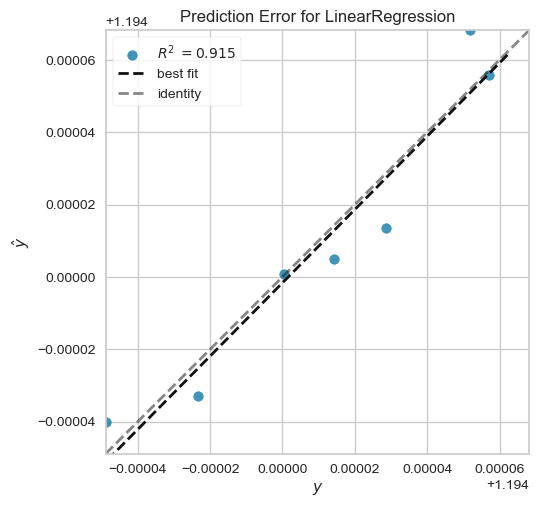

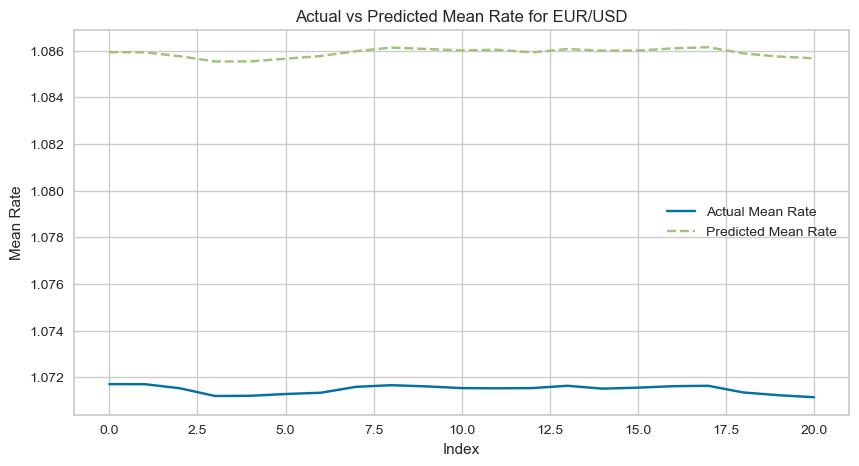

2024-04-29 21:49:51,327 - INFO - MSE for EUR/USD: 0.00020786532103842794


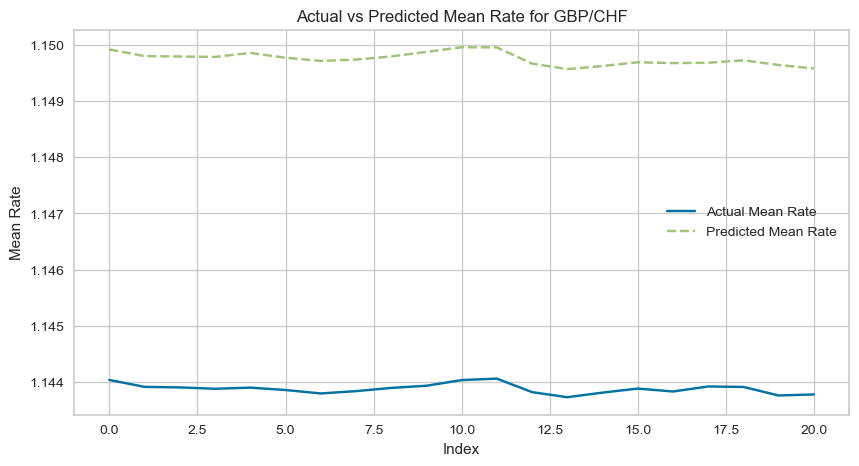

2024-04-29 21:49:51,572 - INFO - MSE for GBP/CHF: 3.4599064547630274e-05


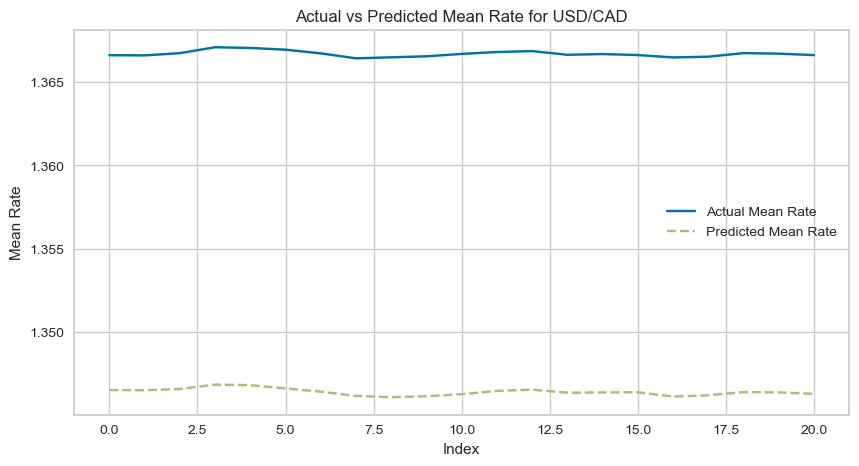

2024-04-29 21:49:51,802 - INFO - MSE for USD/CAD: 0.0004121033162733251
2024-04-29 21:49:51,802 - INFO - Label for GBP/CHF: FORECASTABLE
2024-04-29 21:49:51,803 - INFO - Label for EUR/USD: UNDEFINED
2024-04-29 21:49:51,803 - INFO - Label for USD/CAD: NON-FORECASTABLE
2024-04-29 21:49:52,584 - INFO - Retrieved EUR/USD: {'last': {'ask': 1.07111, 'bid': 1.07108, 'exchange': 48, 'timestamp': 1714441792000}, 'request_id': 'febdd9976a4700695555dab7097fb626', 'status': 'success', 'symbol': 'EUR/USD'}
2024-04-29 21:49:52,881 - INFO - Stored EUR/USD rate at 2024-04-29 21:49:52.585061: 1.0710950000000001
2024-04-29 21:49:53,113 - INFO - Retrieved GBP/CHF: {'last': {'ask': 1.14391, 'bid': 1.14376, 'exchange': 48, 'timestamp': 1714441792000}, 'request_id': '4f9ded4b42ab8d39a12100054ebebdc5', 'status': 'success', 'symbol': 'GBP/CHF'}
2024-04-29 21:49:53,395 - INFO - Stored GBP/CHF rate at 2024-04-29 21:49:53.116640: 1.1438350000000002
2024-04-29 21:49:54,013 - INFO - Retrieved USD/CAD: {'last': {'a

                           pair_name      rate
2024-04-29 21:49:22.427088   BTC/USD  64026.71
2024-04-29 21:49:59.097644   BTC/USD  64075.12
2024-04-29 21:50:06.446583   BTC/USD  64066.70
2024-04-29 21:50:14.013981   BTC/USD  64074.72
2024-04-29 21:50:21.304118   BTC/USD  64067.00
2024-04-29 21:50:29.451927   BTC/USD  64049.96
2024-04-29 21:50:36.541608   BTC/USD  64086.10
2024-04-29 21:50:43.918384   BTC/USD  64084.88
2024-04-29 21:50:51.853434   BTC/USD  64133.87
2024-04-29 21:50:59.950407   BTC/USD  64097.40
2024-04-29 21:51:07.263441   BTC/USD  64106.89
2024-04-29 21:51:15.578554   BTC/USD  64114.69
2024-04-29 21:51:23.176828   BTC/USD  64097.50
2024-04-29 21:51:30.525812   BTC/USD  64084.00
2024-04-29 21:51:37.979431   BTC/USD  64099.99
2024-04-29 21:51:45.408201   BTC/USD  64096.24
2024-04-29 21:51:52.922637   BTC/USD  64090.93
2024-04-29 21:52:00.751304   BTC/USD  64085.15
2024-04-29 21:52:09.372873   BTC/USD  64079.96
2024-04-29 21:52:16.901398   BTC/USD  64083.42
2024-04-29 21

2024-04-29 21:55:27,940 - INFO - Updated correlation for EUR/USD with BTC/USD: 0.3854718552622958
2024-04-29 21:55:28,129 - INFO - Updated correlation for EUR/USD with EUR/USD: 1.0
2024-04-29 21:55:28,315 - INFO - Updated correlation for GBP/CHF with BTC/USD: 0.00044222569276746305
2024-04-29 21:55:28,493 - INFO - Updated correlation for GBP/CHF with EUR/USD: 0.2296642173175216
2024-04-29 21:55:28,694 - INFO - Updated correlation for USD/CAD with BTC/USD: -0.28650874122270953
2024-04-29 21:55:28,884 - INFO - Updated correlation for USD/CAD with EUR/USD: -0.6538313253262306
2024-04-29 21:55:29,093 - INFO - Updated correlation for EUR/CHF with BTC/USD: 0.8425756931703291
2024-04-29 21:55:29,273 - INFO - Updated correlation for EUR/CHF with EUR/USD: 0.4759312615358202
2024-04-29 21:55:29,460 - INFO - Updated correlation for EUR/CAD with BTC/USD: 0.24839198128848397
2024-04-29 21:55:29,651 - INFO - Updated correlation for EUR/CAD with EUR/USD: 0.6913856528361463
2024-04-29 21:55:29,839 - I

,Description,Value
0,Session id,123
1,Target,mean
2,Target type,Regression
3,Original data shape,"(21, 7)"
4,Transformed data shape,"(21, 7)"
5,Transformed train set shape,"(14, 7)"
6,Transformed test set shape,"(7, 7)"
7,Numeric features,6
8,Preprocess,True
9,Imputation type,simple


,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
lr,Linear Regression,0.0000,0.0000,0.0000,0.7703,0.0000,0.0000,1.0900
et,Extra Trees Regressor,0.0000,0.0000,0.0000,0.7319,0.0000,0.0000,0.0300
huber,Huber Regressor,0.0000,0.0000,0.0000,0.6692,0.0000,0.0000,0.0100
gbr,Gradient Boosting Regressor,0.0000,0.0000,0.0000,0.5677,0.0000,0.0000,0.0167
ada,AdaBoost Regressor,0.0000,0.0000,0.0000,0.3033,0.0000,0.0000,0.0200
rf,Random Forest Regressor,0.0000,0.0000,0.0001,0.1099,0.0000,0.0000,0.0367
dt,Decision Tree Regressor,0.0000,0.0000,0.0001,-0.1979,0.0000,0.0000,0.0067
lar,Least Angle Regression,0.0001,0.0000,0.0001,-1.3734,0.0000,0.0001,0.7867
lightgbm,Light Gradient Boosting Machine,0.0001,0.0000,0.0001,-1.5962,0.0000,0.0001,0.0133
lasso,Lasso Regression,0.0001,0.0000,0.0001,-1.5986,0.0000,0.0001,0.7833


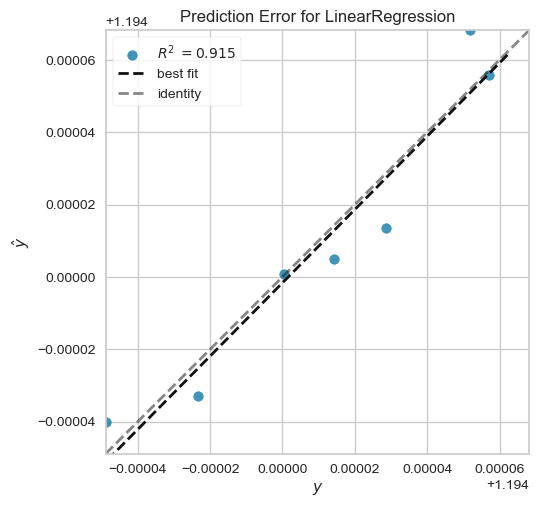

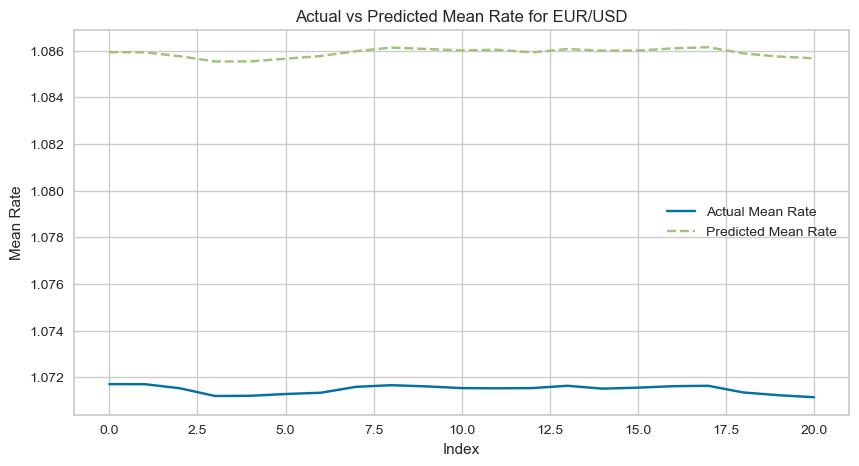

2024-04-29 21:55:51,639 - INFO - MSE for EUR/USD: 0.00020786532103842794


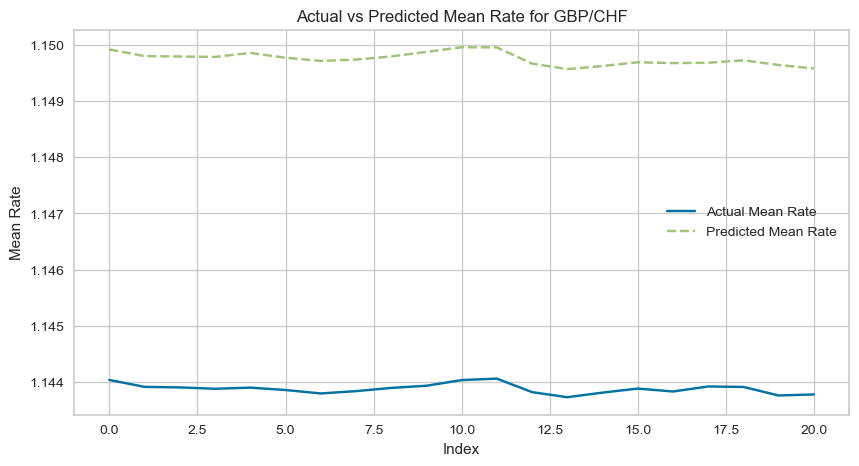

2024-04-29 21:55:51,873 - INFO - MSE for GBP/CHF: 3.4599064547630274e-05


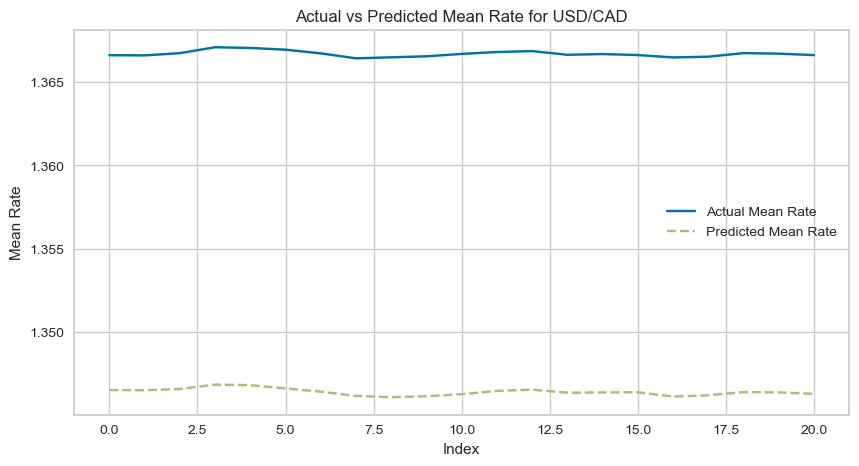

2024-04-29 21:55:52,121 - INFO - MSE for USD/CAD: 0.0004121033162733251
2024-04-29 21:55:52,121 - INFO - Label for GBP/CHF: FORECASTABLE
2024-04-29 21:55:52,122 - INFO - Label for EUR/USD: UNDEFINED
2024-04-29 21:55:52,122 - INFO - Label for USD/CAD: NON-FORECASTABLE
2024-04-29 21:55:52,899 - INFO - Retrieved EUR/USD: {'last': {'ask': 1.07088, 'bid': 1.07086, 'exchange': 48, 'timestamp': 1714442152000}, 'request_id': '9ca0ef8653cddce4817d9bdb6da5ab4c', 'status': 'success', 'symbol': 'EUR/USD'}
2024-04-29 21:55:53,178 - INFO - Stored EUR/USD rate at 2024-04-29 21:55:52.900281: 1.07087
2024-04-29 21:55:53,408 - INFO - Retrieved GBP/CHF: {'last': {'ask': 1.14396, 'bid': 1.14381, 'exchange': 48, 'timestamp': 1714442152000}, 'request_id': 'b2e97a383b83706b8f448dc6a7f2439a', 'status': 'success', 'symbol': 'GBP/CHF'}
2024-04-29 21:55:53,676 - INFO - Stored GBP/CHF rate at 2024-04-29 21:55:53.409917: 1.143885
2024-04-29 21:55:53,904 - INFO - Retrieved USD/CAD: {'last': {'ask': 1.36705, 'bid': 

                           pair_name      rate
2024-04-29 21:55:24.318217   BTC/USD  63983.45
2024-04-29 21:55:58.948106   BTC/USD  63952.00
2024-04-29 21:56:06.361923   BTC/USD  63975.00
2024-04-29 21:56:13.521286   BTC/USD  63933.84
2024-04-29 21:56:21.468548   BTC/USD  63942.50
2024-04-29 21:56:29.217479   BTC/USD  63922.81
2024-04-29 21:56:36.560456   BTC/USD  63923.90
2024-04-29 21:56:44.471922   BTC/USD  63936.33
2024-04-29 21:56:52.575881   BTC/USD  63927.50
2024-04-29 21:57:00.888237   BTC/USD  63949.57
2024-04-29 21:57:08.578253   BTC/USD  63939.00
2024-04-29 21:57:15.982042   BTC/USD  63932.82
2024-04-29 21:57:23.661135   BTC/USD  63924.92
2024-04-29 21:57:31.086858   BTC/USD  63923.30
2024-04-29 21:57:38.556391   BTC/USD  63935.88
2024-04-29 21:57:46.711097   BTC/USD  63927.13
2024-04-29 21:57:53.655119   BTC/USD  63926.45
2024-04-29 21:58:01.419858   BTC/USD  63912.29
2024-04-29 21:58:09.139844   BTC/USD  63916.05
2024-04-29 21:58:16.932509   BTC/USD  63905.00
2024-04-29 21

2024-04-29 22:01:27,947 - INFO - Updated correlation for EUR/USD with BTC/USD: 0.539255554974567
2024-04-29 22:01:28,136 - INFO - Updated correlation for EUR/USD with EUR/USD: 1.0
2024-04-29 22:01:28,364 - INFO - Updated correlation for GBP/CHF with BTC/USD: 0.09139889098826293
2024-04-29 22:01:28,594 - INFO - Updated correlation for GBP/CHF with EUR/USD: 0.3044314373540003
2024-04-29 22:01:28,764 - INFO - Updated correlation for USD/CAD with BTC/USD: -0.41443799531241365
2024-04-29 22:01:28,944 - INFO - Updated correlation for USD/CAD with EUR/USD: -0.773056997210177
2024-04-29 22:01:29,131 - INFO - Updated correlation for EUR/CHF with BTC/USD: 0.8520907142725189
2024-04-29 22:01:29,296 - INFO - Updated correlation for EUR/CHF with EUR/USD: 0.5933439604871765
2024-04-29 22:01:29,482 - INFO - Updated correlation for EUR/CAD with BTC/USD: 0.3793970248917871
2024-04-29 22:01:29,647 - INFO - Updated correlation for EUR/CAD with EUR/USD: 0.6797597641366714
2024-04-29 22:01:29,827 - INFO - 

,Description,Value
0,Session id,123
1,Target,mean
2,Target type,Regression
3,Original data shape,"(21, 7)"
4,Transformed data shape,"(21, 7)"
5,Transformed train set shape,"(14, 7)"
6,Transformed test set shape,"(7, 7)"
7,Numeric features,6
8,Preprocess,True
9,Imputation type,simple


,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
lr,Linear Regression,0.0000,0.0000,0.0000,0.7703,0.0000,0.0000,1.0933
et,Extra Trees Regressor,0.0000,0.0000,0.0000,0.7319,0.0000,0.0000,0.0300
huber,Huber Regressor,0.0000,0.0000,0.0000,0.6692,0.0000,0.0000,0.0100
gbr,Gradient Boosting Regressor,0.0000,0.0000,0.0000,0.5677,0.0000,0.0000,0.0167
ada,AdaBoost Regressor,0.0000,0.0000,0.0000,0.3033,0.0000,0.0000,0.0200
rf,Random Forest Regressor,0.0000,0.0000,0.0001,0.1099,0.0000,0.0000,0.0400
dt,Decision Tree Regressor,0.0000,0.0000,0.0001,-0.1979,0.0000,0.0000,0.0067
lar,Least Angle Regression,0.0001,0.0000,0.0001,-1.3734,0.0000,0.0001,0.7967
lightgbm,Light Gradient Boosting Machine,0.0001,0.0000,0.0001,-1.5962,0.0000,0.0001,0.0100
lasso,Lasso Regression,0.0001,0.0000,0.0001,-1.5986,0.0000,0.0001,0.8067


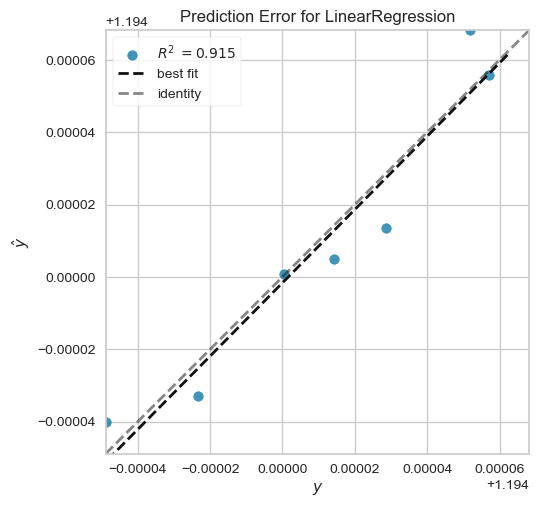

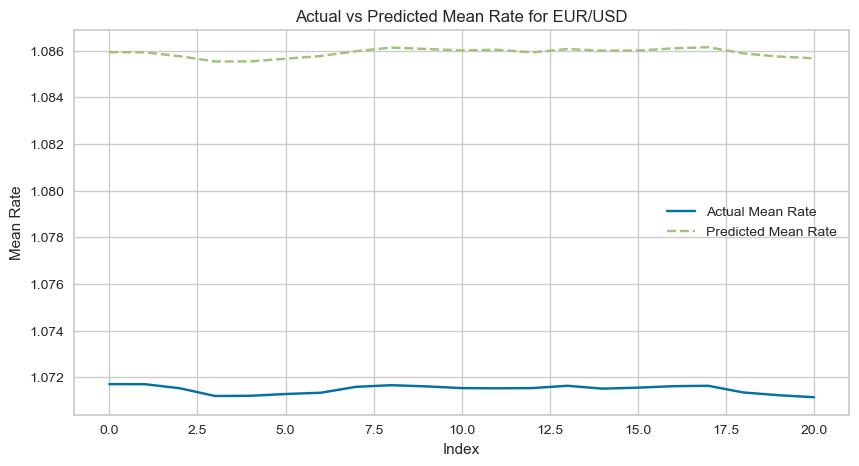

2024-04-29 22:01:51,743 - INFO - MSE for EUR/USD: 0.00020786532103842794


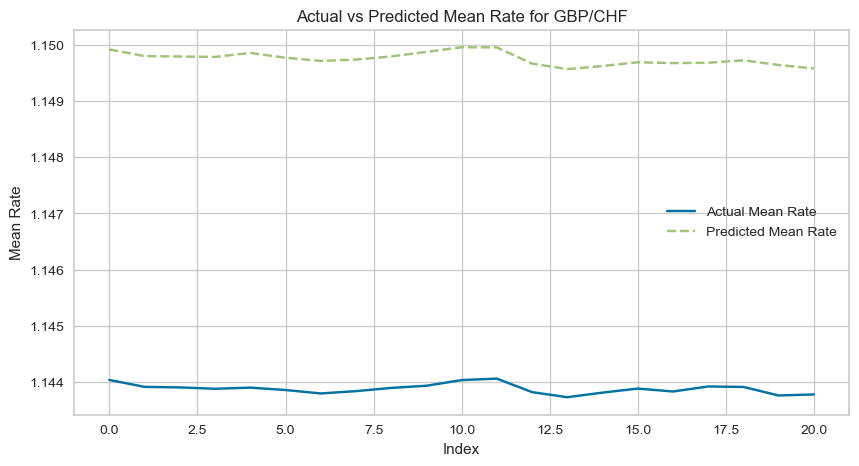

2024-04-29 22:01:51,981 - INFO - MSE for GBP/CHF: 3.4599064547630274e-05


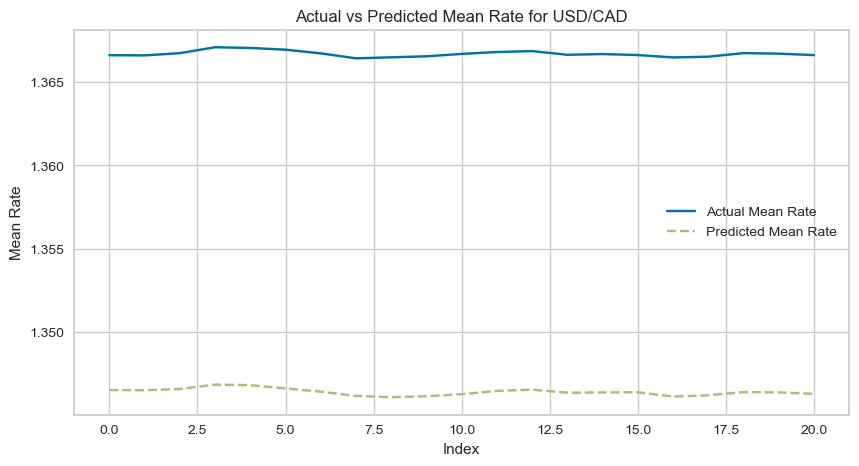

2024-04-29 22:01:52,203 - INFO - MSE for USD/CAD: 0.0004121033162733251
2024-04-29 22:01:52,203 - INFO - Label for GBP/CHF: FORECASTABLE
2024-04-29 22:01:52,204 - INFO - Label for EUR/USD: UNDEFINED
2024-04-29 22:01:52,205 - INFO - Label for USD/CAD: NON-FORECASTABLE
2024-04-29 22:01:52,976 - INFO - Retrieved EUR/USD: {'last': {'ask': 1.07063, 'bid': 1.07061, 'exchange': 48, 'timestamp': 1714442512000}, 'request_id': 'db2781bd1136e3b4fd62c5d719a08bcb', 'status': 'success', 'symbol': 'EUR/USD'}
2024-04-29 22:01:53,249 - INFO - Stored EUR/USD rate at 2024-04-29 22:01:52.978604: 1.07062
2024-04-29 22:01:53,671 - INFO - Retrieved GBP/CHF: {'last': {'ask': 1.14383, 'bid': 1.14363, 'exchange': 48, 'timestamp': 1714442513000}, 'request_id': 'dc3c382db88c630720dad4ba6cd2a1e1', 'status': 'success', 'symbol': 'GBP/CHF'}
2024-04-29 22:01:53,966 - INFO - Stored GBP/CHF rate at 2024-04-29 22:01:53.673746: 1.14373
2024-04-29 22:01:54,222 - INFO - Retrieved USD/CAD: {'last': {'ask': 1.36748, 'bid': 1

                           pair_name      rate
2024-04-29 22:01:24.248845   BTC/USD  63383.44
2024-04-29 22:01:59.095246   BTC/USD  63361.03
2024-04-29 22:02:07.240056   BTC/USD  63396.41
2024-04-29 22:02:15.375961   BTC/USD  63350.00
2024-04-29 22:02:22.885444   BTC/USD  63332.80
2024-04-29 22:02:30.255240   BTC/USD  63326.26
2024-04-29 22:02:37.904650   BTC/USD  63351.79
2024-04-29 22:02:46.256824   BTC/USD  63341.05
2024-04-29 22:02:54.161190   BTC/USD  63276.67
2024-04-29 22:03:01.615853   BTC/USD  63280.00
2024-04-29 22:03:09.365638   BTC/USD  63257.39
2024-04-29 22:03:17.489520   BTC/USD  63232.14
2024-04-29 22:03:24.876364   BTC/USD  63128.00
2024-04-29 22:03:32.941632   BTC/USD  63117.11
2024-04-29 22:03:41.636220   BTC/USD  63131.80
2024-04-29 22:03:50.272711   BTC/USD  63187.46
2024-04-29 22:03:58.614904   BTC/USD  63248.55
2024-04-29 22:04:07.332185   BTC/USD  63189.97
2024-04-29 22:04:14.902445   BTC/USD  63196.30
2024-04-29 22:04:23.299575   BTC/USD  63150.81
2024-04-29 22

2024-04-29 22:07:28,526 - INFO - Updated correlation for EUR/USD with BTC/USD: 0.7220167146134974
2024-04-29 22:07:28,692 - INFO - Updated correlation for EUR/USD with EUR/USD: 1.0
2024-04-29 22:07:28,864 - INFO - Updated correlation for GBP/CHF with BTC/USD: 0.27531104811176427
2024-04-29 22:07:29,018 - INFO - Updated correlation for GBP/CHF with EUR/USD: 0.41231169778459387
2024-04-29 22:07:29,179 - INFO - Updated correlation for USD/CAD with BTC/USD: -0.6008312672555155
2024-04-29 22:07:29,360 - INFO - Updated correlation for USD/CAD with EUR/USD: -0.8452044624580239
2024-04-29 22:07:29,543 - INFO - Updated correlation for EUR/CHF with BTC/USD: 0.8516074435516543
2024-04-29 22:07:29,717 - INFO - Updated correlation for EUR/CHF with EUR/USD: 0.692230011889178
2024-04-29 22:07:29,889 - INFO - Updated correlation for EUR/CAD with BTC/USD: 0.5405315590194015
2024-04-29 22:07:30,061 - INFO - Updated correlation for EUR/CAD with EUR/USD: 0.7179297887591292
2024-04-29 22:07:30,246 - INFO -

,Description,Value
0,Session id,123
1,Target,mean
2,Target type,Regression
3,Original data shape,"(21, 7)"
4,Transformed data shape,"(21, 7)"
5,Transformed train set shape,"(14, 7)"
6,Transformed test set shape,"(7, 7)"
7,Numeric features,6
8,Preprocess,True
9,Imputation type,simple


,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
lr,Linear Regression,0.0000,0.0000,0.0000,0.7703,0.0000,0.0000,1.0900
et,Extra Trees Regressor,0.0000,0.0000,0.0000,0.7319,0.0000,0.0000,0.0300
huber,Huber Regressor,0.0000,0.0000,0.0000,0.6692,0.0000,0.0000,0.0100
gbr,Gradient Boosting Regressor,0.0000,0.0000,0.0000,0.5677,0.0000,0.0000,0.0167
ada,AdaBoost Regressor,0.0000,0.0000,0.0000,0.3033,0.0000,0.0000,0.0200
rf,Random Forest Regressor,0.0000,0.0000,0.0001,0.1099,0.0000,0.0000,0.0367
dt,Decision Tree Regressor,0.0000,0.0000,0.0001,-0.1979,0.0000,0.0000,0.0067
lar,Least Angle Regression,0.0001,0.0000,0.0001,-1.3734,0.0000,0.0001,0.7967
lightgbm,Light Gradient Boosting Machine,0.0001,0.0000,0.0001,-1.5962,0.0000,0.0001,0.0133
lasso,Lasso Regression,0.0001,0.0000,0.0001,-1.5986,0.0000,0.0001,0.7867


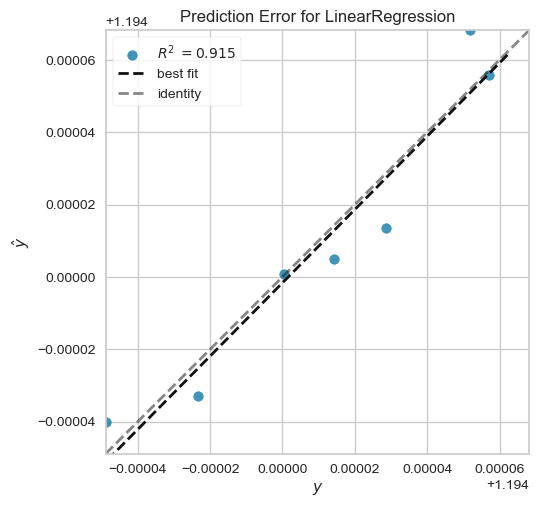

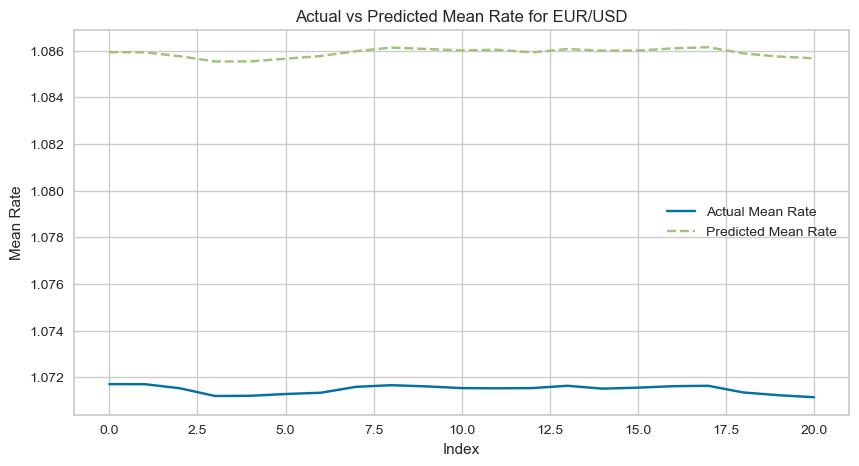

2024-04-29 22:07:51,990 - INFO - MSE for EUR/USD: 0.00020786532103842794


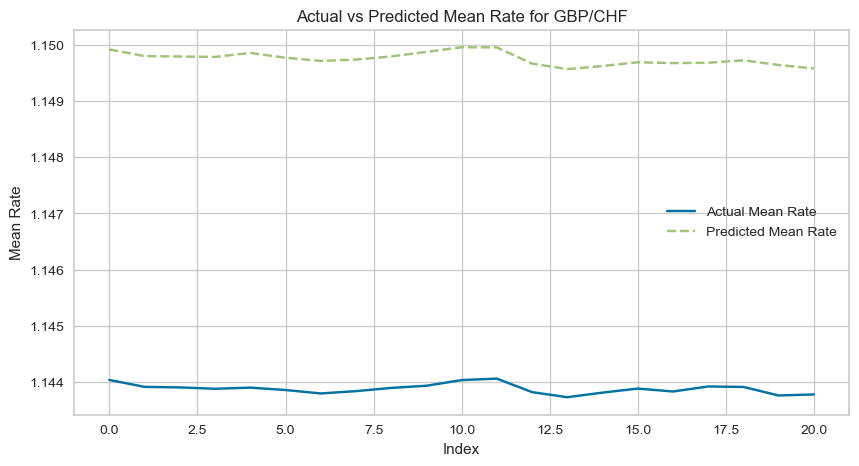

2024-04-29 22:07:52,224 - INFO - MSE for GBP/CHF: 3.4599064547630274e-05


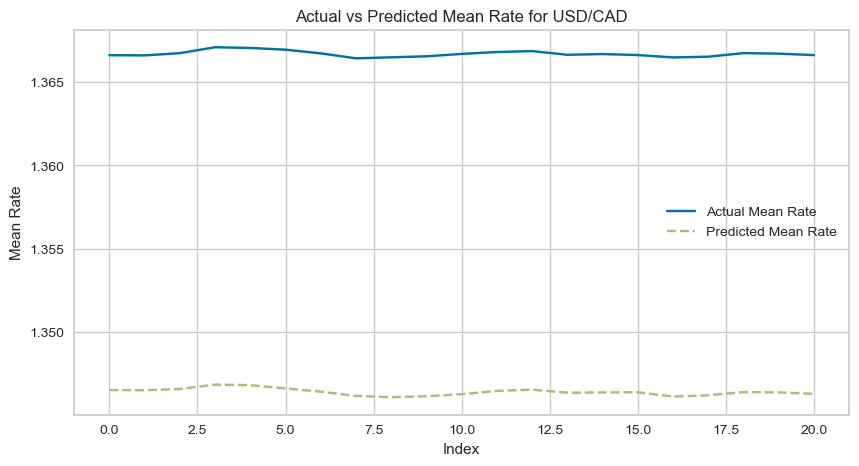

2024-04-29 22:07:52,451 - INFO - MSE for USD/CAD: 0.0004121033162733251
2024-04-29 22:07:52,452 - INFO - Label for GBP/CHF: FORECASTABLE
2024-04-29 22:07:52,452 - INFO - Label for EUR/USD: UNDEFINED
2024-04-29 22:07:52,453 - INFO - Label for USD/CAD: NON-FORECASTABLE
2024-04-29 22:07:53,232 - INFO - Retrieved EUR/USD: {'last': {'ask': 1.07053, 'bid': 1.0705, 'exchange': 48, 'timestamp': 1714442872000}, 'request_id': 'b970460356d23637a89a59e3324631e7', 'status': 'success', 'symbol': 'EUR/USD'}
2024-04-29 22:07:53,509 - INFO - Stored EUR/USD rate at 2024-04-29 22:07:53.236984: 1.0705149999999999
2024-04-29 22:07:53,736 - INFO - Retrieved GBP/CHF: {'last': {'ask': 1.14374, 'bid': 1.14355, 'exchange': 48, 'timestamp': 1714442873000}, 'request_id': '355b9eecefeeaa0d55fdacc3d1d691a4', 'status': 'success', 'symbol': 'GBP/CHF'}
2024-04-29 22:07:54,045 - INFO - Stored GBP/CHF rate at 2024-04-29 22:07:53.738643: 1.143645
2024-04-29 22:07:54,291 - INFO - Retrieved USD/CAD: {'last': {'ask': 1.3673

                           pair_name      rate
2024-04-29 22:07:24.904971   BTC/USD  63424.00
2024-04-29 22:07:58.820053   BTC/USD  63419.64
2024-04-29 22:08:06.664726   BTC/USD  63451.90
2024-04-29 22:08:14.287976   BTC/USD  63451.90
2024-04-29 22:08:21.601998   BTC/USD  63493.74
2024-04-29 22:08:29.291027   BTC/USD  63451.90
2024-04-29 22:08:36.777607   BTC/USD  63442.50
2024-04-29 22:08:44.436712   BTC/USD  63431.18
2024-04-29 22:08:52.235365   BTC/USD  63428.59
2024-04-29 22:09:00.072995   BTC/USD  63438.12
2024-04-29 22:09:07.560611   BTC/USD  63446.61
2024-04-29 22:09:15.104909   BTC/USD  63455.01
2024-04-29 22:09:22.584409   BTC/USD  63575.00
2024-04-29 22:09:29.816692   BTC/USD  63440.71
2024-04-29 22:09:37.162639   BTC/USD  63556.00
2024-04-29 22:09:44.583333   BTC/USD  63454.07
2024-04-29 22:09:51.784681   BTC/USD  63461.57
2024-04-29 22:09:59.213368   BTC/USD  63464.00
2024-04-29 22:10:06.762768   BTC/USD  63447.79
2024-04-29 22:10:14.309213   BTC/USD  63438.62
2024-04-29 22

2024-04-29 22:13:26,647 - INFO - Updated correlation for EUR/USD with BTC/USD: 0.7731836878290012
2024-04-29 22:13:26,868 - INFO - Updated correlation for EUR/USD with EUR/USD: 1.0
2024-04-29 22:13:27,064 - INFO - Updated correlation for GBP/CHF with BTC/USD: 0.38671011136930294
2024-04-29 22:13:27,260 - INFO - Updated correlation for GBP/CHF with EUR/USD: 0.5080469251432542
2024-04-29 22:13:27,463 - INFO - Updated correlation for USD/CAD with BTC/USD: -0.6565282710762822
2024-04-29 22:13:27,652 - INFO - Updated correlation for USD/CAD with EUR/USD: -0.8845889418639001
2024-04-29 22:13:27,840 - INFO - Updated correlation for EUR/CHF with BTC/USD: 0.8647531422508626
2024-04-29 22:13:28,027 - INFO - Updated correlation for EUR/CHF with EUR/USD: 0.7294455879291615
2024-04-29 22:13:28,216 - INFO - Updated correlation for EUR/CAD with BTC/USD: 0.6609636234045668
2024-04-29 22:13:28,390 - INFO - Updated correlation for EUR/CAD with EUR/USD: 0.7974658918896143
2024-04-29 22:13:28,572 - INFO -

,Description,Value
0,Session id,123
1,Target,mean
2,Target type,Regression
3,Original data shape,"(21, 7)"
4,Transformed data shape,"(21, 7)"
5,Transformed train set shape,"(14, 7)"
6,Transformed test set shape,"(7, 7)"
7,Numeric features,6
8,Preprocess,True
9,Imputation type,simple


,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
lr,Linear Regression,0.0000,0.0000,0.0000,0.7703,0.0000,0.0000,1.0800
et,Extra Trees Regressor,0.0000,0.0000,0.0000,0.7319,0.0000,0.0000,0.0300
huber,Huber Regressor,0.0000,0.0000,0.0000,0.6692,0.0000,0.0000,0.0100
gbr,Gradient Boosting Regressor,0.0000,0.0000,0.0000,0.5677,0.0000,0.0000,0.0167
ada,AdaBoost Regressor,0.0000,0.0000,0.0000,0.3033,0.0000,0.0000,0.0200
rf,Random Forest Regressor,0.0000,0.0000,0.0001,0.1099,0.0000,0.0000,0.0367
dt,Decision Tree Regressor,0.0000,0.0000,0.0001,-0.1979,0.0000,0.0000,0.0067
lar,Least Angle Regression,0.0001,0.0000,0.0001,-1.3734,0.0000,0.0001,0.8000
lightgbm,Light Gradient Boosting Machine,0.0001,0.0000,0.0001,-1.5962,0.0000,0.0001,0.0100
lasso,Lasso Regression,0.0001,0.0000,0.0001,-1.5986,0.0000,0.0001,0.7967


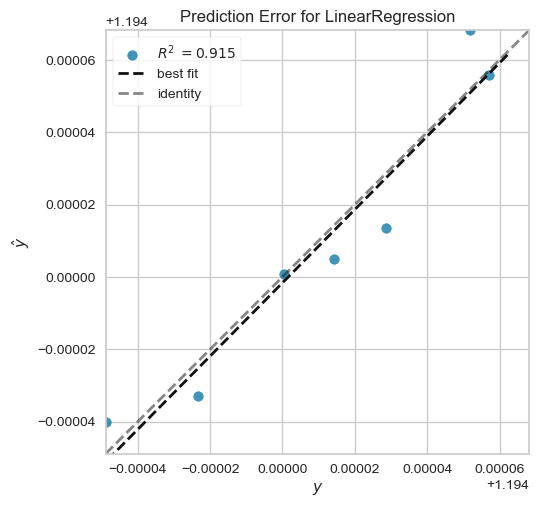

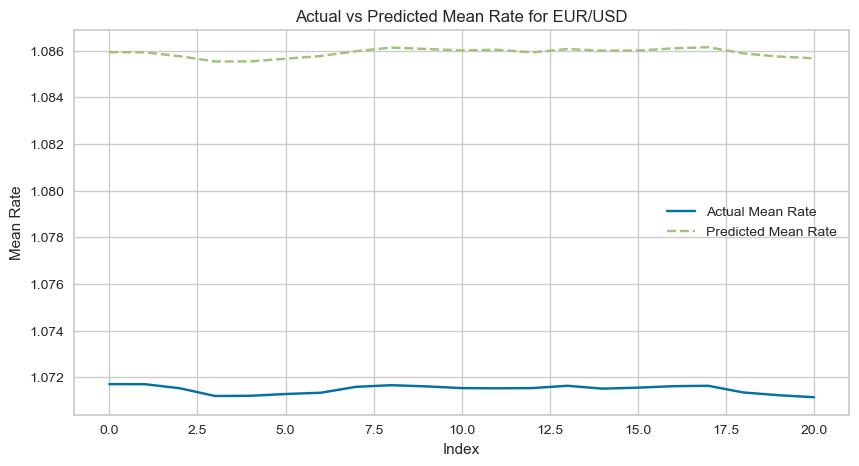

2024-04-29 22:13:50,414 - INFO - MSE for EUR/USD: 0.00020786532103842794


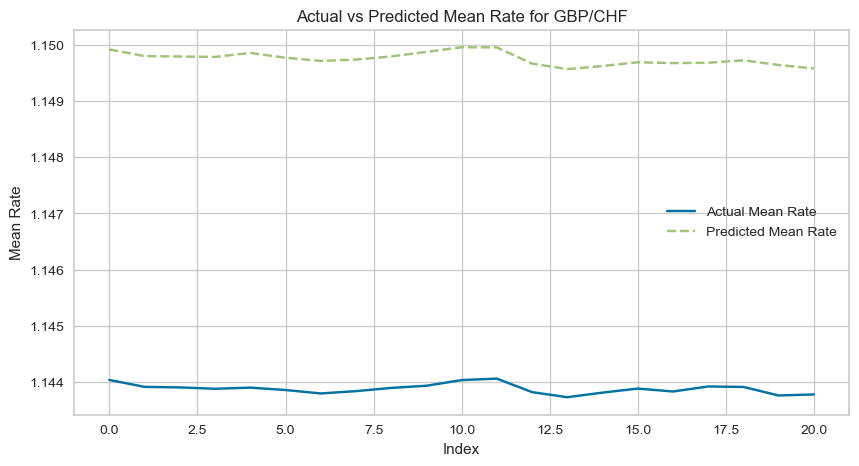

2024-04-29 22:13:50,651 - INFO - MSE for GBP/CHF: 3.4599064547630274e-05


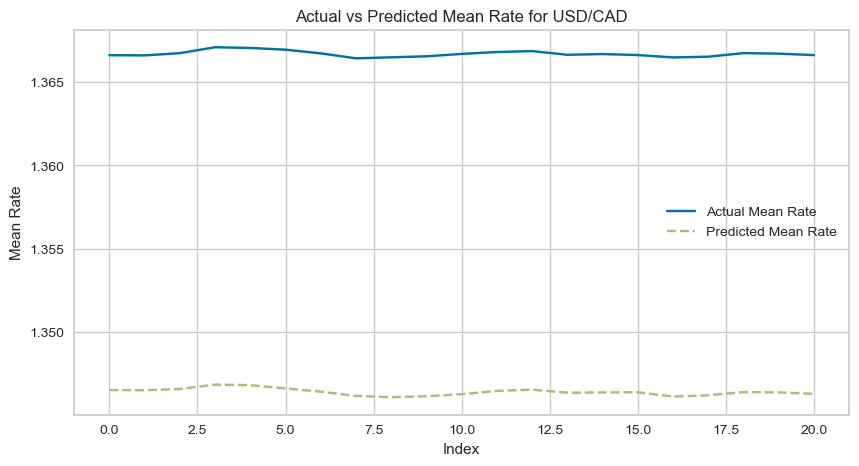

2024-04-29 22:13:50,877 - INFO - MSE for USD/CAD: 0.0004121033162733251
2024-04-29 22:13:50,877 - INFO - Label for GBP/CHF: FORECASTABLE
2024-04-29 22:13:50,878 - INFO - Label for EUR/USD: UNDEFINED
2024-04-29 22:13:50,878 - INFO - Label for USD/CAD: NON-FORECASTABLE
2024-04-29 22:13:51,646 - INFO - Retrieved EUR/USD: {'last': {'ask': 1.0707, 'bid': 1.0704, 'exchange': 48, 'timestamp': 1714443228000}, 'request_id': '8723938e57c90e57f9decd975195f290', 'status': 'success', 'symbol': 'EUR/USD'}
2024-04-29 22:13:51,900 - INFO - Stored EUR/USD rate at 2024-04-29 22:13:51.647860: 1.07055
2024-04-29 22:13:52,154 - INFO - Retrieved GBP/CHF: {'last': {'ask': 1.14379, 'bid': 1.14364, 'exchange': 48, 'timestamp': 1714443231000}, 'request_id': 'd1036594f7bc88c5edc486cc27971263', 'status': 'success', 'symbol': 'GBP/CHF'}
2024-04-29 22:13:52,424 - INFO - Stored GBP/CHF rate at 2024-04-29 22:13:52.155510: 1.143715
2024-04-29 22:13:52,666 - INFO - Retrieved USD/CAD: {'last': {'ask': 1.36741, 'bid': 1.

                           pair_name      rate
2024-04-29 22:13:22.982016   BTC/USD  63407.60
2024-04-29 22:13:57.239904   BTC/USD  63409.17
2024-04-29 22:14:05.204197   BTC/USD  63416.38
2024-04-29 22:14:12.583973   BTC/USD  63437.53
2024-04-29 22:14:19.718491   BTC/USD  63462.52
2024-04-29 22:14:27.199118   BTC/USD  63488.36
2024-04-29 22:14:34.628759   BTC/USD  63491.27
2024-04-29 22:14:41.854073   BTC/USD  63461.59
2024-04-29 22:14:49.195961   BTC/USD  63471.96
2024-04-29 22:14:56.329393   BTC/USD  63480.11
2024-04-29 22:15:04.932895   BTC/USD  63481.01
2024-04-29 22:15:12.765460   BTC/USD  63470.60
2024-04-29 22:15:20.493381   BTC/USD  63468.09
2024-04-29 22:15:28.342023   BTC/USD  63457.93
2024-04-29 22:15:36.144661   BTC/USD  63462.00
2024-04-29 22:15:43.990265   BTC/USD  63439.44
2024-04-29 22:15:51.690263   BTC/USD  63439.30
2024-04-29 22:15:59.417490   BTC/USD  63449.96
2024-04-29 22:16:08.161698   BTC/USD  63449.95
2024-04-29 22:16:15.468560   BTC/USD  63474.00
2024-04-29 22

2024-04-29 22:19:25,185 - INFO - Updated correlation for EUR/USD with BTC/USD: 0.8061715297641815
2024-04-29 22:19:25,383 - INFO - Updated correlation for EUR/USD with EUR/USD: 1.0
2024-04-29 22:19:25,564 - INFO - Updated correlation for GBP/CHF with BTC/USD: 0.4782703442554878
2024-04-29 22:19:25,737 - INFO - Updated correlation for GBP/CHF with EUR/USD: 0.5689381879960494
2024-04-29 22:19:25,906 - INFO - Updated correlation for USD/CAD with BTC/USD: -0.6946831675816952
2024-04-29 22:19:26,102 - INFO - Updated correlation for USD/CAD with EUR/USD: -0.9174344013516726
2024-04-29 22:19:26,281 - INFO - Updated correlation for EUR/CHF with BTC/USD: 0.8824397535645928
2024-04-29 22:19:26,462 - INFO - Updated correlation for EUR/CHF with EUR/USD: 0.7641279518113858
2024-04-29 22:19:26,630 - INFO - Updated correlation for EUR/CAD with BTC/USD: 0.7425604889943322
2024-04-29 22:19:26,820 - INFO - Updated correlation for EUR/CAD with EUR/USD: 0.83562073565557
2024-04-29 22:19:27,014 - INFO - Up

,Description,Value
0,Session id,123
1,Target,mean
2,Target type,Regression
3,Original data shape,"(21, 7)"
4,Transformed data shape,"(21, 7)"
5,Transformed train set shape,"(14, 7)"
6,Transformed test set shape,"(7, 7)"
7,Numeric features,6
8,Preprocess,True
9,Imputation type,simple


,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
lr,Linear Regression,0.0000,0.0000,0.0000,0.7703,0.0000,0.0000,1.1100
et,Extra Trees Regressor,0.0000,0.0000,0.0000,0.7319,0.0000,0.0000,0.0300
huber,Huber Regressor,0.0000,0.0000,0.0000,0.6692,0.0000,0.0000,0.0100
gbr,Gradient Boosting Regressor,0.0000,0.0000,0.0000,0.5677,0.0000,0.0000,0.0167
ada,AdaBoost Regressor,0.0000,0.0000,0.0000,0.3033,0.0000,0.0000,0.0233
rf,Random Forest Regressor,0.0000,0.0000,0.0001,0.1099,0.0000,0.0000,0.0367
dt,Decision Tree Regressor,0.0000,0.0000,0.0001,-0.1979,0.0000,0.0000,0.0100
lar,Least Angle Regression,0.0001,0.0000,0.0001,-1.3734,0.0000,0.0001,0.7833
lightgbm,Light Gradient Boosting Machine,0.0001,0.0000,0.0001,-1.5962,0.0000,0.0001,0.0100
lasso,Lasso Regression,0.0001,0.0000,0.0001,-1.5986,0.0000,0.0001,0.8133


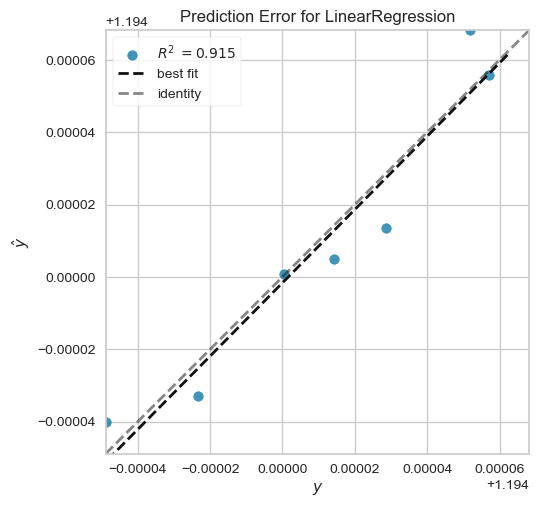

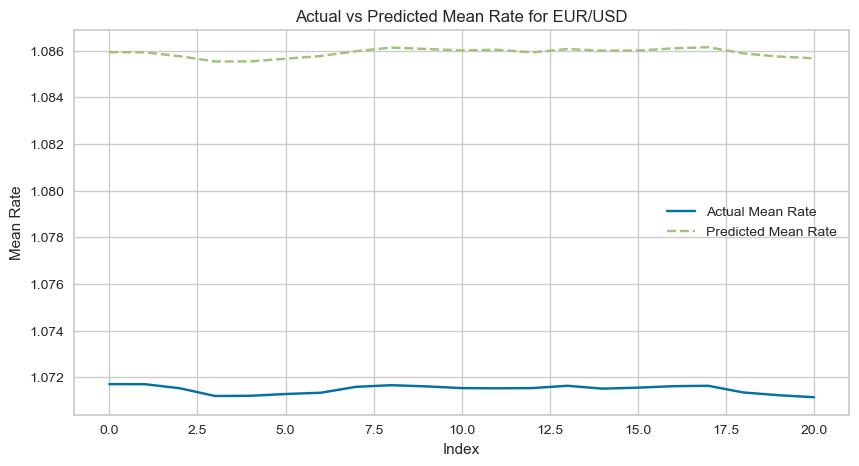

2024-04-29 22:19:48,929 - INFO - MSE for EUR/USD: 0.00020786532103842794


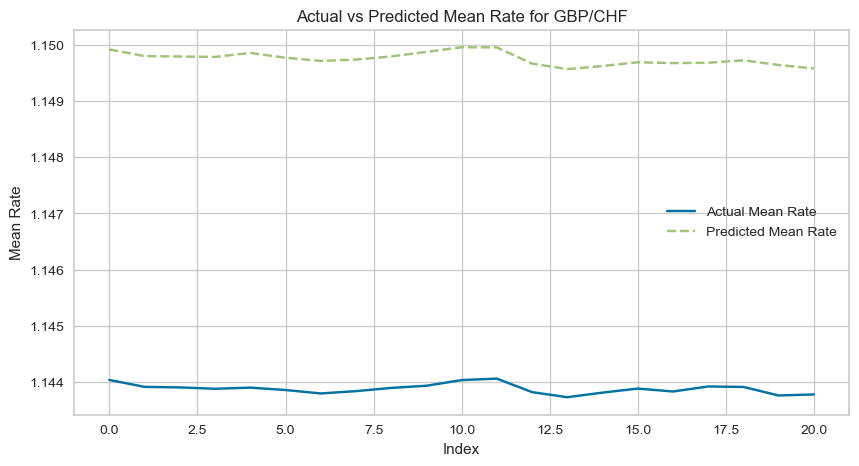

2024-04-29 22:19:49,166 - INFO - MSE for GBP/CHF: 3.4599064547630274e-05


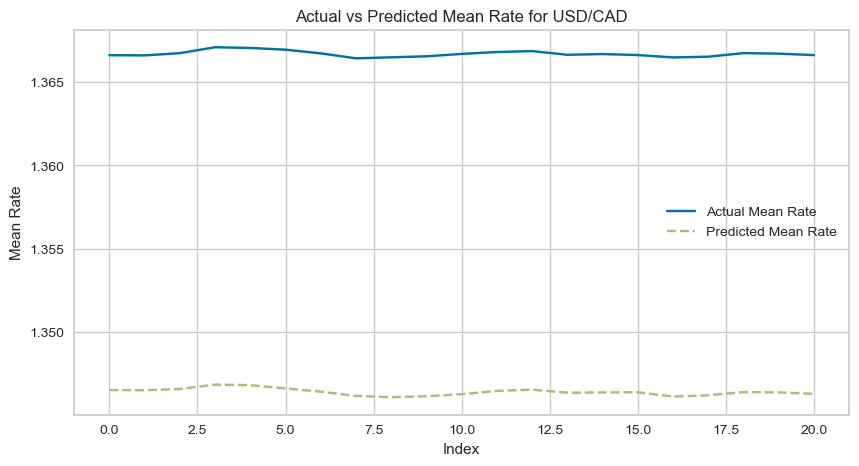

2024-04-29 22:19:49,391 - INFO - MSE for USD/CAD: 0.0004121033162733251
2024-04-29 22:19:49,391 - INFO - Label for GBP/CHF: FORECASTABLE
2024-04-29 22:19:49,392 - INFO - Label for EUR/USD: UNDEFINED
2024-04-29 22:19:49,392 - INFO - Label for USD/CAD: NON-FORECASTABLE
2024-04-29 22:19:50,253 - INFO - Retrieved EUR/USD: {'last': {'ask': 1.07051, 'bid': 1.07048, 'exchange': 48, 'timestamp': 1714443587000}, 'request_id': '193816c67651cd19521df1bb37b121cd', 'status': 'success', 'symbol': 'EUR/USD'}
2024-04-29 22:19:50,550 - INFO - Stored EUR/USD rate at 2024-04-29 22:19:50.255156: 1.0704950000000002
2024-04-29 22:19:50,811 - INFO - Retrieved GBP/CHF: {'last': {'ask': 1.14365, 'bid': 1.1435, 'exchange': 48, 'timestamp': 1714443590000}, 'request_id': '4a6a55c69c0b68a649ed8db7e986c2b2', 'status': 'success', 'symbol': 'GBP/CHF'}
2024-04-29 22:19:51,082 - INFO - Stored GBP/CHF rate at 2024-04-29 22:19:50.813664: 1.143575
2024-04-29 22:19:51,347 - INFO - Retrieved USD/CAD: {'last': {'ask': 1.3675

                           pair_name      rate
2024-04-29 22:19:21.473501   BTC/USD  63577.01
2024-04-29 22:19:56.429644   BTC/USD  63586.69
2024-04-29 22:20:04.992335   BTC/USD  63607.49
2024-04-29 22:20:12.346172   BTC/USD  63613.41
2024-04-29 22:20:20.181882   BTC/USD  63620.93
2024-04-29 22:20:28.994938   BTC/USD  63622.93
2024-04-29 22:20:37.215549   BTC/USD  63726.00
2024-04-29 22:20:44.944384   BTC/USD  63654.15
2024-04-29 22:20:53.549049   BTC/USD  63645.72
2024-04-29 22:21:01.029505   BTC/USD  63643.04
2024-04-29 22:21:08.925958   BTC/USD  63652.34
2024-04-29 22:21:16.492238   BTC/USD  63620.40
2024-04-29 22:21:24.393159   BTC/USD  63641.61
2024-04-29 22:21:32.039998   BTC/USD  63593.00
2024-04-29 22:21:40.066251   BTC/USD  63635.70
2024-04-29 22:21:47.347398   BTC/USD  63589.11
2024-04-29 22:21:55.464305   BTC/USD  63623.41
2024-04-29 22:22:03.280906   BTC/USD  63624.05
2024-04-29 22:22:10.665791   BTC/USD  63610.00
2024-04-29 22:22:17.931589   BTC/USD  63608.66
2024-04-29 22

2024-04-29 22:25:26,021 - INFO - Updated correlation for EUR/USD with BTC/USD: 0.8338565152670676
2024-04-29 22:25:26,210 - INFO - Updated correlation for EUR/USD with EUR/USD: 1.0
2024-04-29 22:25:26,413 - INFO - Updated correlation for GBP/CHF with BTC/USD: 0.5472035175227815
2024-04-29 22:25:26,600 - INFO - Updated correlation for GBP/CHF with EUR/USD: 0.6434388000473
2024-04-29 22:25:26,757 - INFO - Updated correlation for USD/CAD with BTC/USD: -0.7178155932553004
2024-04-29 22:25:26,943 - INFO - Updated correlation for USD/CAD with EUR/USD: -0.932615477449547
2024-04-29 22:25:27,129 - INFO - Updated correlation for EUR/CHF with BTC/USD: 0.8903016929511917
2024-04-29 22:25:27,318 - INFO - Updated correlation for EUR/CHF with EUR/USD: 0.8000792995967334
2024-04-29 22:25:27,460 - INFO - Updated correlation for EUR/CAD with BTC/USD: 0.8080387268515561
2024-04-29 22:25:27,630 - INFO - Updated correlation for EUR/CAD with EUR/USD: 0.8596459889237917
2024-04-29 22:25:27,804 - INFO - Upda

,Description,Value
0,Session id,123
1,Target,mean
2,Target type,Regression
3,Original data shape,"(21, 7)"
4,Transformed data shape,"(21, 7)"
5,Transformed train set shape,"(14, 7)"
6,Transformed test set shape,"(7, 7)"
7,Numeric features,6
8,Preprocess,True
9,Imputation type,simple


,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
lr,Linear Regression,0.0000,0.0000,0.0000,0.7703,0.0000,0.0000,1.0700
et,Extra Trees Regressor,0.0000,0.0000,0.0000,0.7319,0.0000,0.0000,0.0300
huber,Huber Regressor,0.0000,0.0000,0.0000,0.6692,0.0000,0.0000,0.0100
gbr,Gradient Boosting Regressor,0.0000,0.0000,0.0000,0.5677,0.0000,0.0000,0.0167
ada,AdaBoost Regressor,0.0000,0.0000,0.0000,0.3033,0.0000,0.0000,0.0200
rf,Random Forest Regressor,0.0000,0.0000,0.0001,0.1099,0.0000,0.0000,0.0367
dt,Decision Tree Regressor,0.0000,0.0000,0.0001,-0.1979,0.0000,0.0000,0.0067
lar,Least Angle Regression,0.0001,0.0000,0.0001,-1.3734,0.0000,0.0001,0.7867
lightgbm,Light Gradient Boosting Machine,0.0001,0.0000,0.0001,-1.5962,0.0000,0.0001,0.0133
lasso,Lasso Regression,0.0001,0.0000,0.0001,-1.5986,0.0000,0.0001,0.7933


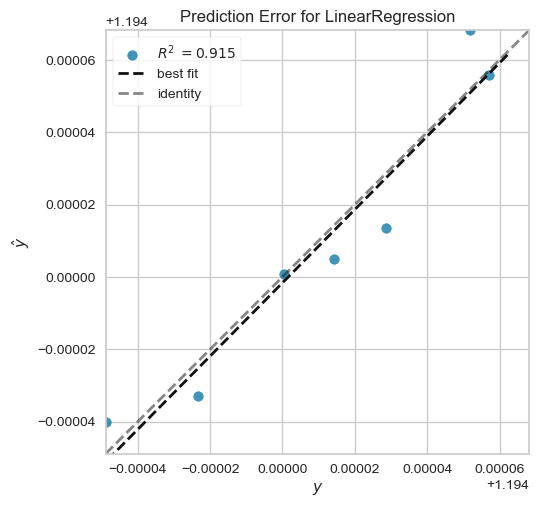

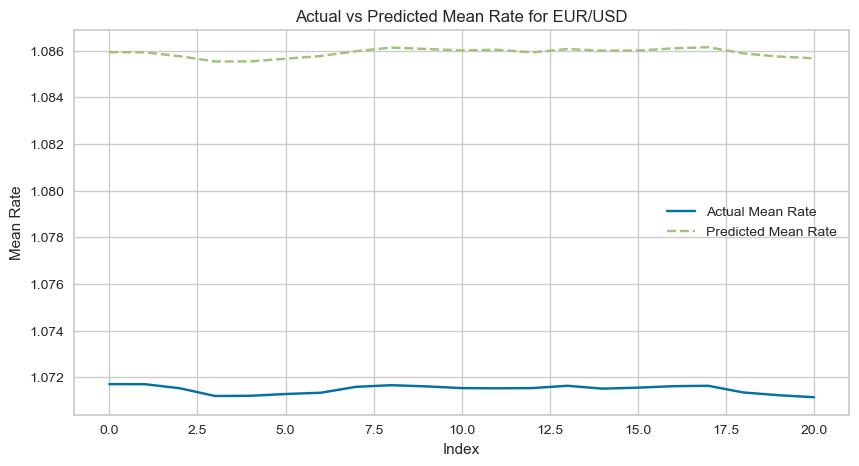

2024-04-29 22:25:49,485 - INFO - MSE for EUR/USD: 0.00020786532103842794


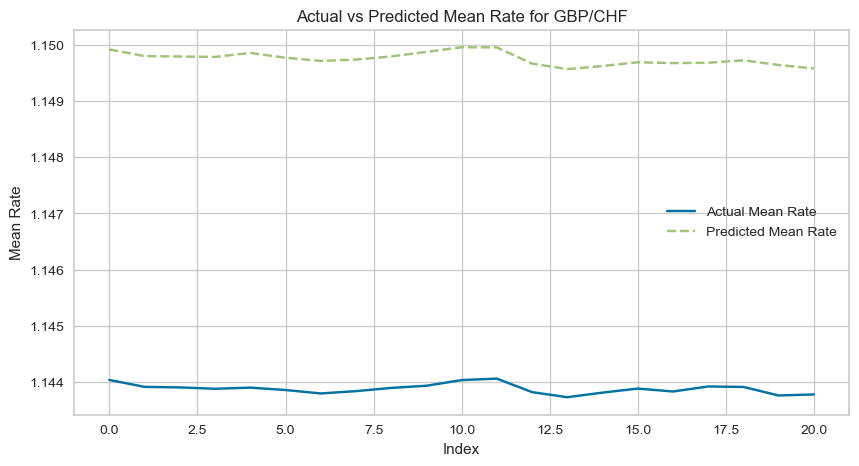

2024-04-29 22:25:49,724 - INFO - MSE for GBP/CHF: 3.4599064547630274e-05


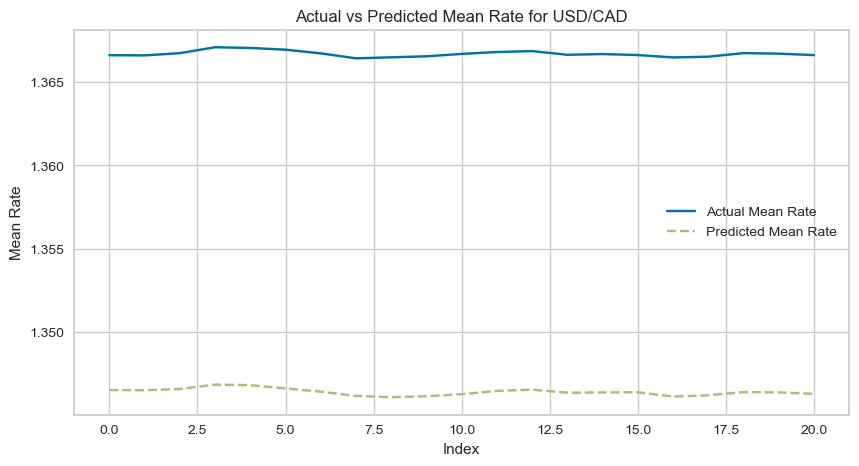

2024-04-29 22:25:49,954 - INFO - MSE for USD/CAD: 0.0004121033162733251
2024-04-29 22:25:49,954 - INFO - Label for GBP/CHF: FORECASTABLE
2024-04-29 22:25:49,955 - INFO - Label for EUR/USD: UNDEFINED
2024-04-29 22:25:49,956 - INFO - Label for USD/CAD: NON-FORECASTABLE
2024-04-29 22:25:50,829 - INFO - Retrieved EUR/USD: {'last': {'ask': 1.0705, 'bid': 1.07045, 'exchange': 48, 'timestamp': 1714443950000}, 'request_id': '73d26582854a285e0d03b871195661d0', 'status': 'success', 'symbol': 'EUR/USD'}
2024-04-29 22:25:51,113 - INFO - Stored EUR/USD rate at 2024-04-29 22:25:50.831181: 1.070475
2024-04-29 22:25:51,398 - INFO - Retrieved GBP/CHF: {'last': {'ask': 1.14375, 'bid': 1.14354, 'exchange': 48, 'timestamp': 1714443951000}, 'request_id': '14c71512c65ab564c89c451960e25881', 'status': 'success', 'symbol': 'GBP/CHF'}
2024-04-29 22:25:51,690 - INFO - Stored GBP/CHF rate at 2024-04-29 22:25:51.399662: 1.143645
2024-04-29 22:25:51,935 - INFO - Retrieved USD/CAD: {'last': {'ask': 1.36752, 'bid': 

                           pair_name      rate
2024-04-29 22:25:22.330899   BTC/USD  63619.40
2024-04-29 22:25:57.411581   BTC/USD  63627.29
2024-04-29 22:26:05.654043   BTC/USD  63629.95
2024-04-29 22:26:13.138662   BTC/USD  63647.89
2024-04-29 22:26:20.921365   BTC/USD  63661.76
2024-04-29 22:26:28.525656   BTC/USD  63659.40
2024-04-29 22:26:36.154846   BTC/USD  63671.46
2024-04-29 22:26:44.272720   BTC/USD  63650.75
2024-04-29 22:26:51.784280   BTC/USD  63650.80
2024-04-29 22:26:59.200043   BTC/USD  63608.56
2024-04-29 22:27:06.885998   BTC/USD  63615.69
2024-04-29 22:27:14.114256   BTC/USD  63610.10
2024-04-29 22:27:21.582788   BTC/USD  63618.34
2024-04-29 22:27:29.267748   BTC/USD  63618.98
2024-04-29 22:27:36.859945   BTC/USD  63619.96
2024-04-29 22:27:44.919030   BTC/USD  63618.00
2024-04-29 22:27:53.076810   BTC/USD  63613.85
2024-04-29 22:28:00.497665   BTC/USD  63602.94
2024-04-29 22:28:08.365115   BTC/USD  63598.90
2024-04-29 22:28:15.773912   BTC/USD  63599.66
2024-04-29 22

2024-04-29 22:31:25,714 - INFO - Updated correlation for EUR/USD with BTC/USD: 0.850946317309352
2024-04-29 22:31:25,908 - INFO - Updated correlation for EUR/USD with EUR/USD: 1.0
2024-04-29 22:31:26,093 - INFO - Updated correlation for GBP/CHF with BTC/USD: 0.5799840771232043
2024-04-29 22:31:26,284 - INFO - Updated correlation for GBP/CHF with EUR/USD: 0.6912205617746463
2024-04-29 22:31:26,455 - INFO - Updated correlation for USD/CAD with BTC/USD: -0.7505605868157523
2024-04-29 22:31:26,649 - INFO - Updated correlation for USD/CAD with EUR/USD: -0.9449195478332287
2024-04-29 22:31:26,813 - INFO - Updated correlation for EUR/CHF with BTC/USD: 0.8959511957874817
2024-04-29 22:31:26,984 - INFO - Updated correlation for EUR/CHF with EUR/USD: 0.8421135551104013
2024-04-29 22:31:27,175 - INFO - Updated correlation for EUR/CAD with BTC/USD: 0.8271056768586219
2024-04-29 22:31:27,358 - INFO - Updated correlation for EUR/CAD with EUR/USD: 0.8722161526895291
2024-04-29 22:31:27,516 - INFO - U

,Description,Value
0,Session id,123
1,Target,mean
2,Target type,Regression
3,Original data shape,"(21, 7)"
4,Transformed data shape,"(21, 7)"
5,Transformed train set shape,"(14, 7)"
6,Transformed test set shape,"(7, 7)"
7,Numeric features,6
8,Preprocess,True
9,Imputation type,simple


,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
lr,Linear Regression,0.0000,0.0000,0.0000,0.7703,0.0000,0.0000,1.1000
et,Extra Trees Regressor,0.0000,0.0000,0.0000,0.7319,0.0000,0.0000,0.0300
huber,Huber Regressor,0.0000,0.0000,0.0000,0.6692,0.0000,0.0000,0.0133
gbr,Gradient Boosting Regressor,0.0000,0.0000,0.0000,0.5677,0.0000,0.0000,0.0167
ada,AdaBoost Regressor,0.0000,0.0000,0.0000,0.3033,0.0000,0.0000,0.0200
rf,Random Forest Regressor,0.0000,0.0000,0.0001,0.1099,0.0000,0.0000,0.0367
dt,Decision Tree Regressor,0.0000,0.0000,0.0001,-0.1979,0.0000,0.0000,0.0067
lar,Least Angle Regression,0.0001,0.0000,0.0001,-1.3734,0.0000,0.0001,0.7833
lightgbm,Light Gradient Boosting Machine,0.0001,0.0000,0.0001,-1.5962,0.0000,0.0001,0.0100
lasso,Lasso Regression,0.0001,0.0000,0.0001,-1.5986,0.0000,0.0001,0.8033


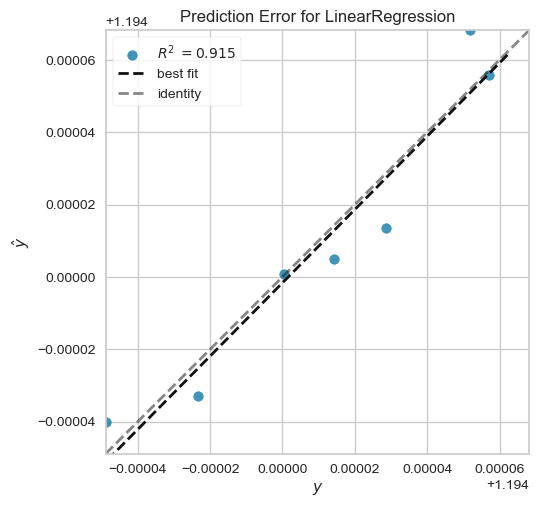

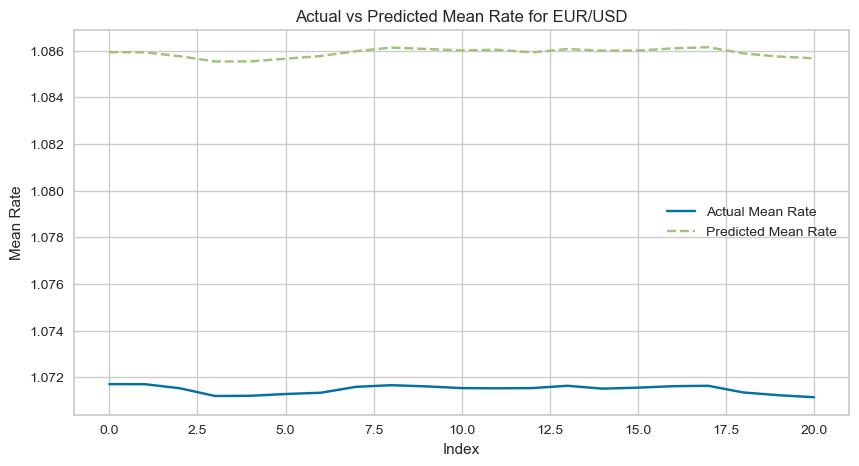

2024-04-29 22:31:49,386 - INFO - MSE for EUR/USD: 0.00020786532103842794


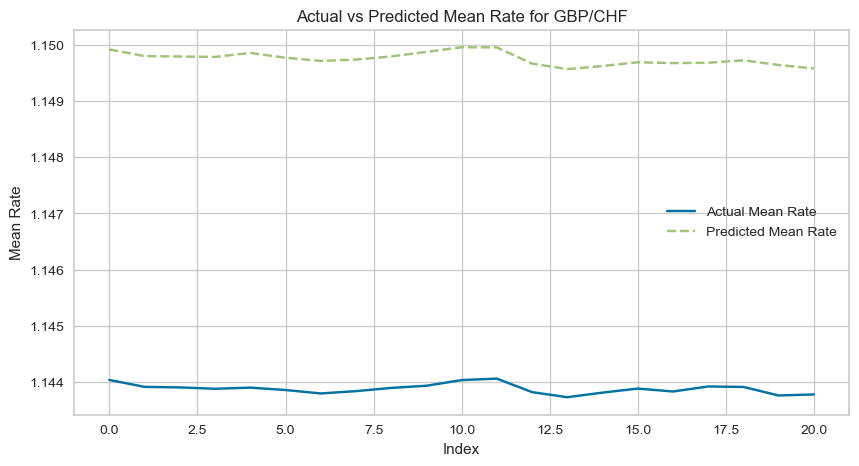

2024-04-29 22:31:49,621 - INFO - MSE for GBP/CHF: 3.4599064547630274e-05


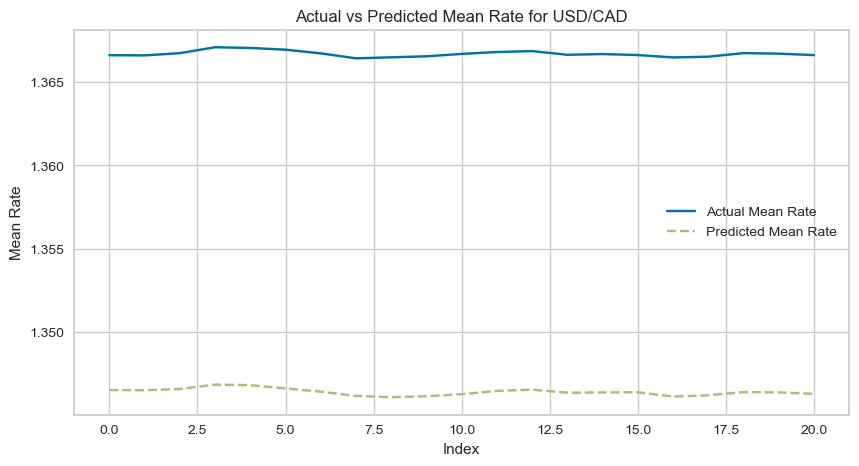

2024-04-29 22:31:49,851 - INFO - MSE for USD/CAD: 0.0004121033162733251
2024-04-29 22:31:49,852 - INFO - Label for GBP/CHF: FORECASTABLE
2024-04-29 22:31:49,852 - INFO - Label for EUR/USD: UNDEFINED
2024-04-29 22:31:49,853 - INFO - Label for USD/CAD: NON-FORECASTABLE
2024-04-29 22:31:50,706 - INFO - Retrieved EUR/USD: {'last': {'ask': 1.07042, 'bid': 1.07039, 'exchange': 48, 'timestamp': 1714444299000}, 'request_id': '3be5ecbe81fedd720b7f6d91773aa5ec', 'status': 'success', 'symbol': 'EUR/USD'}
2024-04-29 22:31:50,982 - INFO - Stored EUR/USD rate at 2024-04-29 22:31:50.707609: 1.070405
2024-04-29 22:31:51,241 - INFO - Retrieved GBP/CHF: {'last': {'ask': 1.14378, 'bid': 1.14363, 'exchange': 48, 'timestamp': 1714444310000}, 'request_id': '9b370f7a88e2650e5ac0e68f3c8b2cf4', 'status': 'success', 'symbol': 'GBP/CHF'}
2024-04-29 22:31:51,516 - INFO - Stored GBP/CHF rate at 2024-04-29 22:31:51.243187: 1.143705
2024-04-29 22:31:51,750 - INFO - Retrieved USD/CAD: {'last': {'ask': 1.36773, 'bid':

                           pair_name      rate
2024-04-29 22:31:22.161372   BTC/USD  63600.42
2024-04-29 22:31:56.706564   BTC/USD  63658.60
2024-04-29 22:32:04.171266   BTC/USD  63672.43
2024-04-29 22:32:12.084652   BTC/USD  63666.33
2024-04-29 22:32:21.716467   BTC/USD  63675.00
2024-04-29 22:32:29.723659   BTC/USD  63668.09
2024-04-29 22:32:37.651630   BTC/USD  63678.87
2024-04-29 22:32:44.864879   BTC/USD  63698.75
2024-04-29 22:32:52.112095   BTC/USD  63705.15
2024-04-29 22:32:59.436143   BTC/USD  63709.76
2024-04-29 22:33:07.376478   BTC/USD  63698.00
2024-04-29 22:33:15.140786   BTC/USD  63734.34
2024-04-29 22:33:22.727888   BTC/USD  63742.11
2024-04-29 22:33:29.826193   BTC/USD  63736.71
2024-04-29 22:33:37.276905   BTC/USD  63747.76
2024-04-29 22:33:44.980582   BTC/USD  63746.92
2024-04-29 22:33:53.404211   BTC/USD  63740.09
2024-04-29 22:34:01.408984   BTC/USD  63696.80
2024-04-29 22:34:09.275577   BTC/USD  63772.34
2024-04-29 22:34:16.968560   BTC/USD  63773.96
2024-04-29 22

2024-04-29 22:37:30,059 - INFO - Updated correlation for EUR/USD with EUR/USD: 1.0
2024-04-29 22:37:30,199 - INFO - Updated correlation for GBP/CHF with BTC/USD: 0.5606278503376776
2024-04-29 22:37:30,379 - INFO - Updated correlation for GBP/CHF with EUR/USD: 0.6379424258844733
2024-04-29 22:37:30,546 - INFO - Updated correlation for USD/CAD with BTC/USD: -0.7880838690209825
2024-04-29 22:37:30,734 - INFO - Updated correlation for USD/CAD with EUR/USD: -0.950736479280518
2024-04-29 22:37:30,881 - INFO - Updated correlation for EUR/CHF with BTC/USD: 0.9029494387567117
2024-04-29 22:37:31,050 - INFO - Updated correlation for EUR/CHF with EUR/USD: 0.8931150826426136
2024-04-29 22:37:31,212 - INFO - Updated correlation for EUR/CAD with BTC/USD: 0.8351555740079071
2024-04-29 22:37:31,348 - INFO - Updated correlation for EUR/CAD with EUR/USD: 0.8804038397524323
2024-04-29 22:37:31,514 - INFO - Updated correlation for GBP/EUR with BTC/USD: -0.8709731961357515
2024-04-29 22:37:31,662 - INFO - 

,Description,Value
0,Session id,123
1,Target,mean
2,Target type,Regression
3,Original data shape,"(21, 7)"
4,Transformed data shape,"(21, 7)"
5,Transformed train set shape,"(14, 7)"
6,Transformed test set shape,"(7, 7)"
7,Numeric features,6
8,Preprocess,True
9,Imputation type,simple


,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
lr,Linear Regression,0.0000,0.0000,0.0000,0.7703,0.0000,0.0000,1.1067
et,Extra Trees Regressor,0.0000,0.0000,0.0000,0.7319,0.0000,0.0000,0.0300
huber,Huber Regressor,0.0000,0.0000,0.0000,0.6692,0.0000,0.0000,0.0133
gbr,Gradient Boosting Regressor,0.0000,0.0000,0.0000,0.5677,0.0000,0.0000,0.0167
ada,AdaBoost Regressor,0.0000,0.0000,0.0000,0.3033,0.0000,0.0000,0.0200
rf,Random Forest Regressor,0.0000,0.0000,0.0001,0.1099,0.0000,0.0000,0.0400
dt,Decision Tree Regressor,0.0000,0.0000,0.0001,-0.1979,0.0000,0.0000,0.0067
lar,Least Angle Regression,0.0001,0.0000,0.0001,-1.3734,0.0000,0.0001,0.7900
lightgbm,Light Gradient Boosting Machine,0.0001,0.0000,0.0001,-1.5962,0.0000,0.0001,0.0133
lasso,Lasso Regression,0.0001,0.0000,0.0001,-1.5986,0.0000,0.0001,0.8300


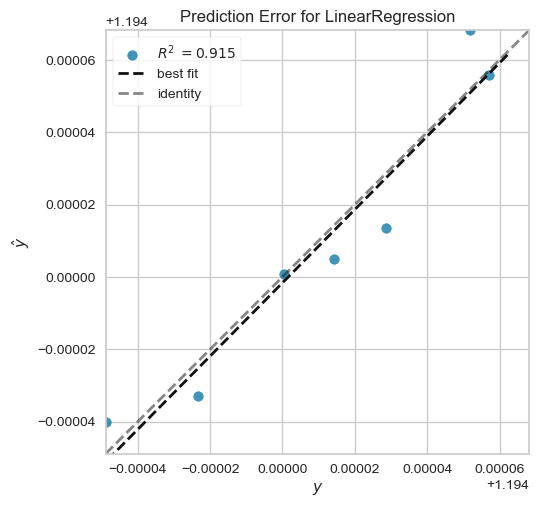

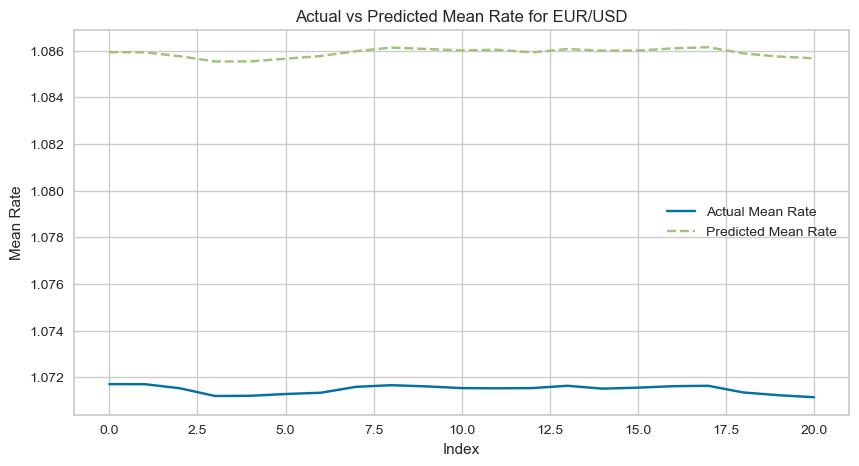

2024-04-29 22:37:53,434 - INFO - MSE for EUR/USD: 0.00020786532103842794


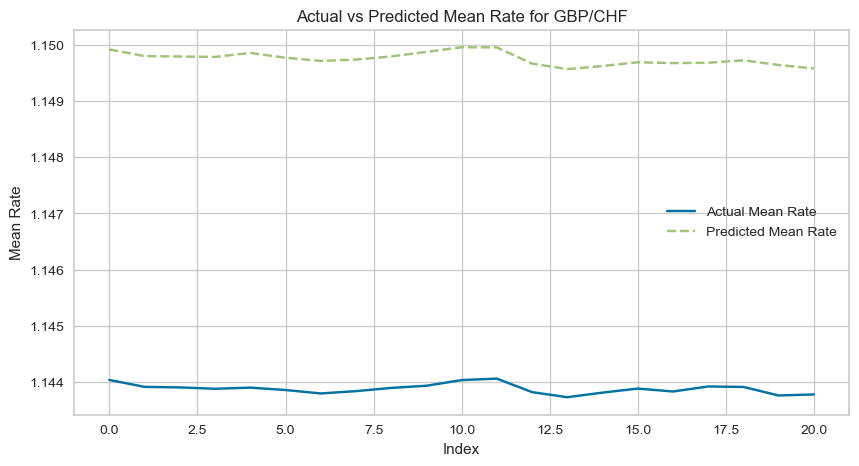

2024-04-29 22:37:53,690 - INFO - MSE for GBP/CHF: 3.4599064547630274e-05


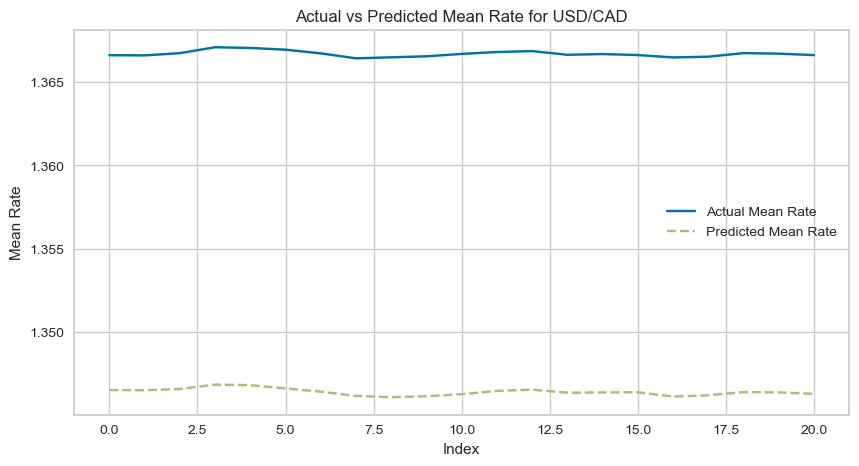

2024-04-29 22:37:53,943 - INFO - MSE for USD/CAD: 0.0004121033162733251
2024-04-29 22:37:53,944 - INFO - Label for GBP/CHF: FORECASTABLE
2024-04-29 22:37:53,944 - INFO - Label for EUR/USD: UNDEFINED
2024-04-29 22:37:53,944 - INFO - Label for USD/CAD: NON-FORECASTABLE
2024-04-29 22:37:54,770 - INFO - Retrieved EUR/USD: {'last': {'ask': 1.07057, 'bid': 1.07054, 'exchange': 48, 'timestamp': 1714444672000}, 'request_id': '675bc0058ba075b64a4f70b27881a030', 'status': 'success', 'symbol': 'EUR/USD'}
2024-04-29 22:37:55,036 - INFO - Stored EUR/USD rate at 2024-04-29 22:37:54.772425: 1.0705550000000001
2024-04-29 22:37:55,287 - INFO - Retrieved GBP/CHF: {'last': {'ask': 1.14401, 'bid': 1.14382, 'exchange': 48, 'timestamp': 1714444673000}, 'request_id': '181bfb8739c679892901f1891ee3e122', 'status': 'success', 'symbol': 'GBP/CHF'}
2024-04-29 22:37:55,553 - INFO - Stored GBP/CHF rate at 2024-04-29 22:37:55.289043: 1.143915
2024-04-29 22:37:55,794 - INFO - Retrieved USD/CAD: {'last': {'ask': 1.367

                           pair_name      rate
2024-04-29 22:37:26.440709   BTC/USD  63759.57
2024-04-29 22:38:00.511935   BTC/USD  63762.62
2024-04-29 22:38:07.724279   BTC/USD  63759.88
2024-04-29 22:38:15.396309   BTC/USD  63778.28
2024-04-29 22:38:22.908844   BTC/USD  63782.97
2024-04-29 22:38:31.010742   BTC/USD  63796.53
2024-04-29 22:38:38.176639   BTC/USD  63795.58
2024-04-29 22:38:45.714153   BTC/USD  63797.13
2024-04-29 22:38:53.258562   BTC/USD  63805.00
2024-04-29 22:39:00.897763   BTC/USD  63796.93
2024-04-29 22:39:08.377393   BTC/USD  63777.40
2024-04-29 22:39:15.657819   BTC/USD  63783.42
2024-04-29 22:39:23.055617   BTC/USD  63792.10
2024-04-29 22:39:30.567170   BTC/USD  63792.09
2024-04-29 22:39:38.487581   BTC/USD  63786.32
2024-04-29 22:39:46.022731   BTC/USD  63778.57
2024-04-29 22:39:53.760545   BTC/USD  63779.96
2024-04-29 22:40:02.136762   BTC/USD  63777.97
2024-04-29 22:40:09.890661   BTC/USD  63778.00
2024-04-29 22:40:17.832051   BTC/USD  63789.51
2024-04-29 22

2024-04-29 22:43:27,907 - INFO - Updated features for EUR/USD at 2024-04-29 22:43:21.153152
2024-04-29 22:43:28,073 - INFO - Updated correlation for EUR/USD with BTC/USD: 0.9003111551036398
2024-04-29 22:43:28,224 - INFO - Updated correlation for EUR/USD with EUR/USD: 1.0
2024-04-29 22:43:28,385 - INFO - Updated correlation for GBP/CHF with BTC/USD: 0.559520901805134
2024-04-29 22:43:28,548 - INFO - Updated correlation for GBP/CHF with EUR/USD: 0.5894167261699298
2024-04-29 22:43:28,716 - INFO - Updated correlation for USD/CAD with BTC/USD: -0.8146321683256532
2024-04-29 22:43:28,900 - INFO - Updated correlation for USD/CAD with EUR/USD: -0.9515301591319557
2024-04-29 22:43:29,074 - INFO - Updated correlation for EUR/CHF with BTC/USD: 0.904482744253252
2024-04-29 22:43:29,233 - INFO - Updated correlation for EUR/CHF with EUR/USD: 0.9313751551853835
2024-04-29 22:43:29,404 - INFO - Updated correlation for EUR/CAD with BTC/USD: 0.8540583289455516
2024-04-29 22:43:29,600 - INFO - Updated 

,Description,Value
0,Session id,123
1,Target,mean
2,Target type,Regression
3,Original data shape,"(21, 7)"
4,Transformed data shape,"(21, 7)"
5,Transformed train set shape,"(14, 7)"
6,Transformed test set shape,"(7, 7)"
7,Numeric features,6
8,Preprocess,True
9,Imputation type,simple


,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
lr,Linear Regression,0.0000,0.0000,0.0000,0.7703,0.0000,0.0000,1.0967
et,Extra Trees Regressor,0.0000,0.0000,0.0000,0.7319,0.0000,0.0000,0.0333
huber,Huber Regressor,0.0000,0.0000,0.0000,0.6692,0.0000,0.0000,0.0133
gbr,Gradient Boosting Regressor,0.0000,0.0000,0.0000,0.5677,0.0000,0.0000,0.0167
ada,AdaBoost Regressor,0.0000,0.0000,0.0000,0.3033,0.0000,0.0000,0.0200
rf,Random Forest Regressor,0.0000,0.0000,0.0001,0.1099,0.0000,0.0000,0.0367
dt,Decision Tree Regressor,0.0000,0.0000,0.0001,-0.1979,0.0000,0.0000,0.0067
lar,Least Angle Regression,0.0001,0.0000,0.0001,-1.3734,0.0000,0.0001,0.7967
lightgbm,Light Gradient Boosting Machine,0.0001,0.0000,0.0001,-1.5962,0.0000,0.0001,0.0133
lasso,Lasso Regression,0.0001,0.0000,0.0001,-1.5986,0.0000,0.0001,0.7933


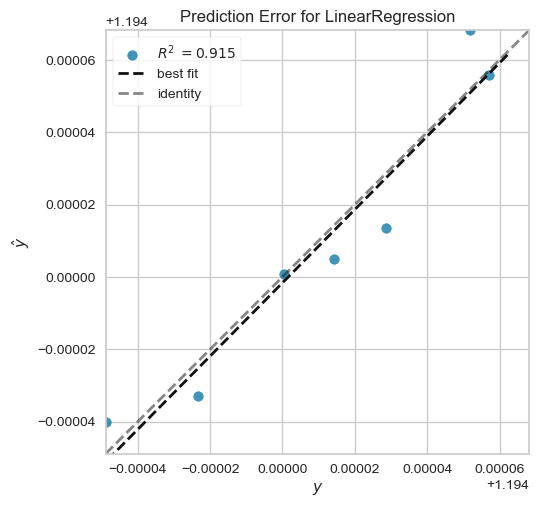

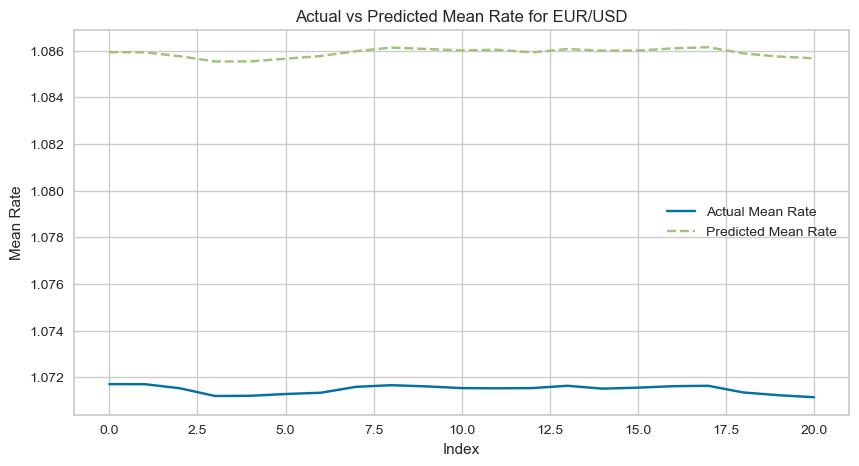

2024-04-29 22:43:51,914 - INFO - MSE for EUR/USD: 0.00020786532103842794


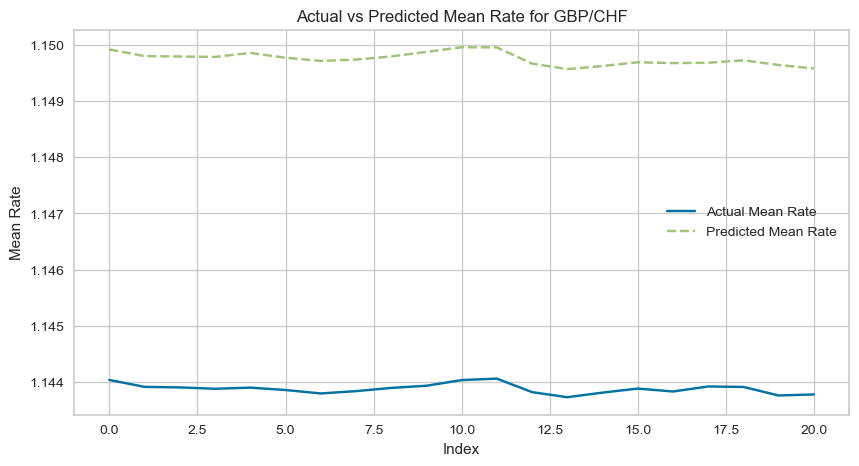

2024-04-29 22:43:52,162 - INFO - MSE for GBP/CHF: 3.4599064547630274e-05


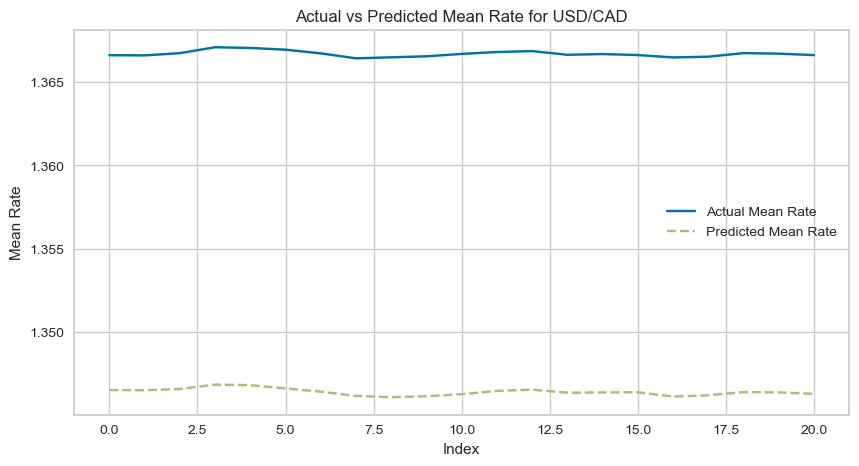

2024-04-29 22:43:52,399 - INFO - MSE for USD/CAD: 0.0004121033162733251
2024-04-29 22:43:52,399 - INFO - Label for GBP/CHF: FORECASTABLE
2024-04-29 22:43:52,399 - INFO - Label for EUR/USD: UNDEFINED
2024-04-29 22:43:52,400 - INFO - Label for USD/CAD: NON-FORECASTABLE
2024-04-29 22:43:53,186 - INFO - Retrieved EUR/USD: {'last': {'ask': 1.07048, 'bid': 1.07045, 'exchange': 48, 'timestamp': 1714445032000}, 'request_id': '5145e1e98eb25131220f5a6ced311268', 'status': 'success', 'symbol': 'EUR/USD'}
2024-04-29 22:43:53,486 - INFO - Stored EUR/USD rate at 2024-04-29 22:43:53.188209: 1.070465
2024-04-29 22:43:53,720 - INFO - Retrieved GBP/CHF: {'last': {'ask': 1.14387, 'bid': 1.14368, 'exchange': 48, 'timestamp': 1714445033000}, 'request_id': 'f472be65651d1f014547ddbc16a52c28', 'status': 'success', 'symbol': 'GBP/CHF'}
2024-04-29 22:43:54,022 - INFO - Stored GBP/CHF rate at 2024-04-29 22:43:53.722800: 1.143775
2024-04-29 22:43:54,256 - INFO - Retrieved USD/CAD: {'last': {'ask': 1.36773, 'bid':

                           pair_name      rate
2024-04-29 22:43:24.719486   BTC/USD  63794.23
2024-04-29 22:43:59.972100   BTC/USD  63842.00
2024-04-29 22:44:07.767597   BTC/USD  63815.59
2024-04-29 22:44:15.378712   BTC/USD  63824.70
2024-04-29 22:44:22.882248   BTC/USD  63779.60
2024-04-29 22:44:30.507066   BTC/USD  63793.49
2024-04-29 22:44:37.913501   BTC/USD  63792.47
2024-04-29 22:44:45.327011   BTC/USD  63793.81
2024-04-29 22:44:53.238449   BTC/USD  63791.19
2024-04-29 22:45:01.171351   BTC/USD  63785.52
2024-04-29 22:45:09.185556   BTC/USD  63807.16
2024-04-29 22:45:17.299477   BTC/USD  63796.10
2024-04-29 22:45:24.988145   BTC/USD  63785.21
2024-04-29 22:45:33.112044   BTC/USD  63779.04
2024-04-29 22:45:40.782122   BTC/USD  63799.72
2024-04-29 22:45:48.494988   BTC/USD  63777.12
2024-04-29 22:45:56.048400   BTC/USD  63761.28
2024-04-29 22:46:03.986191   BTC/USD  63767.80
2024-04-29 22:46:11.555493   BTC/USD  63777.44
2024-04-29 22:46:19.399660   BTC/USD  63777.38
2024-04-29 22

2024-04-29 22:49:29,367 - INFO - Updated correlation for EUR/USD with BTC/USD: 0.9077427076781254
2024-04-29 22:49:29,570 - INFO - Updated correlation for EUR/USD with EUR/USD: 1.0
2024-04-29 22:49:29,750 - INFO - Updated correlation for GBP/CHF with BTC/USD: 0.5746588892156912
2024-04-29 22:49:29,936 - INFO - Updated correlation for GBP/CHF with EUR/USD: 0.5730021318738666
2024-04-29 22:49:30,077 - INFO - Updated correlation for USD/CAD with BTC/USD: -0.7978936750874414
2024-04-29 22:49:30,253 - INFO - Updated correlation for USD/CAD with EUR/USD: -0.9460539505410763
2024-04-29 22:49:30,425 - INFO - Updated correlation for EUR/CHF with BTC/USD: 0.9036461504785561
2024-04-29 22:49:30,603 - INFO - Updated correlation for EUR/CHF with EUR/USD: 0.9439156434885387
2024-04-29 22:49:30,769 - INFO - Updated correlation for EUR/CAD with BTC/USD: 0.860386997492803
2024-04-29 22:49:30,953 - INFO - Updated correlation for EUR/CAD with EUR/USD: 0.8361852350312436
2024-04-29 22:49:31,133 - INFO - U

,Description,Value
0,Session id,123
1,Target,mean
2,Target type,Regression
3,Original data shape,"(21, 7)"
4,Transformed data shape,"(21, 7)"
5,Transformed train set shape,"(14, 7)"
6,Transformed test set shape,"(7, 7)"
7,Numeric features,6
8,Preprocess,True
9,Imputation type,simple


,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
lr,Linear Regression,0.0000,0.0000,0.0000,0.7703,0.0000,0.0000,1.1200
et,Extra Trees Regressor,0.0000,0.0000,0.0000,0.7319,0.0000,0.0000,0.0367
huber,Huber Regressor,0.0000,0.0000,0.0000,0.6692,0.0000,0.0000,0.0133
gbr,Gradient Boosting Regressor,0.0000,0.0000,0.0000,0.5677,0.0000,0.0000,0.0167
ada,AdaBoost Regressor,0.0000,0.0000,0.0000,0.3033,0.0000,0.0000,0.0200
rf,Random Forest Regressor,0.0000,0.0000,0.0001,0.1099,0.0000,0.0000,0.0433
dt,Decision Tree Regressor,0.0000,0.0000,0.0001,-0.1979,0.0000,0.0000,0.0100
lar,Least Angle Regression,0.0001,0.0000,0.0001,-1.3734,0.0000,0.0001,0.7900
lightgbm,Light Gradient Boosting Machine,0.0001,0.0000,0.0001,-1.5962,0.0000,0.0001,0.0133
lasso,Lasso Regression,0.0001,0.0000,0.0001,-1.5986,0.0000,0.0001,0.8900


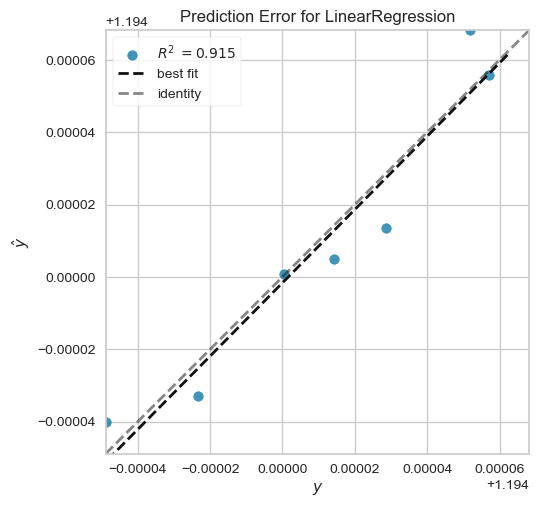

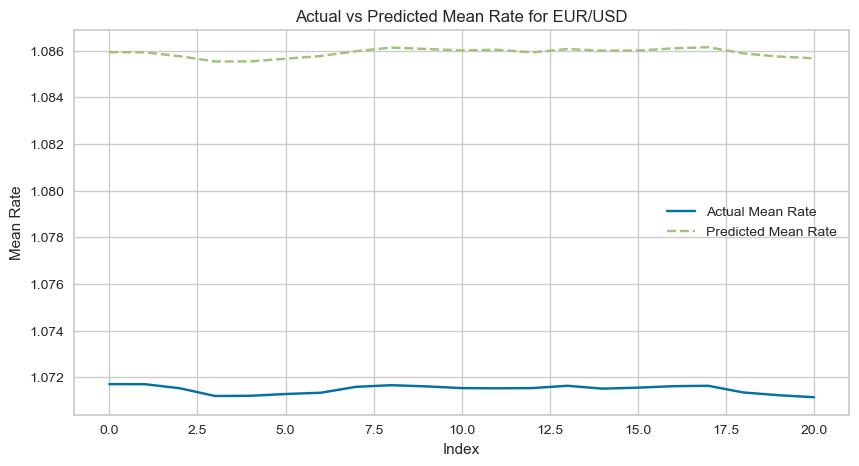

2024-04-29 22:49:53,418 - INFO - MSE for EUR/USD: 0.00020786532103842794


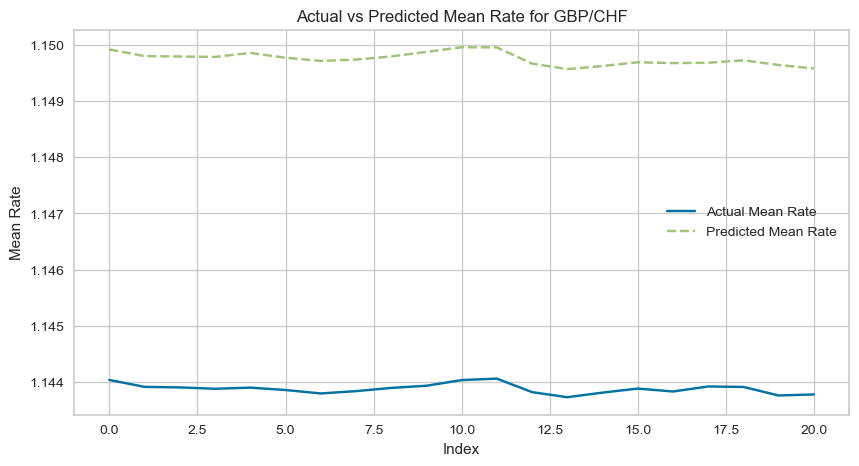

2024-04-29 22:49:53,674 - INFO - MSE for GBP/CHF: 3.4599064547630274e-05


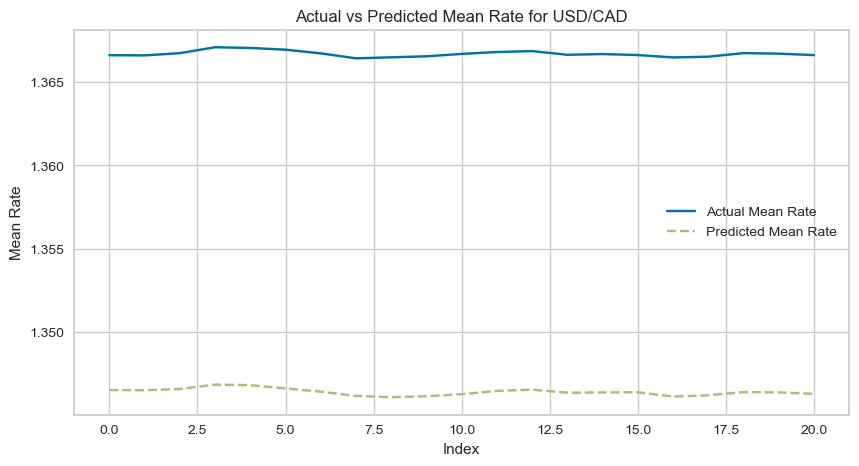

2024-04-29 22:49:53,922 - INFO - MSE for USD/CAD: 0.0004121033162733251
2024-04-29 22:49:53,923 - INFO - Label for GBP/CHF: FORECASTABLE
2024-04-29 22:49:53,923 - INFO - Label for EUR/USD: UNDEFINED
2024-04-29 22:49:53,923 - INFO - Label for USD/CAD: NON-FORECASTABLE


,Description,Value
0,Session id,123
1,Target,Forecastability
2,Target type,Multiclass
3,Target mapping,"FORECASTABLE: 0, NON-FORECASTABLE: 1, UNDEFINED: 2"
4,Original data shape,"(63, 9)"
5,Transformed data shape,"(63, 7)"
6,Transformed train set shape,"(44, 7)"
7,Transformed test set shape,"(19, 7)"
8,Ignore features,2
9,Numeric features,6


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
nb,Naive Bayes,1.0000,0.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.0060
dt,Decision Tree Classifier,1.0000,0.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.0050
rf,Random Forest Classifier,1.0000,0.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.0210
ada,Ada Boost Classifier,1.0000,0.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.0130
gbc,Gradient Boosting Classifier,1.0000,0.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.0240
lda,Linear Discriminant Analysis,1.0000,0.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.0050
et,Extra Trees Classifier,1.0000,0.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.0170
lr,Logistic Regression,0.8400,0.0000,0.8400,0.8308,0.8133,0.7510,0.7875,0.0080
ridge,Ridge Classifier,0.6850,0.0000,0.6850,0.5983,0.6083,0.5223,0.6003,0.0050
svm,SVM - Linear Kernel,0.6600,0.0000,0.6600,0.5696,0.5767,0.4781,0.5611,0.0070


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Naive Bayes,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000


Classification percentages for EUR/CHF:prediction_label
FORECASTABLE    87.096774
UNDEFINED       12.903226
Name: proportion, dtype: float64
Classification percentages for EUR/CAD:prediction_label
NON-FORECASTABLE    100.0
Name: proportion, dtype: float64
Classification percentages for GBP/EUR:prediction_label
FORECASTABLE    100.0
Name: proportion, dtype: float64
Classification percentages for GBP/USD:prediction_label
NON-FORECASTABLE    100.0
Name: proportion, dtype: float64
Classification percentages for GBP/CAD:prediction_label
NON-FORECASTABLE    100.0
Name: proportion, dtype: float64
Classification percentages for USD/CHF:prediction_label
FORECASTABLE    100.0
Name: proportion, dtype: float64
Classification percentages for USD/JPY:prediction_label
UNDEFINED    100.0
Name: proportion, dtype: float64


,Description,Value
0,Session id,123
1,Target,rate
2,Target type,Regression
3,Original data shape,"(2639, 3)"
4,Transformed data shape,"(2639, 2)"
5,Transformed train set shape,"(1847, 2)"
6,Transformed test set shape,"(792, 2)"
7,Ignore features,1
8,Numeric features,1
9,Preprocess,True


,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,0.0002,0.0000,0.0002,0.8213,0.0001,0.0001
1,0.0002,0.0000,0.0002,0.8035,0.0001,0.0002
2,0.0002,0.0000,0.0002,0.8117,0.0001,0.0002
3,0.0002,0.0000,0.0002,0.8156,0.0001,0.0001
4,0.0002,0.0000,0.0002,0.8387,0.0001,0.0001
5,0.0002,0.0000,0.0002,0.7803,0.0001,0.0002
6,0.0002,0.0000,0.0002,0.8133,0.0001,0.0002
7,0.0002,0.0000,0.0002,0.8420,0.0001,0.0001
8,0.0002,0.0000,0.0002,0.8139,0.0001,0.0001


,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,Linear Regression,0.0002,0.0000,0.0002,0.8183,0.0001,0.0001


,Description,Value
0,Session id,123
1,Target,rate
2,Target type,Regression
3,Original data shape,"(2639, 3)"
4,Transformed data shape,"(2639, 2)"
5,Transformed train set shape,"(1847, 2)"
6,Transformed test set shape,"(792, 2)"
7,Ignore features,1
8,Numeric features,1
9,Preprocess,True


,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,0.0009,0.0000,0.0011,0.8182,0.0004,0.0006
1,0.0009,0.0000,0.0011,0.8139,0.0004,0.0006
2,0.0009,0.0000,0.0011,0.8101,0.0004,0.0006
3,0.0010,0.0000,0.0011,0.7969,0.0004,0.0006
4,0.0009,0.0000,0.0011,0.8224,0.0004,0.0006
5,0.0009,0.0000,0.0012,0.7873,0.0004,0.0006
6,0.0010,0.0000,0.0012,0.8035,0.0005,0.0006
7,0.0009,0.0000,0.0011,0.8158,0.0004,0.0006
8,0.0009,0.0000,0.0011,0.8005,0.0004,0.0006


,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,Linear Regression,0.0010,0.0000,0.0011,0.7981,0.0004,0.0006


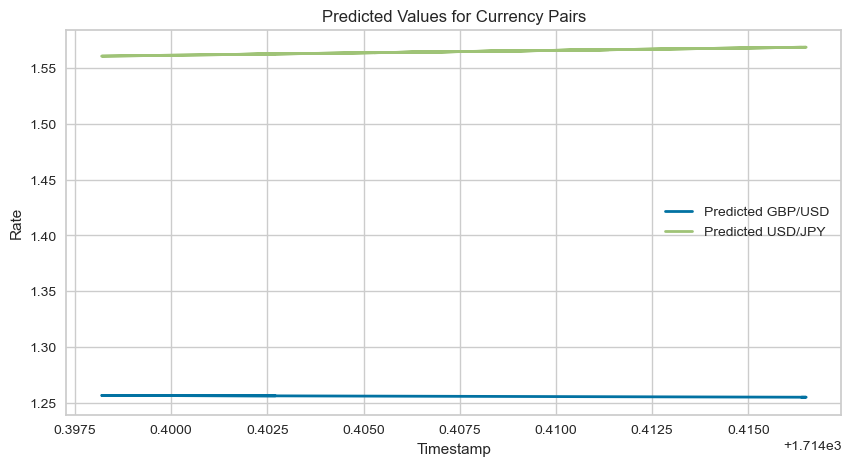

2024-04-29 22:50:03,081 - INFO - long USD/JPY and short GBP/USD
2024-04-29 22:50:03,334 - INFO - Retrieved EUR/USD: {'last': {'ask': 1.0705, 'bid': 1.07047, 'exchange': 48, 'timestamp': 1714445402000}, 'request_id': '5f26a7f08f1e324e997a056376ec6f4f', 'status': 'success', 'symbol': 'EUR/USD'}
2024-04-29 22:50:03,607 - INFO - Stored EUR/USD rate at 2024-04-29 22:50:03.336005: 1.0704850000000001
2024-04-29 22:50:03,838 - INFO - Retrieved GBP/CHF: {'last': {'ask': 1.14413, 'bid': 1.14394, 'exchange': 48, 'timestamp': 1714445403000}, 'request_id': '15b3f86dcc70a443fd2bc36829bc5bb7', 'status': 'success', 'symbol': 'GBP/CHF'}
2024-04-29 22:50:04,110 - INFO - Stored GBP/CHF rate at 2024-04-29 22:50:03.839659: 1.1440350000000001
2024-04-29 22:50:04,391 - INFO - Retrieved USD/CAD: {'last': {'ask': 1.3683, 'bid': 1.3678, 'exchange': 48, 'timestamp': 1714445402000}, 'request_id': 'f97d0c2b579993cbb80b6958d9b28e9b', 'status': 'success', 'symbol': 'USD/CAD'}
2024-04-29 22:50:04,668 - INFO - Stored 

                           pair_name      rate
2024-04-29 22:49:26.070338   BTC/USD  63835.58
2024-04-29 22:50:09.405773   BTC/USD  63862.00
2024-04-29 22:50:16.929225   BTC/USD  63756.09
2024-04-29 22:50:24.266727   BTC/USD  63772.30
2024-04-29 22:50:32.054518   BTC/USD  63757.84
2024-04-29 22:50:39.711273   BTC/USD  63764.34
2024-04-29 22:50:47.709388   BTC/USD  63761.99
2024-04-29 22:50:55.946930   BTC/USD  63760.78
2024-04-29 22:51:03.536252   BTC/USD  63759.00
2024-04-29 22:51:11.070611   BTC/USD  63760.10
2024-04-29 22:51:18.374588   BTC/USD  63756.58
2024-04-29 22:51:25.871099   BTC/USD  63757.00
2024-04-29 22:51:33.404525   BTC/USD  63760.10
2024-04-29 22:51:40.665611   BTC/USD  63774.28
2024-04-29 22:51:48.115192   BTC/USD  63794.38
2024-04-29 22:51:55.588807   BTC/USD  63790.67
2024-04-29 22:52:03.938979   BTC/USD  63789.75
2024-04-29 22:52:11.696574   BTC/USD  63776.00
2024-04-29 22:52:19.316738   BTC/USD  63783.41
2024-04-29 22:52:27.711845   BTC/USD  63802.33
2024-04-29 22

2024-04-29 22:55:29,021 - INFO - Updated correlation for EUR/USD with BTC/USD: 0.9037213248826815
2024-04-29 22:55:29,190 - INFO - Updated correlation for EUR/USD with EUR/USD: 1.0
2024-04-29 22:55:29,340 - INFO - Updated correlation for GBP/CHF with BTC/USD: 0.4105939722631729
2024-04-29 22:55:29,515 - INFO - Updated correlation for GBP/CHF with EUR/USD: 0.32617031248937506
2024-04-29 22:55:29,666 - INFO - Updated correlation for USD/CAD with BTC/USD: -0.777949277118629
2024-04-29 22:55:29,841 - INFO - Updated correlation for USD/CAD with EUR/USD: -0.9401112058321381
2024-04-29 22:55:29,998 - INFO - Updated correlation for EUR/CHF with BTC/USD: 0.8811176947358124
2024-04-29 22:55:30,149 - INFO - Updated correlation for EUR/CHF with EUR/USD: 0.8949916206534873
2024-04-29 22:55:30,299 - INFO - Updated correlation for EUR/CAD with BTC/USD: 0.8393204899747564
2024-04-29 22:55:30,449 - INFO - Updated correlation for EUR/CAD with EUR/USD: 0.7873244881242906
2024-04-29 22:55:30,607 - INFO - 

,Description,Value
0,Session id,123
1,Target,mean
2,Target type,Regression
3,Original data shape,"(21, 7)"
4,Transformed data shape,"(21, 7)"
5,Transformed train set shape,"(14, 7)"
6,Transformed test set shape,"(7, 7)"
7,Numeric features,6
8,Preprocess,True
9,Imputation type,simple


,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
lr,Linear Regression,0.0000,0.0000,0.0000,0.7703,0.0000,0.0000,1.1000
et,Extra Trees Regressor,0.0000,0.0000,0.0000,0.7319,0.0000,0.0000,0.0300
huber,Huber Regressor,0.0000,0.0000,0.0000,0.6692,0.0000,0.0000,0.0133
gbr,Gradient Boosting Regressor,0.0000,0.0000,0.0000,0.5677,0.0000,0.0000,0.0167
ada,AdaBoost Regressor,0.0000,0.0000,0.0000,0.3033,0.0000,0.0000,0.0267
rf,Random Forest Regressor,0.0000,0.0000,0.0001,0.1099,0.0000,0.0000,0.0367
dt,Decision Tree Regressor,0.0000,0.0000,0.0001,-0.1979,0.0000,0.0000,0.0100
lar,Least Angle Regression,0.0001,0.0000,0.0001,-1.3734,0.0000,0.0001,0.8233
lightgbm,Light Gradient Boosting Machine,0.0001,0.0000,0.0001,-1.5962,0.0000,0.0001,0.0133
lasso,Lasso Regression,0.0001,0.0000,0.0001,-1.5986,0.0000,0.0001,0.7933


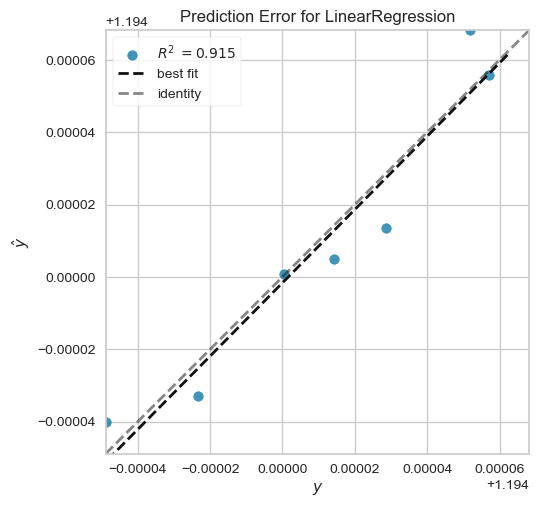

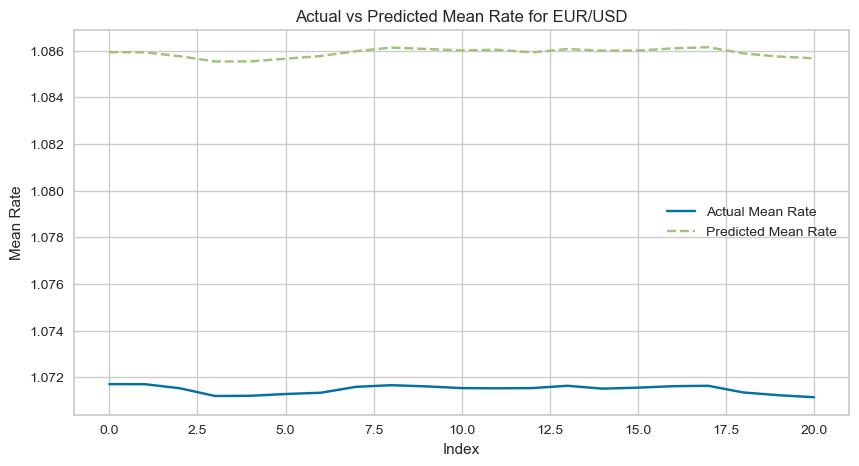

2024-04-29 22:55:52,667 - INFO - MSE for EUR/USD: 0.00020786532103842794


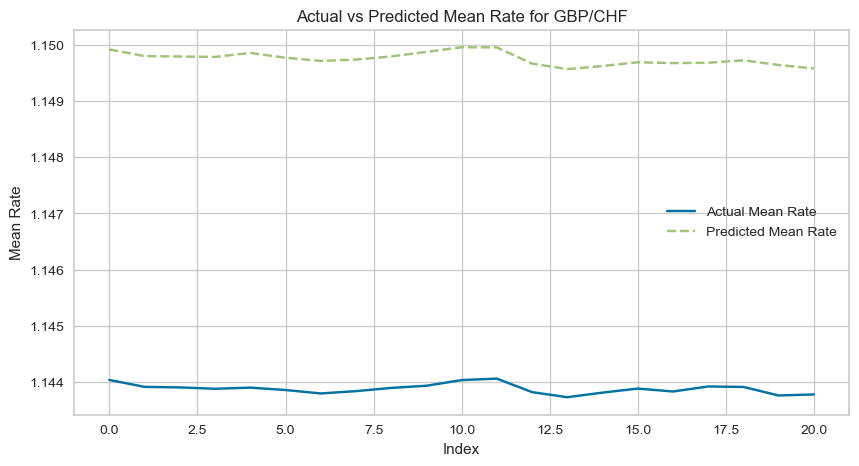

2024-04-29 22:55:52,927 - INFO - MSE for GBP/CHF: 3.4599064547630274e-05


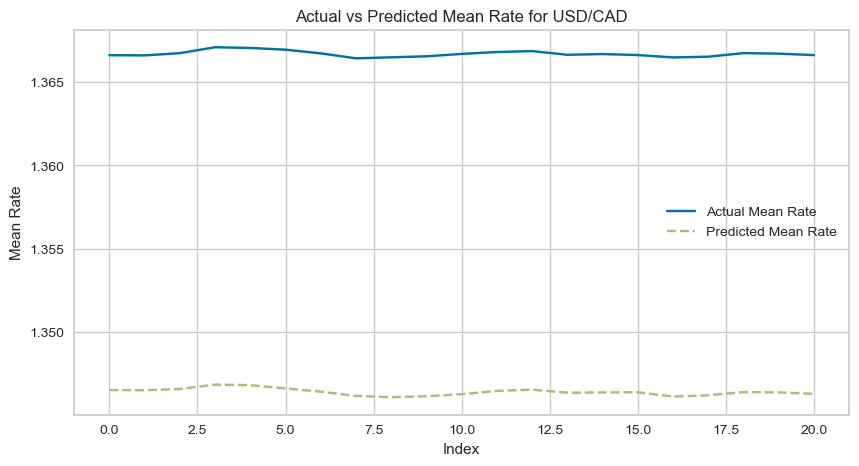

2024-04-29 22:55:53,168 - INFO - MSE for USD/CAD: 0.0004121033162733251
2024-04-29 22:55:53,169 - INFO - Label for GBP/CHF: FORECASTABLE
2024-04-29 22:55:53,170 - INFO - Label for EUR/USD: UNDEFINED
2024-04-29 22:55:53,170 - INFO - Label for USD/CAD: NON-FORECASTABLE


,Description,Value
0,Session id,123
1,Target,Forecastability
2,Target type,Multiclass
3,Target mapping,"FORECASTABLE: 0, NON-FORECASTABLE: 1, UNDEFINED: 2"
4,Original data shape,"(63, 9)"
5,Transformed data shape,"(63, 7)"
6,Transformed train set shape,"(44, 7)"
7,Transformed test set shape,"(19, 7)"
8,Ignore features,2
9,Numeric features,6


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
nb,Naive Bayes,1.0000,0.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.0060
dt,Decision Tree Classifier,1.0000,0.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.0060
rf,Random Forest Classifier,1.0000,0.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.0210
ada,Ada Boost Classifier,1.0000,0.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.0130
gbc,Gradient Boosting Classifier,1.0000,0.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.0240
lda,Linear Discriminant Analysis,1.0000,0.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.0050
et,Extra Trees Classifier,1.0000,0.0000,1.0000,1.0000,1.0000,1.0000,1.0000,0.0180
lr,Logistic Regression,0.8400,0.0000,0.8400,0.8308,0.8133,0.7510,0.7875,0.0080
ridge,Ridge Classifier,0.6850,0.0000,0.6850,0.5983,0.6083,0.5223,0.6003,0.0060
svm,SVM - Linear Kernel,0.6600,0.0000,0.6600,0.5696,0.5767,0.4781,0.5611,0.0070


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Naive Bayes,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000


Classification percentages for EUR/CHF:prediction_label
FORECASTABLE    87.096774
UNDEFINED       12.903226
Name: proportion, dtype: float64
Classification percentages for EUR/CAD:prediction_label
NON-FORECASTABLE    100.0
Name: proportion, dtype: float64
Classification percentages for GBP/EUR:prediction_label
FORECASTABLE    100.0
Name: proportion, dtype: float64
Classification percentages for GBP/USD:prediction_label
NON-FORECASTABLE    100.0
Name: proportion, dtype: float64
Classification percentages for GBP/CAD:prediction_label
NON-FORECASTABLE    100.0
Name: proportion, dtype: float64
Classification percentages for USD/CHF:prediction_label
FORECASTABLE    100.0
Name: proportion, dtype: float64
Classification percentages for USD/JPY:prediction_label
UNDEFINED    100.0
Name: proportion, dtype: float64


,Description,Value
0,Session id,123
1,Target,rate
2,Target type,Regression
3,Original data shape,"(2681, 3)"
4,Transformed data shape,"(2681, 2)"
5,Transformed train set shape,"(1876, 2)"
6,Transformed test set shape,"(805, 2)"
7,Ignore features,1
8,Numeric features,1
9,Preprocess,True


,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,0.0002,0.0000,0.0002,0.8398,0.0001,0.0001
1,0.0002,0.0000,0.0002,0.8231,0.0001,0.0001
2,0.0002,0.0000,0.0002,0.8093,0.0001,0.0002
3,0.0002,0.0000,0.0002,0.8136,0.0001,0.0002
4,0.0002,0.0000,0.0002,0.8422,0.0001,0.0001
5,0.0002,0.0000,0.0002,0.8224,0.0001,0.0001
6,0.0002,0.0000,0.0002,0.8291,0.0001,0.0001
7,0.0002,0.0000,0.0002,0.8486,0.0001,0.0001
8,0.0002,0.0000,0.0002,0.8265,0.0001,0.0001


,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,Linear Regression,0.0002,0.0000,0.0002,0.8189,0.0001,0.0001


,Description,Value
0,Session id,123
1,Target,rate
2,Target type,Regression
3,Original data shape,"(2681, 3)"
4,Transformed data shape,"(2681, 2)"
5,Transformed train set shape,"(1876, 2)"
6,Transformed test set shape,"(805, 2)"
7,Ignore features,1
8,Numeric features,1
9,Preprocess,True


,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,0.0010,0.0000,0.0012,0.8131,0.0005,0.0006
1,0.0010,0.0000,0.0011,0.7944,0.0004,0.0006
2,0.0010,0.0000,0.0011,0.7862,0.0004,0.0006
3,0.0009,0.0000,0.0011,0.8018,0.0004,0.0006
4,0.0009,0.0000,0.0011,0.8164,0.0004,0.0006
5,0.0010,0.0000,0.0012,0.7909,0.0005,0.0006
6,0.0010,0.0000,0.0012,0.7847,0.0005,0.0007
7,0.0009,0.0000,0.0011,0.8188,0.0004,0.0006
8,0.0010,0.0000,0.0011,0.8050,0.0004,0.0006


,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,Linear Regression,0.0009,0.0000,0.0011,0.8109,0.0004,0.0006


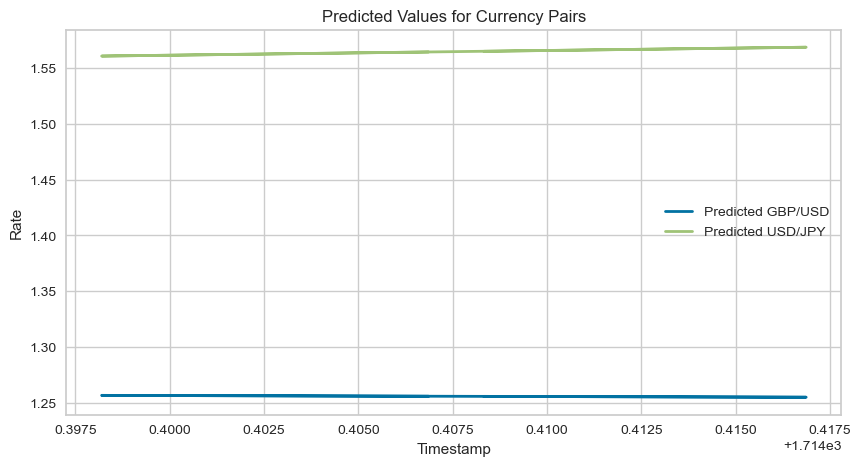

2024-04-29 22:56:02,331 - INFO - long USD/JPY and short GBP/USD


In [31]:
start_time = datetime.now()
end_time = start_time + timedelta(hours=5, minutes=12)
feature_interval = timedelta(minutes=6)
next_feature_time = start_time + feature_interval
correlation_start_time = start_time + timedelta(hours=2, minutes=6)
correlation_interval = timedelta(hours=2)
regression_time = start_time + timedelta(hours=4, minutes=6)
classification_time = start_time + timedelta(hours=5, minutes=6)

###Raw data retreiving
while datetime.now() <= end_time:
    for pair in base_cps + class_cps + [exogenous[1]]:
        data = fetch_data(pair)
        rate = (data['last']['ask'] + data['last']['bid']) / 2
        store_data(pair, rate, datetime.now())
   
    for pair in [exogenous[0]]:
        data = fetch_data_exo(pair)
        rate = data['last']['price']
        store_data(pair, rate, datetime.now())
    #the first two for loops are intended to continously store data within the entire processing time
    time.sleep(1)

    ###Extract Features
    if datetime.now() >= next_feature_time:
        logging.info(f"Starting feature aggregation for all pairs at {next_feature_time}")
        for pair in base_cps + class_cps:
            data = currency_lib.read(pair, date_range=(next_feature_time - feature_interval,next_feature_time)).data
            #At the end of each 6-minute window, read and process the stored data from the previous 6 minutes.
            rates = data['rate']
            max_rate = max(rates)
            min_rate = min(rates)
            mean_rate = np.mean(rates)
            vol = (max_rate - min_rate) / mean_rate if mean_rate != 0 else 0            
            try:
                prev_vol_data = currency_feature_lib.read(pair, date_range=(next_feature_time - feature_interval, next_feature_time - timedelta(seconds=1))).data
                prev_vol = prev_vol_data['vol'].iloc[-1] if not prev_vol_data.empty else 0
                #Locate the last volatility; if it's the first 6-minute group and no previous volatility exists, set pre_vol to 0.
            except (KeyError, IndexError, TypeError, NoSuchVersionException):
                prev_vol = 0
                # Since the first 6-minute group has no entry of previous volatility,iloc[-1] might trigger an error message
                # In such scenarios, assign prev_vol = 0.
            band_width = 0.025 * prev_vol            
            if band_width != 0:
                fd = sum(abs(r - prev_r)/band_width for r, prev_r in zip(rates[1:], rates[:-1])) / (max_rate - min_rate) / 100000 if (max_rate - min_rate) != 0 else 0
                #rates[1:] creates a list from the second element to the last element of rates.
                #rates[:-1] creates a list from the first element to the second-to-last element of rates.
                #zip() function takes these two lists and pairs them, resulting in pairs of (current rate, previous rate). 
                #This is used to accumulate number of crosses within this 6-minutes window
                #/100,000 is to normolizing FD, making it more intuiative for pair and pair comparison
                # It also enhances comprehension of the oscillation.
            else:
                fd = 0
                
            features_df = pd.DataFrame({
            'pair':[pair],
            'max': [max_rate],
            'min': [min_rate],
            'mean': [mean_rate],
            'vol': [vol],
            'fd': [fd]
            }, index=[pd.Timestamp(next_feature_time)]) 
            currency_feature_lib.append(pair, features_df)
            logging.info(f"Updated features for {pair} at {next_feature_time}")

        ###6-mins mean rate of exogenous data
        for exog in exogenous:
            exog_data = currency_lib.read(exog, date_range=(next_feature_time - feature_interval,next_feature_time)).data
            print(exog_data)
            rates = exog_data['rate']
            mean_exog_rate = np.mean(rates)

            
            df_exo = pd.DataFrame({'pair':[exog],
                                   'rate': [mean_exog_rate]
                                  }, index=[pd.Timestamp(next_feature_time)])
            exogenous_lib.update(exog,df_exo,upsert=True)
            #Since we are interested only in the mean rate of exogenous data, not its features,
            #the schema structure differs from the 6-minute feature groups of CPs.
            #For data integrity and clarity, this data is stored in a separate library.

            logging.info(f"Updated features for {exog} at {next_feature_time}")

        ###Correlation computation
        #trigger evey 6 mins after the correlation start time
        if datetime.now() >= correlation_start_time:
            for pair in base_cps + class_cps:
                base_rates = [item for item in currency_feature_lib.read(pair, date_range=(next_feature_time - correlation_interval, next_feature_time)).data['mean']]
                #This list comprehension collects data for correlation computation. For each 6-minute window starting from 'correlation_start_time',
                #it retrieves the previous 20 mean currency rates. The rates are stored in the list 'base_rates' which is used as input for correlation analysis.
                #The 'next_feature_time' is updated dynamically to continually adjust the data fetching window.
                for exog in exogenous:
                    exog_rates = [item for item in exogenous_lib.read(exog, date_range=(next_feature_time - correlation_interval, next_feature_time)).data['rate']]
                    correlation = np.corrcoef(base_rates, exog_rates)[0, 1] #top right of correlation matrix
                    df_feature = currency_feature_lib.read(pair, date_range=(next_feature_time - timedelta(seconds=1), next_feature_time + timedelta(seconds=1))).data
                    #read the feature data at the nex_feature_time explicitly, to +/- 1 seconds is make sure the inclusive of data at this next feature time
                    df_feature[f'correlation_with_{exog}'] = correlation
                    currency_feature_lib.update(pair,df_feature,upsert=True)
                    #lib.update, is used to modify existing records and add new records (here is to add the correlation column)
                    #upset=True, this operation should insert new record if one does not already exist for the given key (pair)
                    logging.info(f"Updated correlation for {pair} with {exog}: {correlation}")        
            #Correlation computation occurs once 20 data points are gathered. The correlation is calculated between each combination of control points (CPs) and exogenous objects. 
            #Using nested loops (i, j) is the optimized approach for handling the pairwise computations efficiently. 
            #This ensures each possible pair is considered for correlation analysis without redundant calculations. 
        next_feature_time += feature_interval
        #updating the next_feature_time 

        ###Regression on aggregate feature data of base CPs
        if datetime.now() >= regression_time: #just trigger once
            start = regression_time - correlation_interval
            end = regression_time
            aggregated_data = aggregate_data(base_cps, start, end)
            insert_aggregated_data_to_regression_lib(aggregated_data)
            df = regression_lib.read('aggregated_base_cps').data
            experiment = setup(df,
                               target='mean',
                              fold=3,
                              session_id=123)
            best = compare_models()
            plot_model(best, plot = 'error')
            
            ##Manually assign the labels based on MSE
            predictions ={}
            mse_scores ={}
            for pair in base_cps:
                base_data = currency_feature_lib.read(pair,date_range=(regression_time - correlation_interval, regression_time)).data
                features = base_data[['vol','fd','max','min','correlation_with_BTC/USD','correlation_with_EUR/USD']]
                results = predict_model(best, data=features)
                predictions[pair] = results
                
                predicted_mean_rate = results['prediction_label']
                actual_mean_rate = base_data['mean']
                
                mse = mean_squared_error(actual_mean_rate, predicted_mean_rate)
                #the sklearn package of computing mse score
                mse_scores[pair] = mse
                
                plt.figure(figsize=(10, 5))
                plt.plot(actual_mean_rate.reset_index(drop=True), label='Actual Mean Rate')
                #drop the datetime index for ensure the consistency and for easily to be visualized
                plt.plot(predicted_mean_rate.reset_index(drop=True), label='Predicted Mean Rate', linestyle='--')
                plt.title(f'Actual vs Predicted Mean Rate for {pair}')
                plt.xlabel('Index')
                plt.ylabel('Mean Rate')
                plt.legend()
                plt.show()

                logging.info(f"MSE for {pair}: {mse}")
            
            sorted_pairs = sorted(mse_scores, key=mse_scores.get)
            #sort function is to sort the key by default
            #thus, we use dictionary.get to fetch the value corresponding the key
            #and sort on the value directly
            labels = {sorted_pairs[0]: 'FORECASTABLE',  # Best performance
                      sorted_pairs[1]: 'UNDEFINED',  # Middle performance
                      sorted_pairs[2]: 'NON-FORECASTABLE'  # Worst performance
                     }
            
            for pair, label in labels.items(): #dic.items returns a list of dictionary's key-value tuple pairs
                logging.info(f"Label for {pair}: {label}")
            
            for pair in base_cps:
                base_data = currency_feature_lib.read(pair, date_range=(regression_time - correlation_interval, regression_time)).data
                base_data['Forecastability'] = labels[pair]
                classification_lib.write(pair, base_data) #write data into a new library for preparation of classificaiton
        
        ###Classification part                
        if datetime.now() >= classification_time: #just trigger once
            start = regression_time - correlation_interval
            end = classification_time
            df_class = class_base_data(base_cps, start, end)
            #aggregate all pairs into one dataframe
            df_class.reset_index(drop=True, inplace=True)
            #since there are duplicated datetime index, which is not compatible for pycaret
            #rest index to default integr index
            #drop=true, is to instruct it not to insert the old index as a column, instead discard it
            #inplace=ture, is to modify the existing one, not return a new dataframe
            experiment = setup_class(df_class,
                         target='Forecastability',
                         ignore_features=['pair','mean'],
                         session_id=123)
    
            best = compare_models_class()
            predict_model_class(best)

            ##Classify the class_cps
            predictions={} #create a dictionary to hold the results of prediction_label of each class_cps
            for pair in class_cps:
                class_data = currency_feature_lib.read(pair, date_range=(correlation_start_time, classification_time)).data
                features = class_data[['vol','fd','max','min','correlation_with_BTC/USD','correlation_with_EUR/USD']]
                result_df = predict_model_class(best, data=features)                
                prediction_counts = result_df['prediction_label'].value_counts(normalize=True) * 100
                #value_counts is applied to prediction_label and returns a series containing unique values as index
                #and counts value, useful to quickly understading the distribution of categories
                #normalize=True, retruns the relative freqency, since i would like to know percentage of each unique lables of each pairs
                predictions[pair] = prediction_counts
                
            for pair, counts in predictions.items():
                print(f"Classification percentages for {pair}:{counts}")
                
            ##Long-short strategy
            #identify which to long and which to short by comparison of their coefficients
            all_predictions = []
            coeff = {}
            formula  = {}
            for pair in Trade_cps:
                df = currency_lib.read(pair).data #read all rates collected of each trade pairs
                df.reset_index(inplace=True)
                df.rename(columns={'index':'timestamp'},inplace=True)
                df['timestamp'] = df['timestamp'] - timedelta(hours=4)
                df['timestamp'] = df['timestamp'].apply(lambda x: x.timestamp()/1000000)
                #Run regression on its time factors, so I need convert the datetime to numerical timestamp
                #And divide 1,000,000 to normalize its scale 
    
                if pair == "USD/JPY":
                    df['rate'] = df['rate'] / 100
    
                experiment = setup(df,
                              target='rate',
                              ignore_features=['pair_name'],
                              session_id=123)
                model = create_model('lr') #using linear regression 
                coeff[pair] = model.coef_[0] #access the first element of the coef arry, which should be a 1D array
                formula[pair] = f'y = {model.coef_[0]}x + {model.intercept_}'
                predictions = predict_model(model)
                predictions['pair'] = pair  # Track currency pair with its predictions
                all_predictions.append(predictions)

                final_predictions = pd.concat(all_predictions)
                #concatenate all predictions into one dataset for plotting them into 1 graph

            plt.figure(figsize=(10, 5))

            ##plot subset data into one graph for pair-waise comparison
            for pair in Trade_cps:
                subset = final_predictions[final_predictions['pair'] == pair]
                plt.plot(subset['timestamp'], subset['prediction_label'], label=f'Predicted {pair}', linewidth=2)

            plt.title('Predicted Values for Currency Pairs')
            plt.xlabel('Timestamp')
            plt.ylabel('Rate')
            plt.legend()
            plt.show()
            
            
            long_cp = max(coeff, key=coeff.get)
            short_cp = min(coeff, key=coeff.get)
            logging.info(f'long {long_cp} and short {short_cp}')

In [32]:
###Trading part, is executed seamlessly after the end of previous running time
trade_start = datetime.now()
trade_end = trade_start + timedelta(hours=3)
reinvestment_interval = timedelta(hours=1)
reinvestment_time = trade_start + reinvestment_interval
reinvestment_count = 0 
rate = {}
active_reinvestments = [] 
first_short_cp_rate = None
first_long_cp_rate = None
#purpose of holding the first long and short rate for computing holding position
#since the L-S ratio at the started should be 1, and the formula of L-S ratio is
#(long_rate*long_position) / (short_rate*short_position)
#long_position should equal to short_rate and vice versa to cancel out each other
#that makes the L-S ratio equal to 1

while datetime.now() <= trade_end:
    for pair in [long_cp, short_cp]:
        data = fetch_data(pair)
        rate[pair] = (data['last']['ask'] + data['last']['bid']) / 2
        
        if pair == short_cp and first_short_cp_rate is None:
            first_short_cp_rate = rate[pair]
        elif pair == long_cp and first_long_cp_rate is None:
            first_long_cp_rate = rate[pair]
    
    df = pd.DataFrame({            
                f'{long_cp}_rate': [rate[long_cp]],
                f'{short_cp}_rate': [rate[short_cp]]
            }, index=[pd.Timestamp(datetime.now())])

    df['L_position'] = first_short_cp_rate
    df['S_position'] = first_long_cp_rate
    df['LS_ratio'] = (rate[long_cp] * df['L_position']) / (rate[short_cp] * df['S_position'])   
    
    if datetime.now() >= reinvestment_time:
        reinvestment_count += 1
        column_name = f'LS_ratio_{reinvestment_count}'
        df[column_name] = (df[f'{long_cp}_rate'] * df['L_position']) / (df[f'{short_cp}_rate'] * df['S_position'])
        #the above line might be a duplicate one, can be dicard, which update ratio lively and the logic is suitable of balancing portfolio
        active_reinvestments.append(column_name)  # Add this column to the list of active updates
        reinvestment_time += reinvestment_interval
        
    for column in active_reinvestments:
        df[column] = (df[f'{long_cp}_rate'] * df['L_position']) / (df[f'{short_cp}_rate'] * df['S_position'])
        #this line is similar functionaility of the the line i said to be discard, but it update once at the end of trading
    trade_lib.append('portfolio',df)
    #append each updated row, since df returns a single row each time of rate updates 

2024-04-29 22:56:02,623 - INFO - Retrieved USD/JPY: {'last': {'ask': 156.746, 'bid': 156.738, 'exchange': 48, 'timestamp': 1714445762000}, 'request_id': '8f8ead92cec6acf963163ea91ef432dc', 'status': 'success', 'symbol': 'USD/JPY'}
2024-04-29 22:56:02,893 - INFO - Retrieved GBP/USD: {'last': {'ask': 1.25491, 'bid': 1.25479, 'exchange': 48, 'timestamp': 1714445761000}, 'request_id': 'ecee8cf557a61267e88beaf6befeffc6', 'status': 'success', 'symbol': 'GBP/USD'}
2024-04-29 22:56:03,312 - INFO - Retrieved USD/JPY: {'last': {'ask': 156.746, 'bid': 156.738, 'exchange': 48, 'timestamp': 1714445763000}, 'request_id': '1ac81c1380b2af13d216ff4ff1f3cc71', 'status': 'success', 'symbol': 'USD/JPY'}
2024-04-29 22:56:03,589 - INFO - Retrieved GBP/USD: {'last': {'ask': 1.25491, 'bid': 1.25479, 'exchange': 48, 'timestamp': 1714445761000}, 'request_id': '0f1d7b3764323c02a73a34cfda1f186c', 'status': 'success', 'symbol': 'GBP/USD'}
2024-04-29 22:56:03,959 - INFO - Retrieved USD/JPY: {'last': {'ask': 156.754

In [50]:
trade_lib.read('portfolio').data

,USD/JPY_rate,GBP/USD_rate,L_position,S_position,LS_ratio,LS_ratio_1,LS_ratio_2
2024-04-29 22:56:02.895286,156.7420,1.25485,1.25485,156.742,1.000000,NaN,NaN
2024-04-29 22:56:03.591423,156.7420,1.25485,1.25485,156.742,1.000000,NaN,NaN
2024-04-29 22:56:04.202788,156.7480,1.25485,1.25485,156.742,1.000038,NaN,NaN
2024-04-29 22:56:04.817146,156.7460,1.25484,1.25485,156.742,1.000033,NaN,NaN
2024-04-29 22:56:05.457443,156.7485,1.25484,1.25485,156.742,1.000049,NaN,NaN
...,...,...,...,...,...,...,...
2024-04-30 01:55:58.957244,156.7970,1.25339,1.25485,156.742,1.001516,1.001516,1.001516
2024-04-30 01:55:59.637441,156.7970,1.25339,1.25485,156.742,1.001516,1.001516,1.001516
2024-04-30 01:56:00.398386,156.7965,1.25340,1.25485,156.742,1.001505,1.001505,1.001505
2024-04-30 01:56:01.419671,156.7970,1.25340,1.25485,156.742,1.001508,1.001508,1.001508


In [51]:
target_time1 = pd.to_datetime('2024-04-29 22:56:02') + timedelta(hours=1)
target_time2 = pd.to_datetime('2024-04-29 22:56:02') + timedelta(hours=2)

In [52]:
reinvest1 = target_time1.strftime('%Y-%m-%d %H:%M:%S')
reinvest2 = target_time2.strftime('%Y-%m-%d %H:%M:%S')

In [54]:
trade_lib.read('portfolio').data.loc[reinvest1]

,USD/JPY_rate,GBP/USD_rate,L_position,S_position,LS_ratio,LS_ratio_1,LS_ratio_2
2024-04-29 23:56:02.691811,156.7565,1.25442,1.25485,156.742,1.000435,1.000435,NaN


In [55]:
trade_lib.read('portfolio').data.loc[reinvest2]

,USD/JPY_rate,GBP/USD_rate,L_position,S_position,LS_ratio,LS_ratio_1,LS_ratio_2
2024-04-30 00:56:02.486920,156.769,1.25449,1.25485,156.742,1.000459,1.000459,1.000459


In [56]:
ratio_invest_0 = trade_lib.read('portfolio').data['LS_ratio'].iloc[1]
ratio_reinvest_1 = trade_lib.read('portfolio').data['LS_ratio_1'].loc[reinvest1][0]
ratio_reinvest_2 = trade_lib.read('portfolio').data['LS_ratio_2'].loc[reinvest2][0]
last_ratio = trade_lib.read('portfolio').data['LS_ratio'].iloc[-1]

return0 = last_ratio / ratio_invest_0 - 1
return1 = last_ratio / ratio_reinvest_1 - 1
return2 = last_ratio / ratio_reinvest_2 - 1

returns_array = np.array([return0, return1, return2])

total_return = np.sum(returns_array)
avg_return = np.mean(returns_array)

return_df = pd.DataFrame({'Investment 0': [return0],
                         'Reinvestment 1': [return1],
                         'Reinvestment 2': [return2],
                         'Total return': [total_return],
                         'Average return': [avg_return]})
return_df

,Investment 0,Reinvestment 1,Reinvestment 2,Total return,Average return
0,0.001511,0.001076,0.001052,0.003638,0.001213


In [70]:
for pair in base_cps+class_cps:
    df = currency_feature_lib.read(pair).data
    df.to_csv(f'{pair.replace("/", "_")}_feature_data.csv')

In [71]:
for pair in exogenous:
    df = exogenous_lib.read(pair).data
    df.to_csv(f'{pair.replace("/", "_")}_feature_data.csv')

In [72]:
for pair in base_cps:
    df = classification_lib.read(pair).data
    df.to_csv(f'{pair.replace("/", "_")}_classification_data.csv')

In [73]:
df = trade_lib.read('portfolio').data
df.to_csv('Trade_data.csv')